# Analyses of the inferred embeddings of the structural regualtors

In this notebook we assess the inferred image embeddings for the previosuly determined structural embeddings. To this end, we will use the embeddings computed during the training of the ResNet ensemble in the 4-fold Group CV setup.

---

## 0. Environmental setup

First, we read in the required software packages and libraries.

In [64]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from umap import UMAP
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
import seaborn as sns
from sklearn.cluster import KMeans
from scipy.cluster import hierarchy as hc
from scipy.spatial.distance import pdist, euclidean, cosine
from tqdm import tqdm
from scipy.spatial.distance import squareform
import sys
from sklearn.metrics import (
    mutual_info_score,
    adjusted_mutual_info_score,
    adjusted_rand_score,
    rand_score,
    v_measure_score,
    normalized_mutual_info_score,
)
import matplotlib as mpl
from collections import Counter
from yellowbrick.cluster.elbow import kelbow_visualizer
from yellowbrick.cluster import KElbowVisualizer
from IPython.display import Image
from statannot import add_stat_annotation
import ot

sys.path.append("../../..")
from src.utils.notebooks.ppi.embedding import *
from src.utils.notebooks.images.embedding import *
from src.utils.basic.io import get_genesets_from_gmt_file

seed = 1234

%reload_ext nb_black

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [74]:
def get_emd_for_embs(embs, label_col, metric="euclidean"):
    targets = np.unique(embs.loc[:, label_col])
    n_targets = len(targets)
    wd_mtx = np.infty * np.ones((n_targets, n_targets))
    for i in tqdm(range(n_targets), desc="Compute EMD"):
        source = targets[i]
        xs = np.array(embs.loc[embs.loc[:, label_col] == source]._get_numeric_data())
        ns = len(xs)
        ps = np.ones((ns,)) / ns
        for j in range(i, n_targets):
            target = targets[j]
            if source == target:
                wd_st = 0
            else:
                xt = np.array(
                    embs.loc[embs.loc[:, label_col] == target]._get_numeric_data()
                )
                nt = len(xt)
                pt = np.ones((nt,)) / nt
                m = ot.dist(xs, xt, metric=metric)
                m = m / m.max()
                wd_st = ot.emd2(ps, pt, m, numItermax=1e9)
            wd_mtx[i, j] = wd_st
            wd_mtx[j, i] = wd_st
    wd_df = pd.DataFrame(wd_mtx, columns=list(targets), index=list(targets))
    return wd_df

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

---

## 1. Read in data

Second, we read in the data that describes the latent embeddings of the individual images part of the respective held-out sets in the CV setting.

In [48]:
root_dir = "../../../data/experiments/image_embeddings/specificity_target_emb_cv_strat/final_1024/"

all_latents = []

for i in range(4):
    latents = pd.read_hdf(root_dir + "fold_{}/".format(i) + "test_latents.h5")
    latents["fold"] = "fold_{}".format(i)
    all_latents.append(latents)
latents = pd.concat(all_latents)
print("Read in latent embeddings of shape: {}".format(np.array(latents).shape))

Read in latent embeddings of shape: (154866, 1026)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

We will decode the numeric class labels to identify which regulator each embedding corresponds to.

In [39]:
label_dict = {
    "AKT1S1": 0,
    "ATF4": 1,
    "BAX": 2,
    "BCL2L11": 3,
    "BRAF": 4,
    "CASP8": 5,
    "CDC42": 6,
    "CDKN1A": 7,
    "CEBPA": 8,
    "CREB1": 9,
    "CXXC4": 10,
    "DIABLO": 11,
    "E2F1": 12,
    "ELK1": 13,
    "EMPTY": 14,
    "ERG": 15,
    "FGFR3": 16,
    "FOXO1": 17,
    "GLI1": 18,
    "HRAS": 19,
    "IRAK4": 20,
    "JUN": 21,
    "MAP2K3": 22,
    "MAP3K2": 23,
    "MAP3K5": 24,
    "MAP3K9": 25,
    "MAPK7": 26,
    "MOS": 27,
    "MYD88": 28,
    "PIK3R2": 29,
    "PRKACA": 30,
    "PRKCE": 31,
    "RAF1": 32,
    "RELB": 33,
    "RHOA": 34,
    "SMAD4": 35,
    "SMO": 36,
    "SRC": 37,
    "SREBF1": 38,
    "TRAF2": 39,
    "TSC2": 40,
    "WWTR1": 41,
}
label_dict = dict(zip(list(label_dict.values()), list(label_dict.keys())))
latents.loc[:, "labels"] = latents.loc[:, "labels"].map(label_dict)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [6]:
cyto_skeleton_genes = list(
    pd.read_csv(
        "../../../data/other/genesets/kegg_reg_act_cytoskeleton.txt",
        header=None,
        index_col=0,
    ).index
)
cell_cycle_genes = list(
    pd.read_csv(
        "../../../data/other/genesets/reactome_cell_cycle.txt", header=None, index_col=0
    ).index
)
chrom_org_genes = list(
    pd.read_csv(
        "../../../data/other/genesets/reactome_chrom_org.txt", header=None, index_col=0
    ).index
)
dna_repair_genes = list(
    pd.read_csv(
        "../../../data/other/genesets/reactome_dna_repair.txt", header=None, index_col=0
    ).index
)
apoptosis_genes = list(
    pd.read_csv(
        "../../../data/other/genesets/reactome_cell_death.txt", header=None, index_col=0
    ).index
)
human_tfs = list(
    pd.read_csv(
        "../../../data/other/genesets/human_tf_list.txt", header=None, index_col=0
    ).index
)

<IPython.core.display.Javascript object>

---

## 2. Visualization of the embeddings

Next, we will visualize the individual embeddings. To this end, we will use UMAP to compute a 2D representation of the individual embeddings.

### 2.1. Overview of the joint latent spaces

As a first step we show that as expected the embeddings cluster by their corresponding folds. This is shown by the plots below shoing each individual regulator OE conditions vs all other conditions and color each data point by the fold where it was part of the held-out set. One can clearly see the individual point clouds corresponding to the different embeddings obtained from the different models trained in the 4-fold CV procedure and evaluated on the held-out folds.

  0%|          | 0/42 [00:00<?, ?it/s]

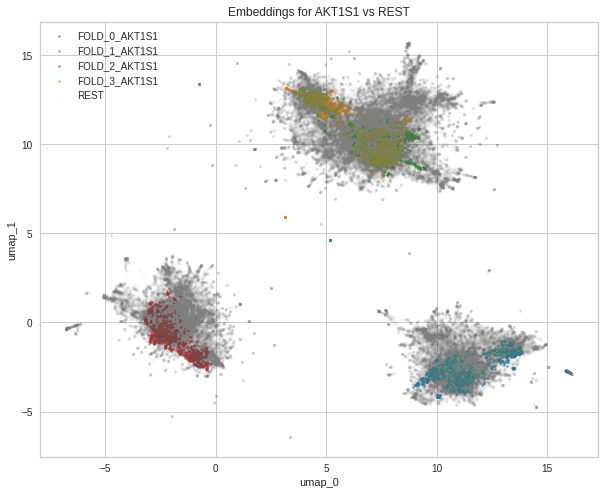

  2%|▏         | 1/42 [00:00<00:39,  1.05it/s]

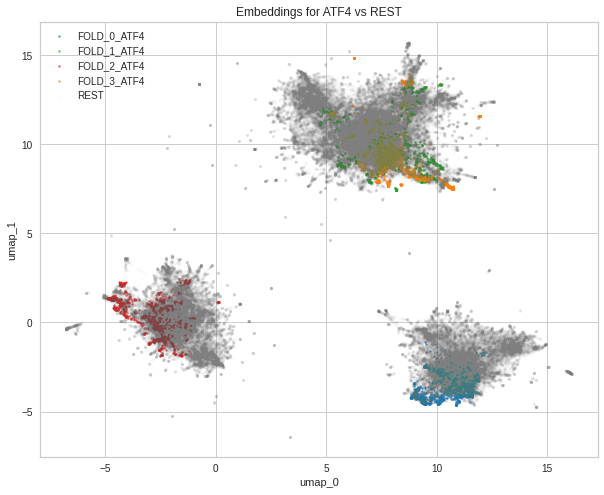

  5%|▍         | 2/42 [00:01<00:37,  1.06it/s]

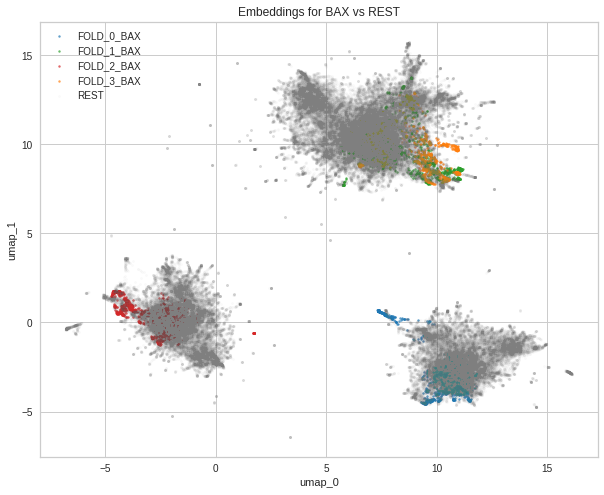

  7%|▋         | 3/42 [00:02<00:36,  1.06it/s]

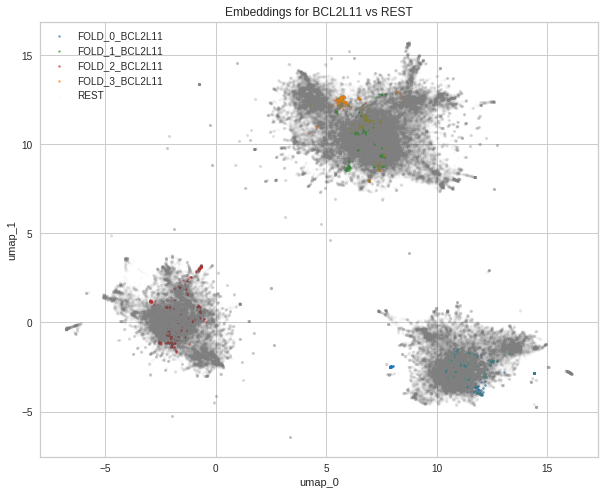

 10%|▉         | 4/42 [00:03<00:35,  1.06it/s]

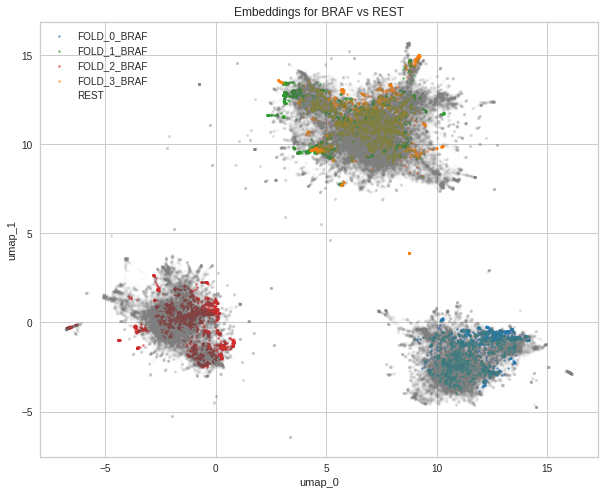

 12%|█▏        | 5/42 [00:04<00:35,  1.05it/s]

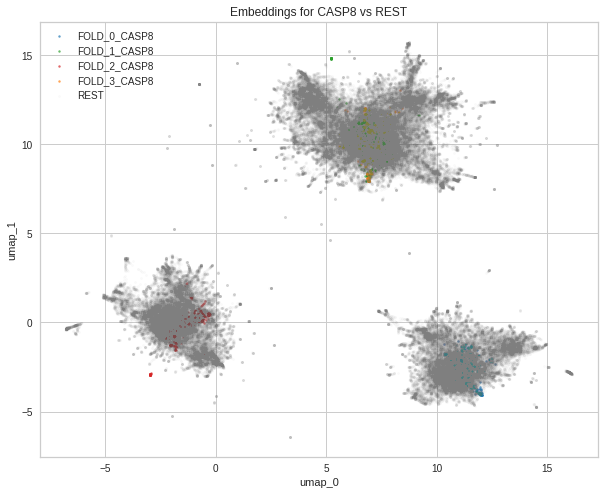

 14%|█▍        | 6/42 [00:05<00:33,  1.06it/s]

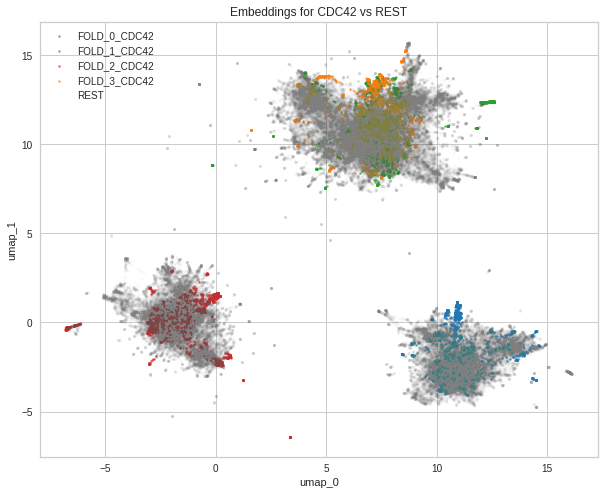

 17%|█▋        | 7/42 [00:06<00:32,  1.06it/s]

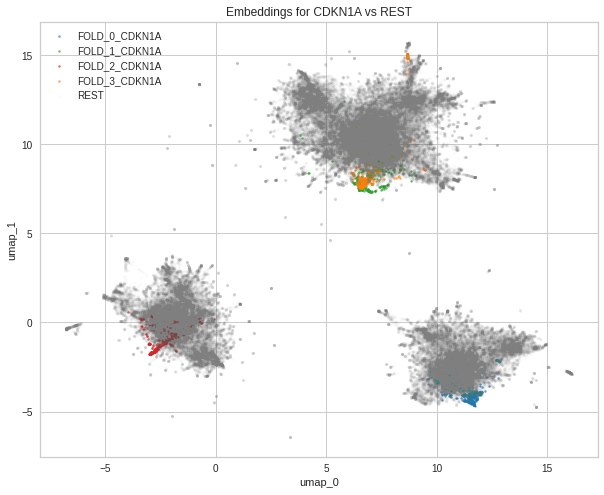

 19%|█▉        | 8/42 [00:07<00:32,  1.06it/s]

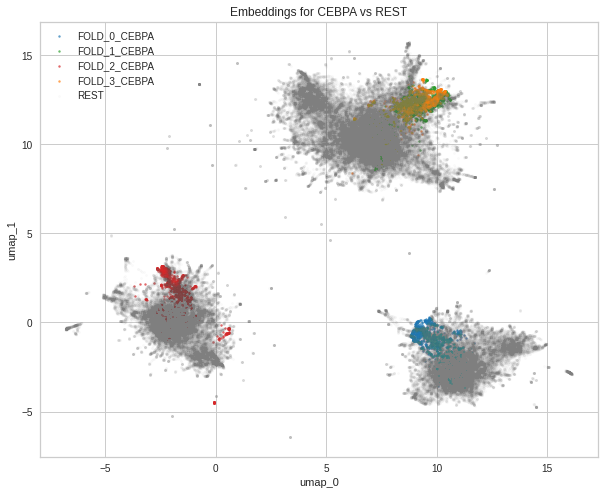

 21%|██▏       | 9/42 [00:08<00:31,  1.06it/s]

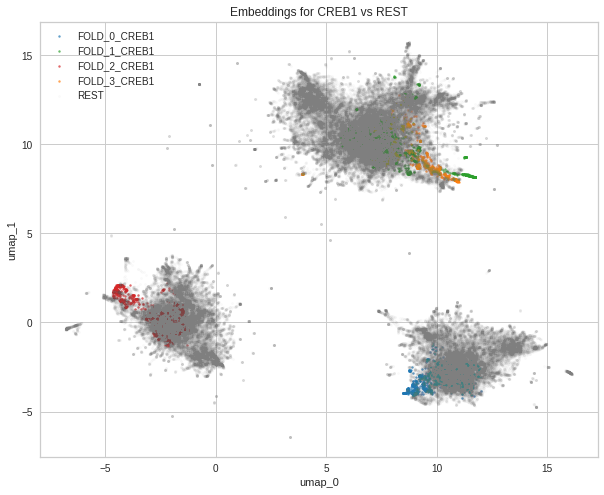

 24%|██▍       | 10/42 [00:09<00:30,  1.06it/s]

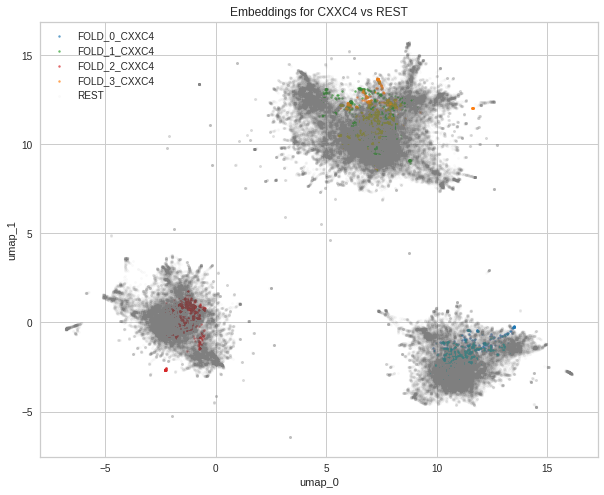

 26%|██▌       | 11/42 [00:10<00:29,  1.06it/s]

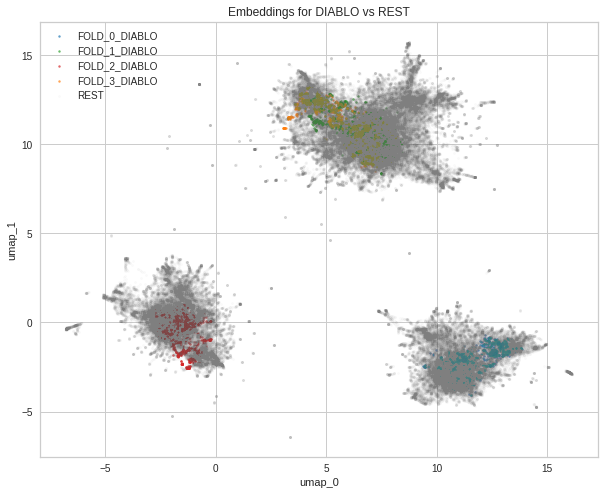

 29%|██▊       | 12/42 [00:11<00:28,  1.05it/s]

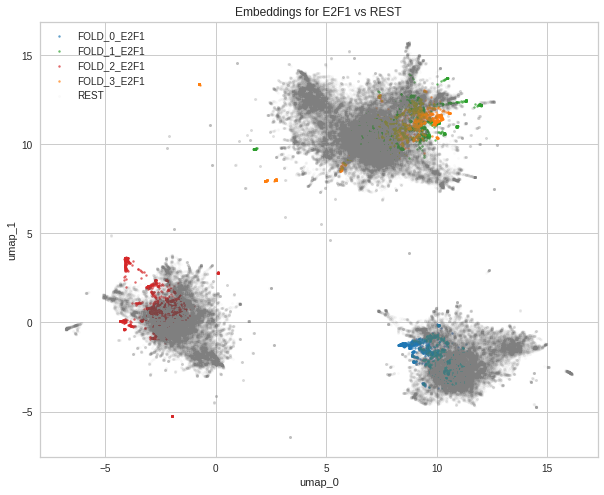

 31%|███       | 13/42 [00:12<00:27,  1.05it/s]

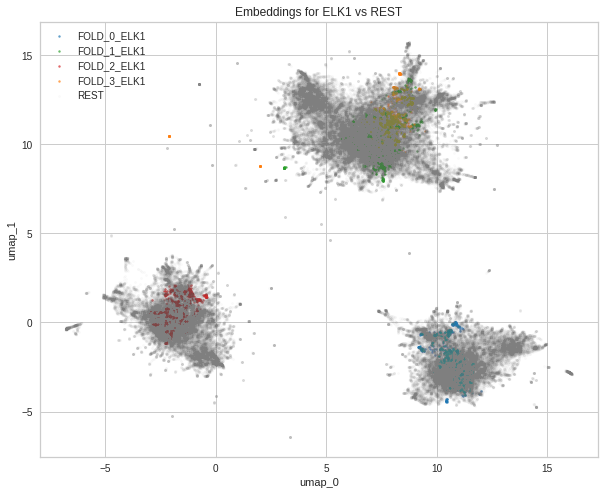

 33%|███▎      | 14/42 [00:13<00:26,  1.05it/s]

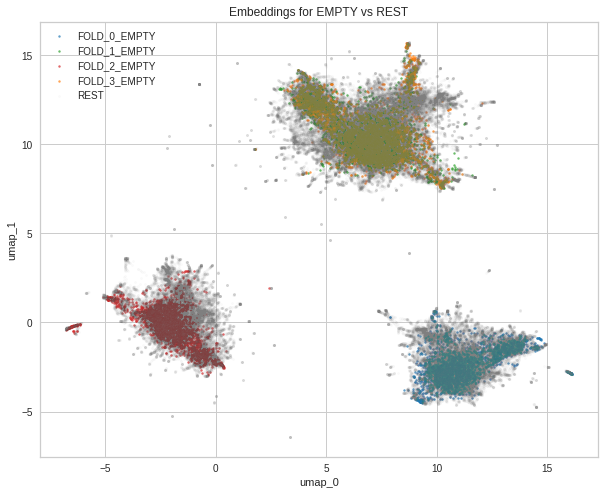

 36%|███▌      | 15/42 [00:14<00:25,  1.06it/s]

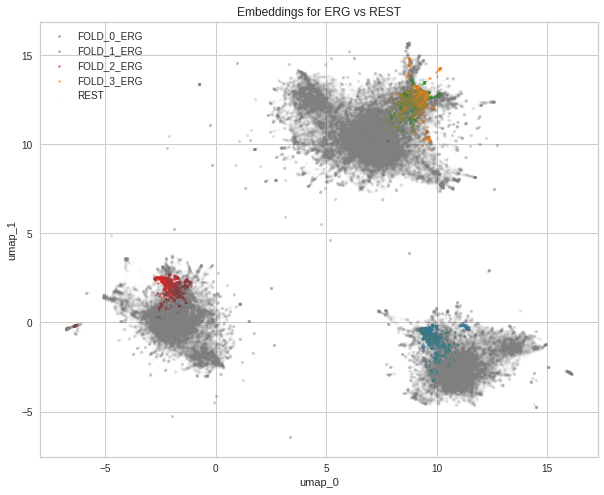

 38%|███▊      | 16/42 [00:15<00:24,  1.05it/s]

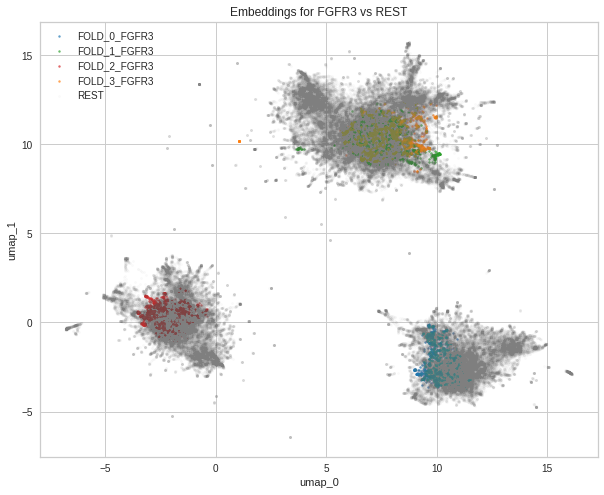

 40%|████      | 17/42 [00:16<00:23,  1.05it/s]

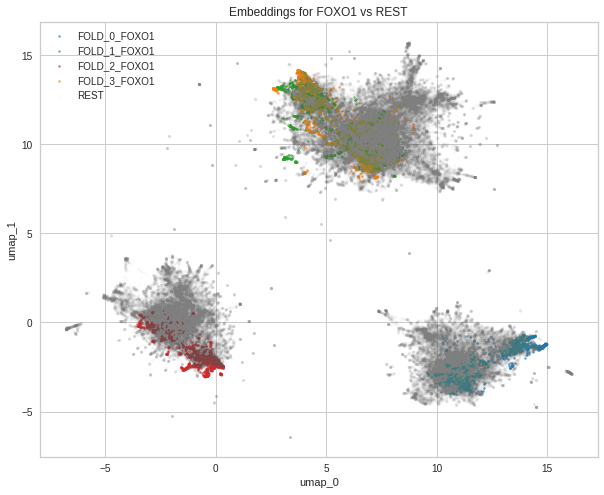

 43%|████▎     | 18/42 [00:17<00:22,  1.06it/s]

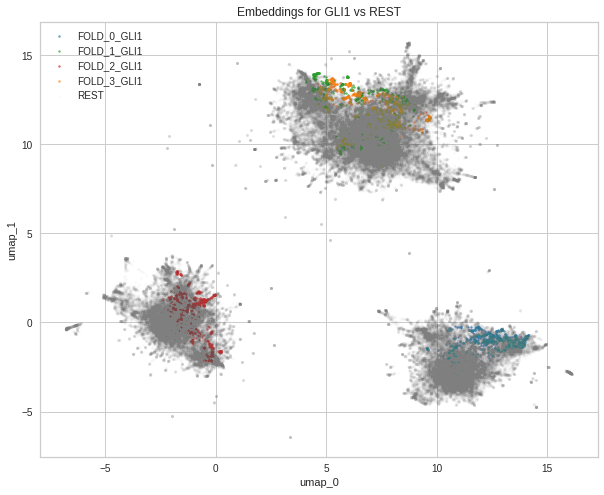

 45%|████▌     | 19/42 [00:18<00:21,  1.05it/s]

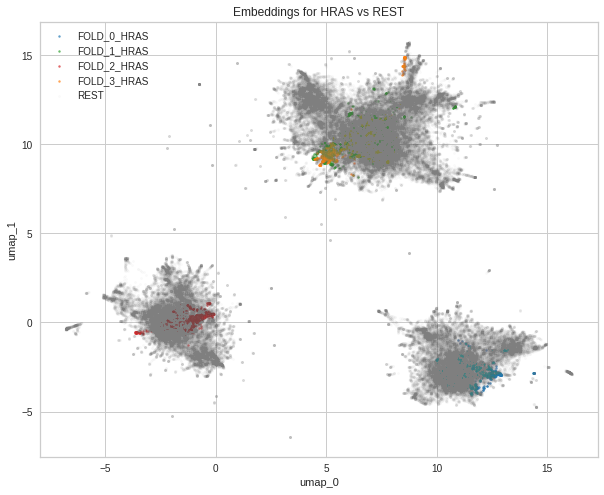

 48%|████▊     | 20/42 [00:18<00:20,  1.06it/s]

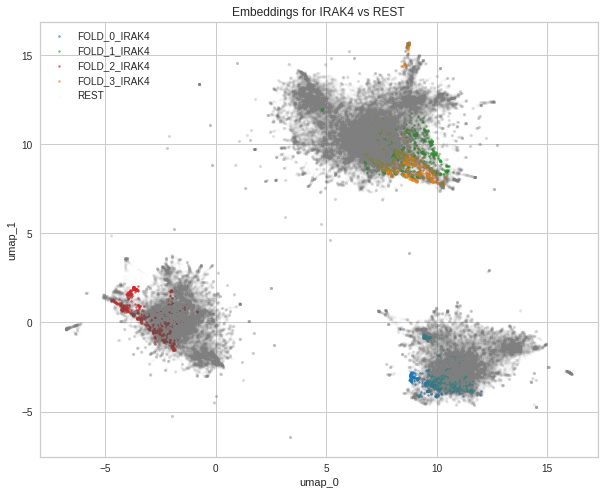

 50%|█████     | 21/42 [00:19<00:19,  1.06it/s]

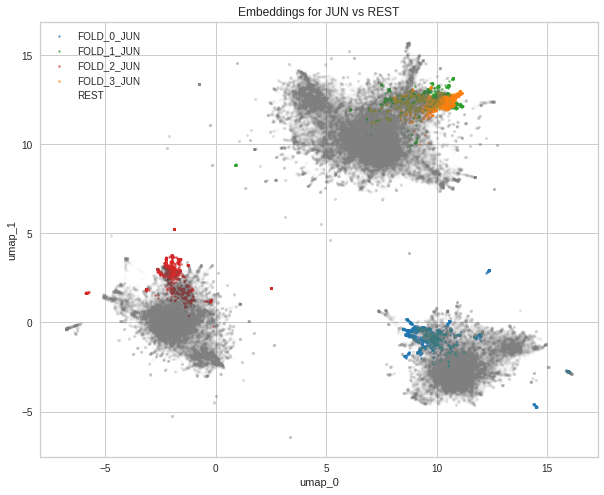

 52%|█████▏    | 22/42 [00:20<00:18,  1.06it/s]

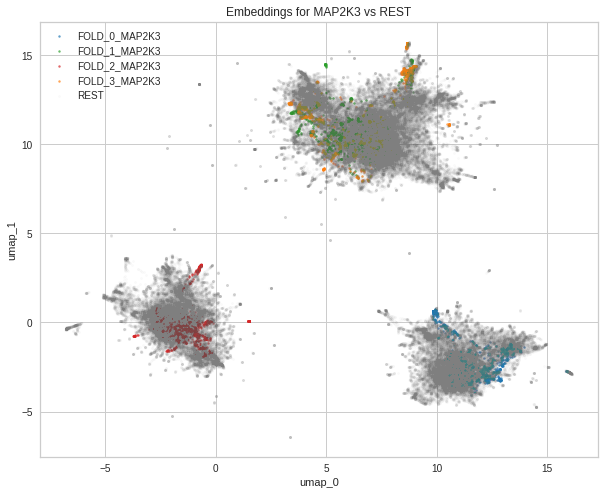

 55%|█████▍    | 23/42 [00:21<00:17,  1.06it/s]

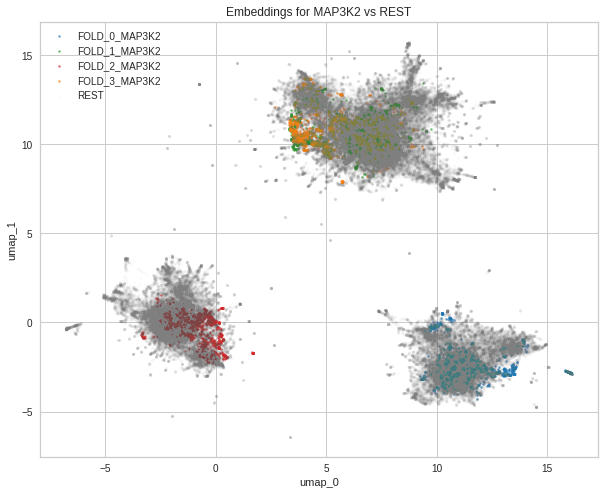

 57%|█████▋    | 24/42 [00:22<00:16,  1.06it/s]

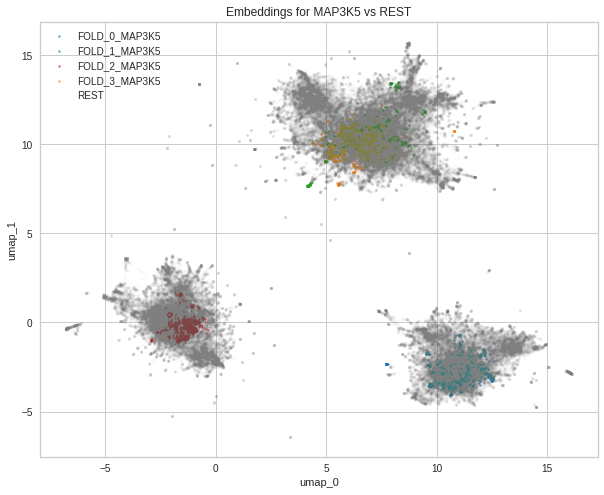

 60%|█████▉    | 25/42 [00:23<00:15,  1.07it/s]

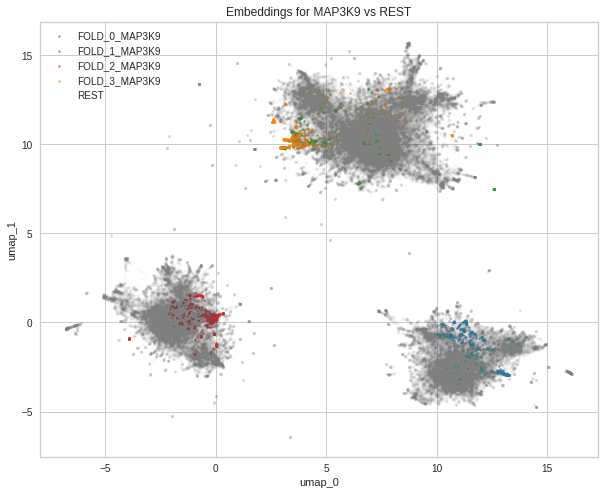

 62%|██████▏   | 26/42 [00:24<00:14,  1.07it/s]

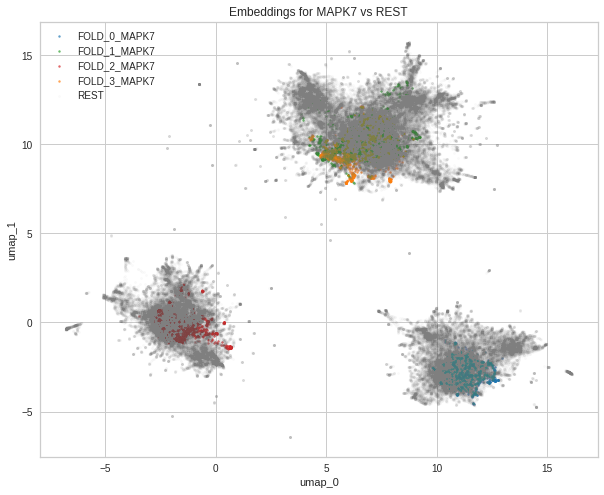

 64%|██████▍   | 27/42 [00:25<00:14,  1.06it/s]

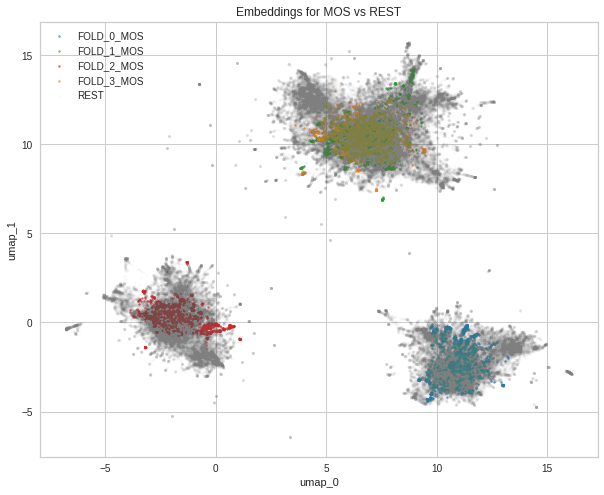

 67%|██████▋   | 28/42 [00:26<00:13,  1.06it/s]

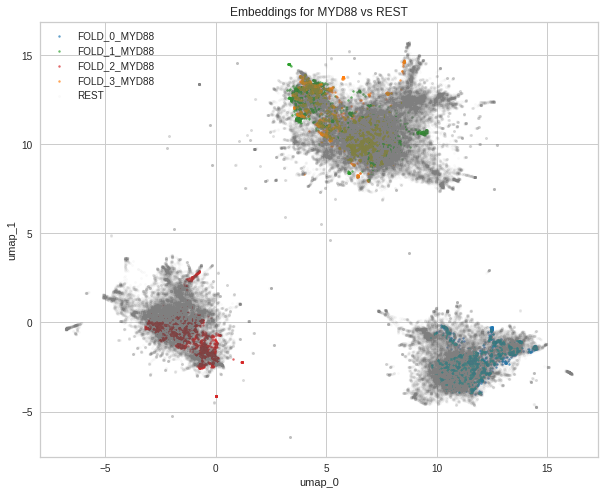

 69%|██████▉   | 29/42 [00:27<00:12,  1.07it/s]

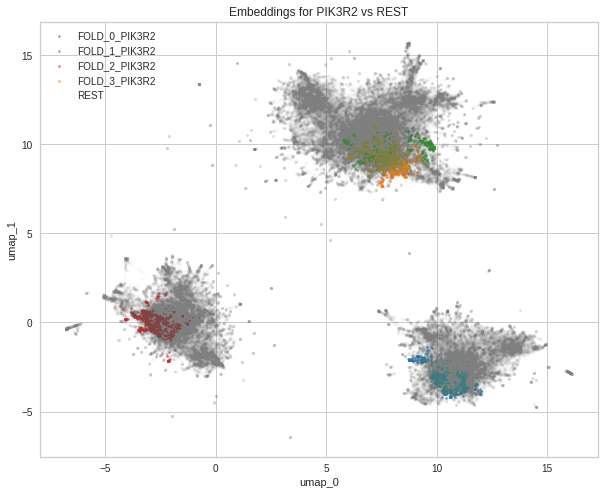

 71%|███████▏  | 30/42 [00:28<00:11,  1.00it/s]

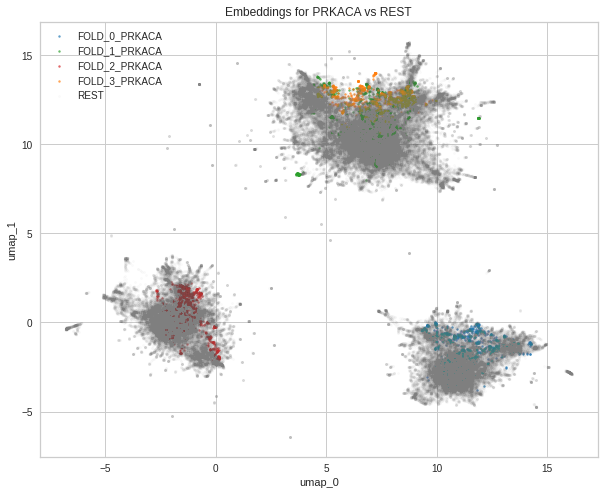

 74%|███████▍  | 31/42 [00:29<00:10,  1.02it/s]

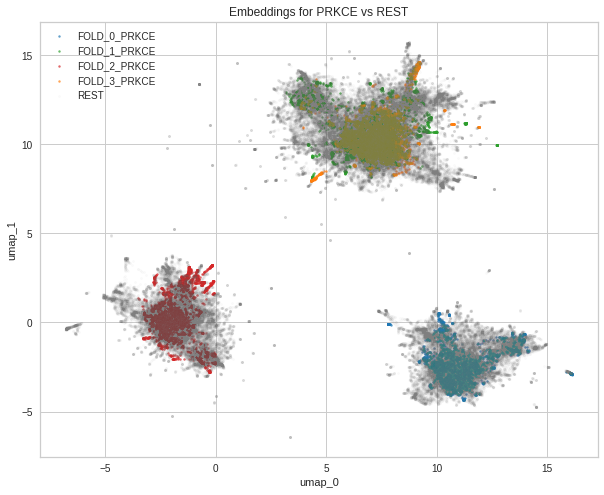

 76%|███████▌  | 32/42 [00:30<00:09,  1.03it/s]

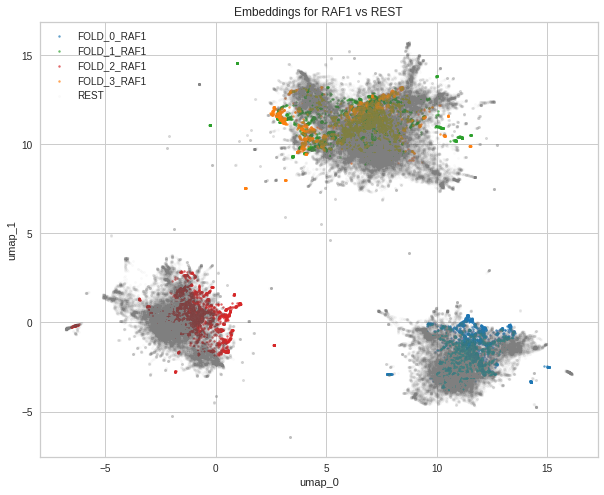

 79%|███████▊  | 33/42 [00:31<00:08,  1.04it/s]

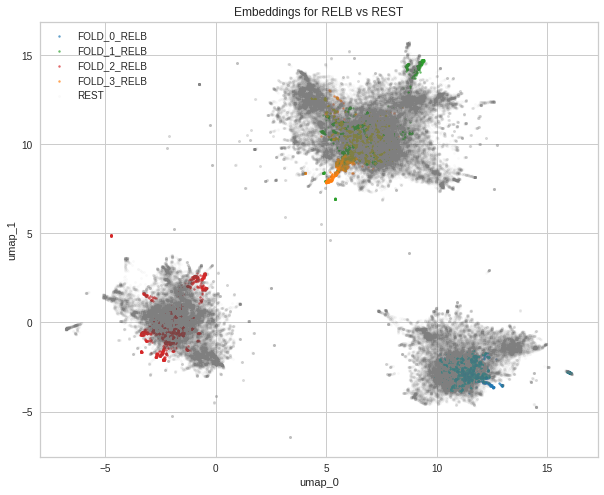

 81%|████████  | 34/42 [00:32<00:07,  1.04it/s]

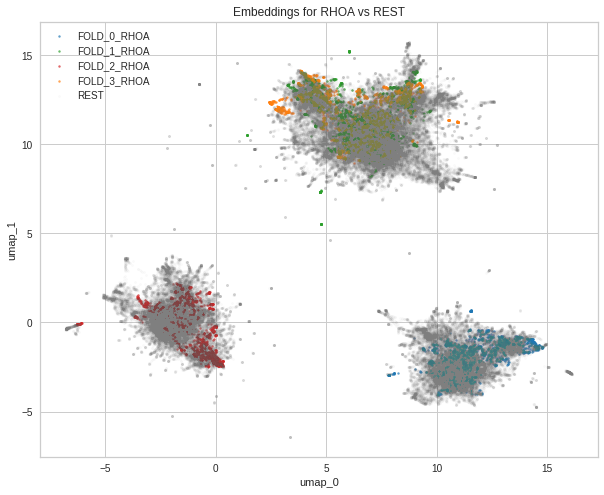

 83%|████████▎ | 35/42 [00:33<00:06,  1.04it/s]

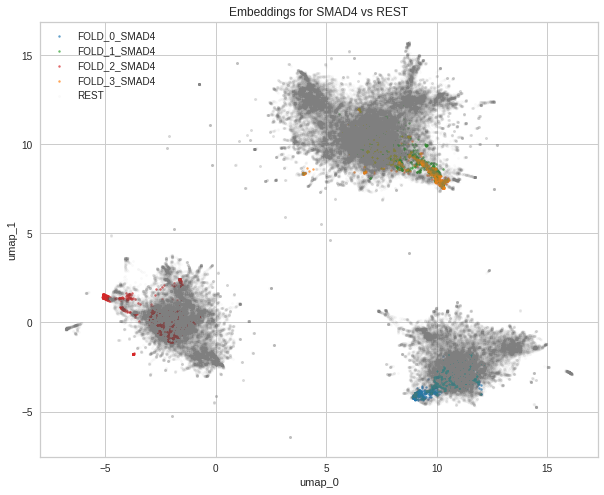

 86%|████████▌ | 36/42 [00:34<00:05,  1.05it/s]

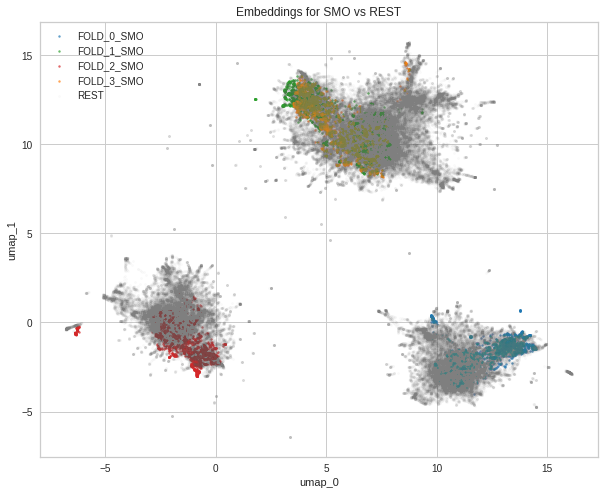

 88%|████████▊ | 37/42 [00:35<00:04,  1.06it/s]

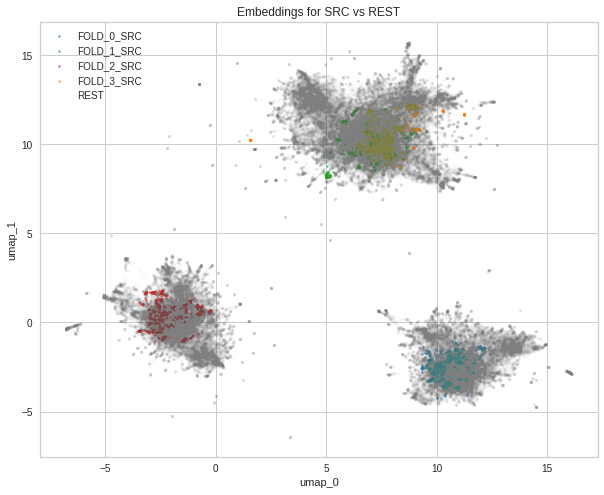

 90%|█████████ | 38/42 [00:36<00:03,  1.06it/s]

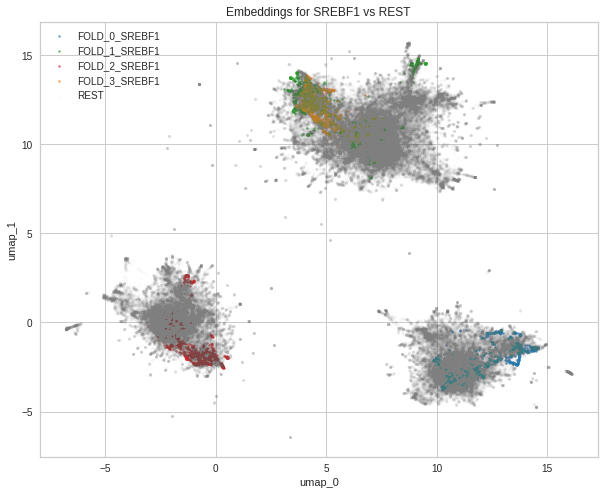

 93%|█████████▎| 39/42 [00:37<00:02,  1.06it/s]

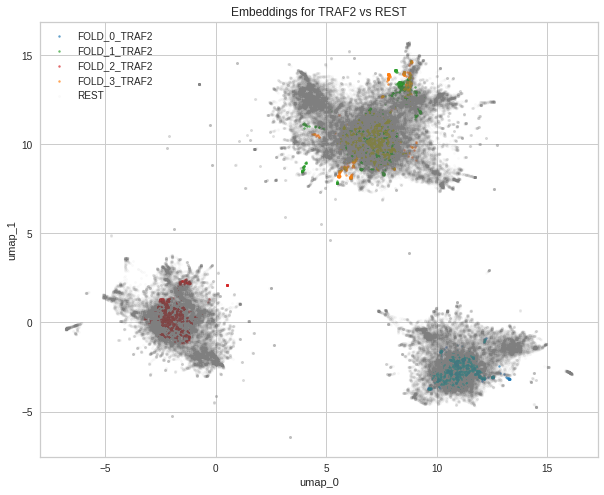

 95%|█████████▌| 40/42 [00:37<00:01,  1.06it/s]

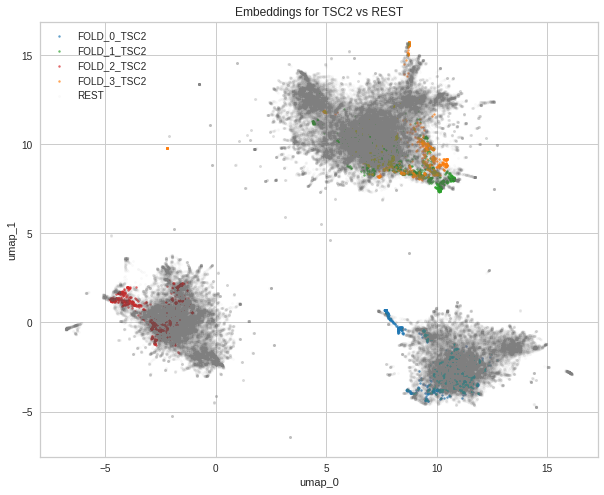

 98%|█████████▊| 41/42 [00:38<00:00,  1.06it/s]

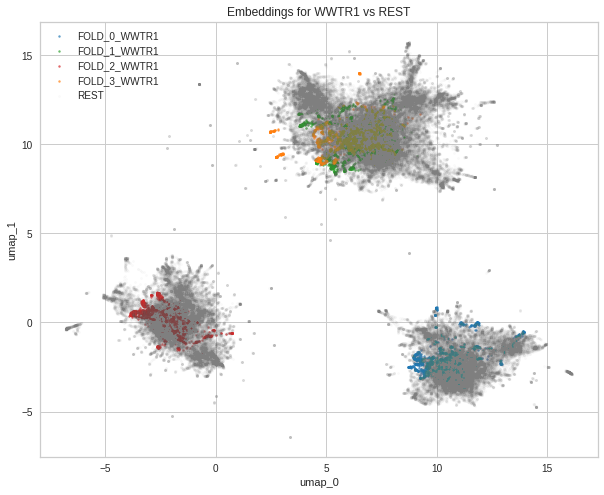

100%|██████████| 42/42 [00:39<00:00,  1.05it/s]


<IPython.core.display.Javascript object>

In [7]:
embs = plot_struct_embs_cv(latents, random_state=1234, normalize_all=True)

---

### 2.2. Overview of the individual latent spaces

#### 2.2.a. Fold-wise comparison

We will now look also individually at each fold to first visually assess if the structure in the inferred latent space between the different targets is comparable.

##### Fold 0

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/pandas/core/indexing.py:723: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
  0%|          | 0/42 [00:00<?, ?it/s]

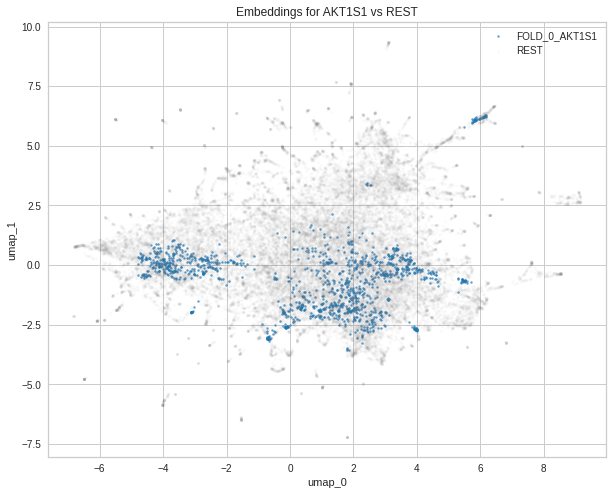

  2%|▏         | 1/42 [00:00<00:10,  3.91it/s]

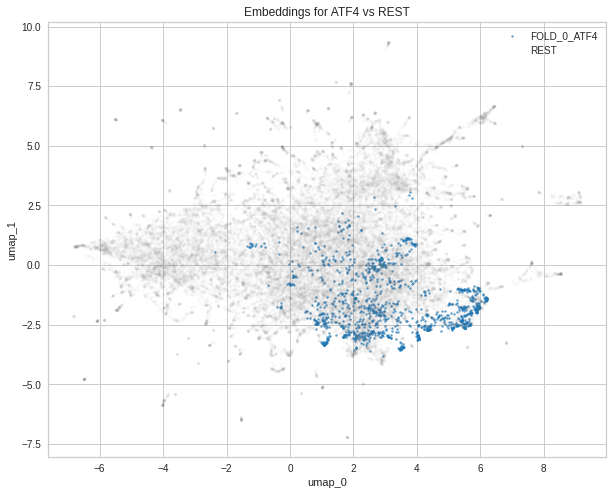

  5%|▍         | 2/42 [00:00<00:10,  3.84it/s]

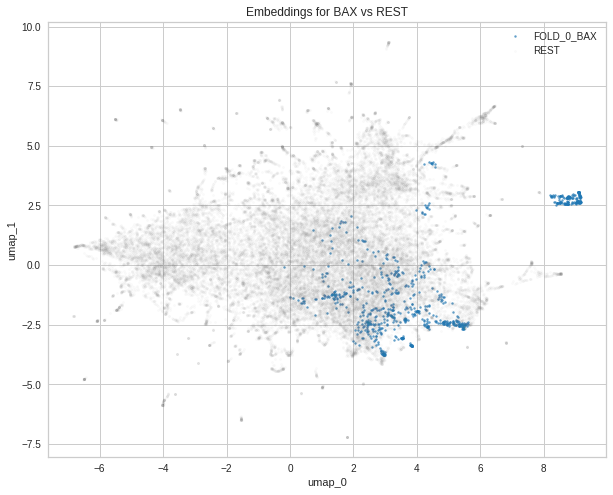

  7%|▋         | 3/42 [00:00<00:09,  3.93it/s]

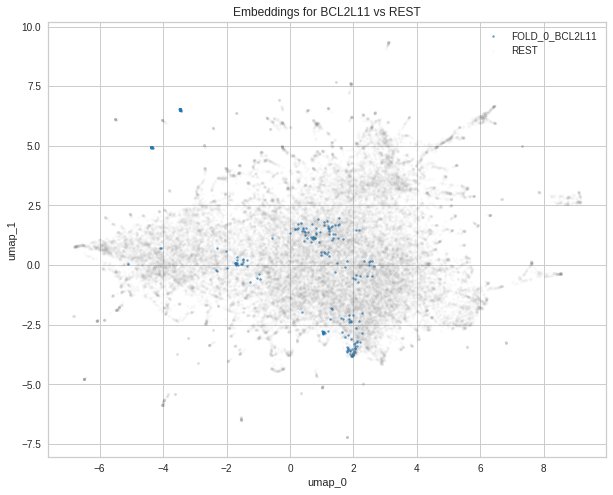

 10%|▉         | 4/42 [00:01<00:09,  3.90it/s]

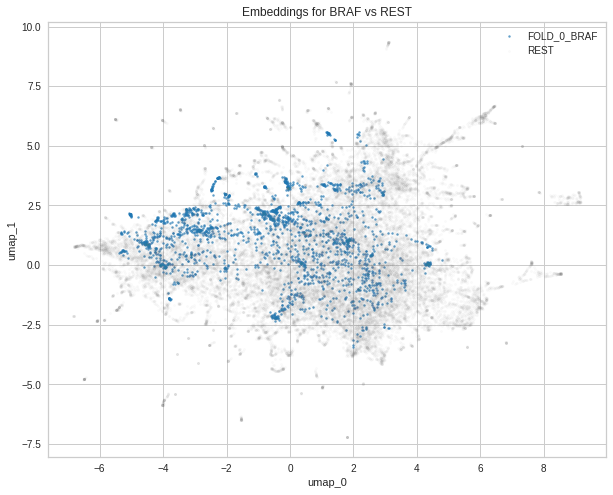

 12%|█▏        | 5/42 [00:01<00:12,  3.07it/s]

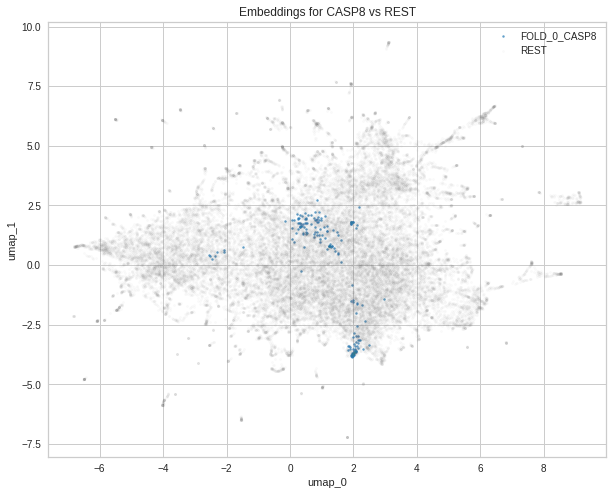

 14%|█▍        | 6/42 [00:01<00:10,  3.28it/s]

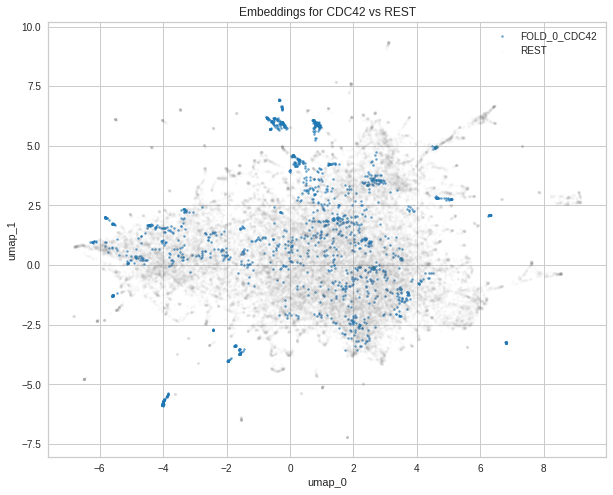

 17%|█▋        | 7/42 [00:02<00:10,  3.37it/s]

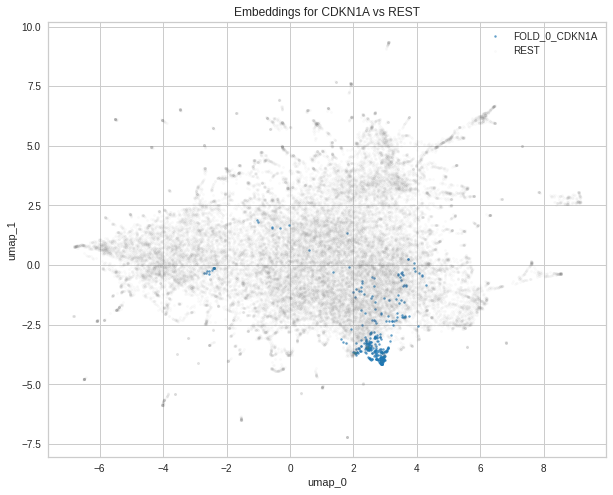

 19%|█▉        | 8/42 [00:02<00:09,  3.44it/s]

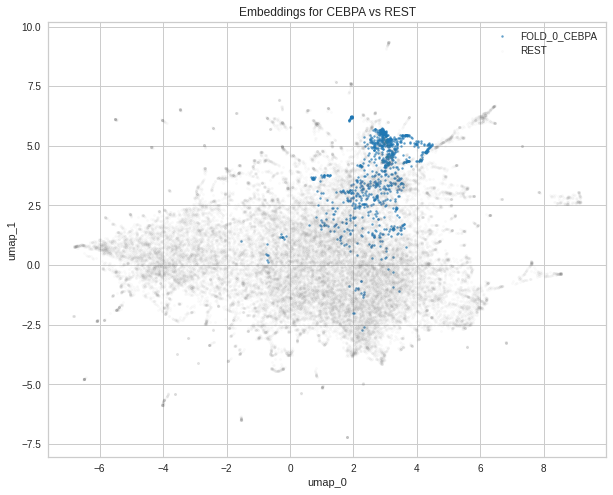

 21%|██▏       | 9/42 [00:02<00:09,  3.44it/s]

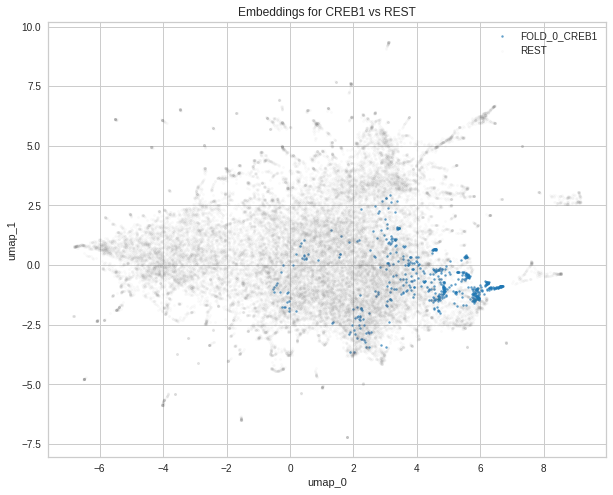

 24%|██▍       | 10/42 [00:02<00:09,  3.50it/s]

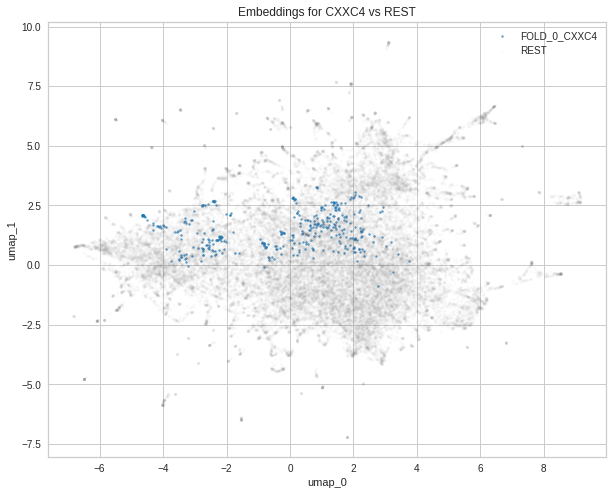

 26%|██▌       | 11/42 [00:03<00:08,  3.61it/s]

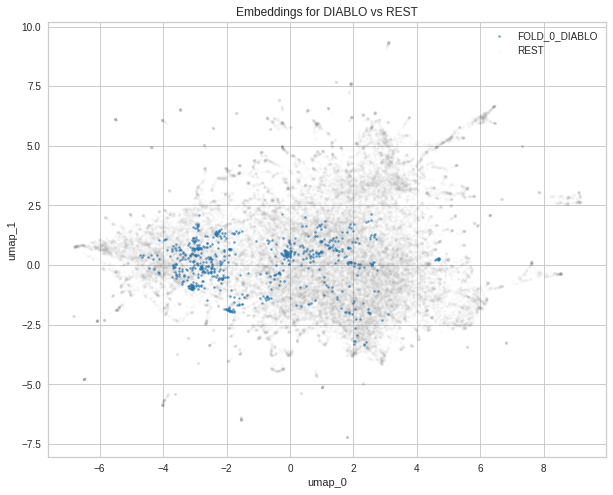

 29%|██▊       | 12/42 [00:03<00:08,  3.67it/s]

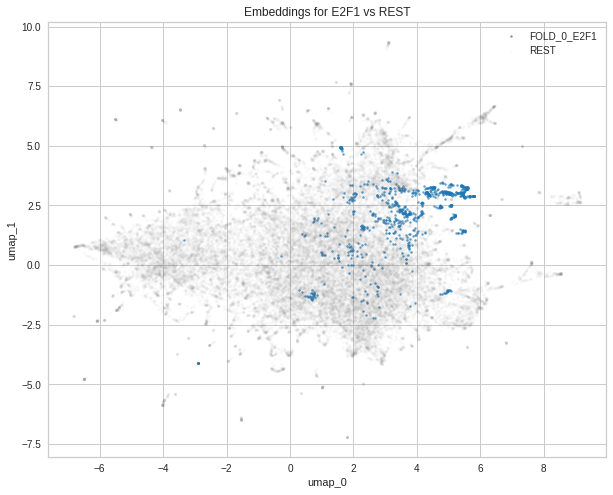

 31%|███       | 13/42 [00:03<00:07,  3.73it/s]

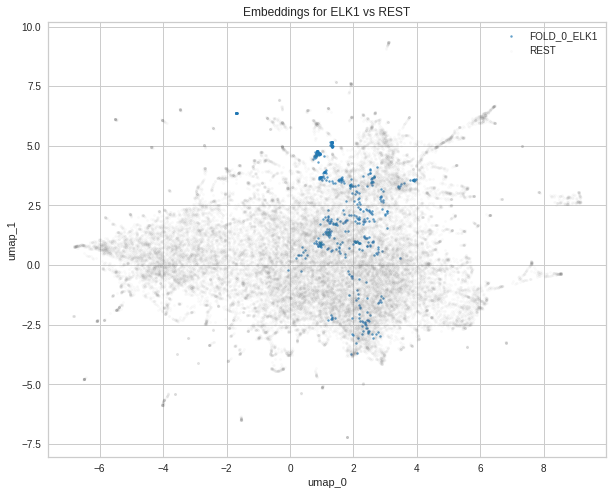

 33%|███▎      | 14/42 [00:03<00:07,  3.77it/s]

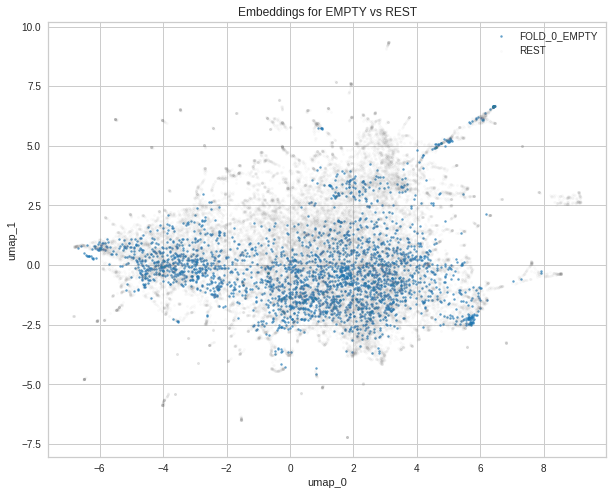

 36%|███▌      | 15/42 [00:04<00:07,  3.78it/s]

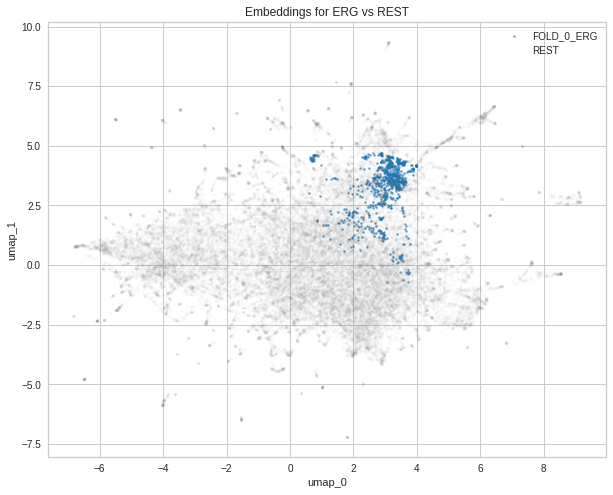

 38%|███▊      | 16/42 [00:04<00:06,  3.83it/s]

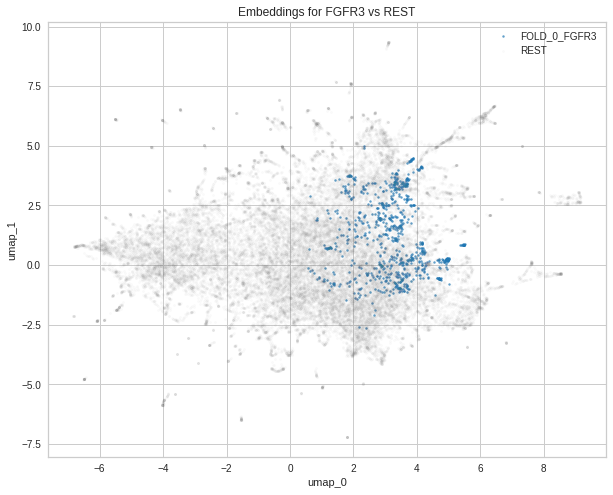

 40%|████      | 17/42 [00:04<00:06,  3.68it/s]

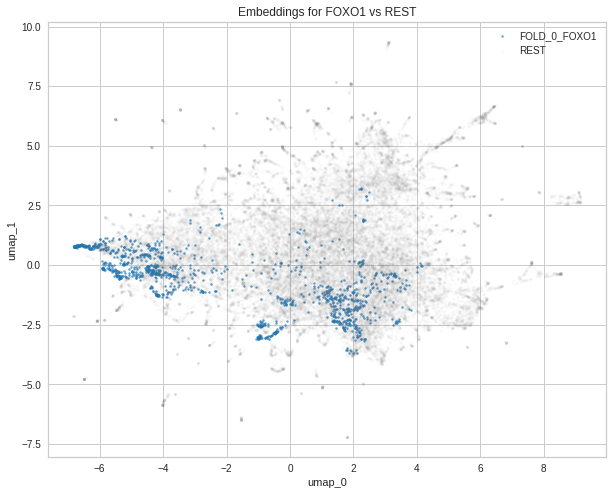

 43%|████▎     | 18/42 [00:04<00:06,  3.69it/s]

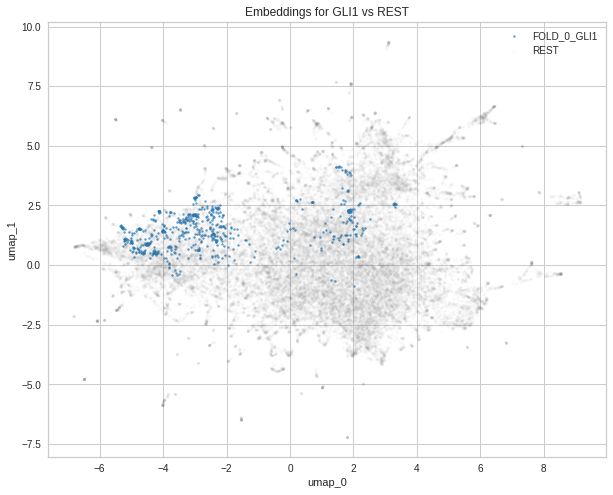

 45%|████▌     | 19/42 [00:05<00:06,  3.77it/s]

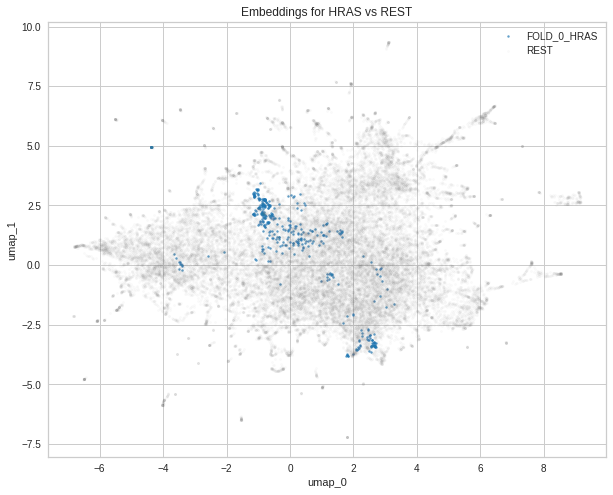

 48%|████▊     | 20/42 [00:05<00:05,  3.82it/s]

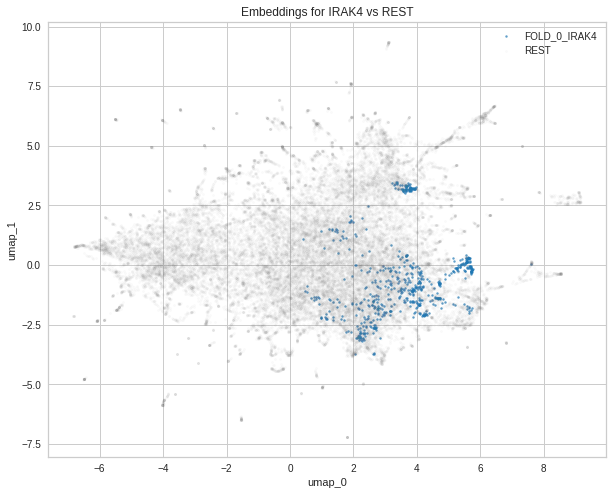

 50%|█████     | 21/42 [00:05<00:05,  3.84it/s]

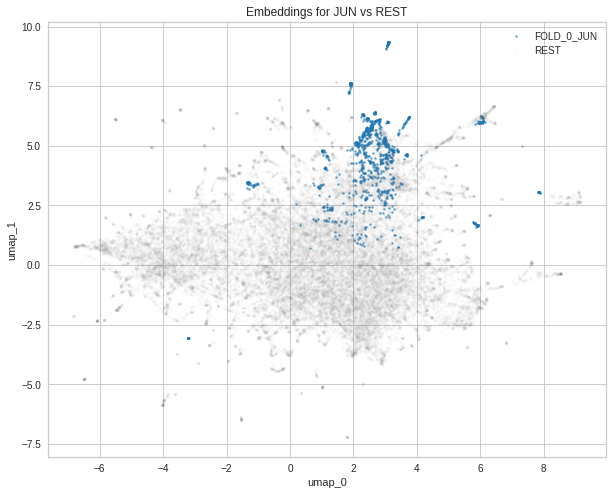

 52%|█████▏    | 22/42 [00:06<00:05,  3.74it/s]

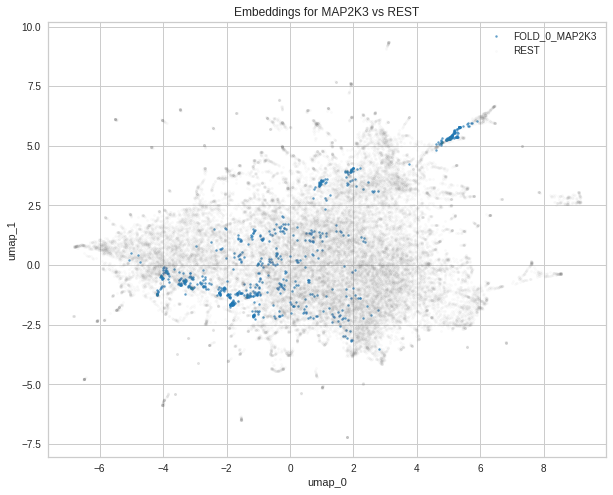

 55%|█████▍    | 23/42 [00:06<00:04,  3.81it/s]

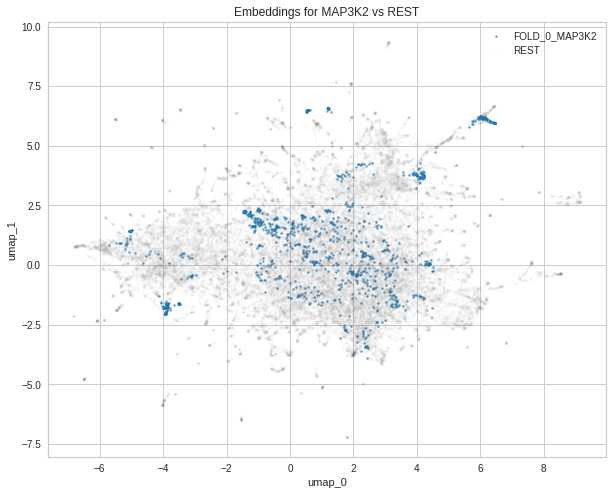

 57%|█████▋    | 24/42 [00:06<00:04,  3.87it/s]

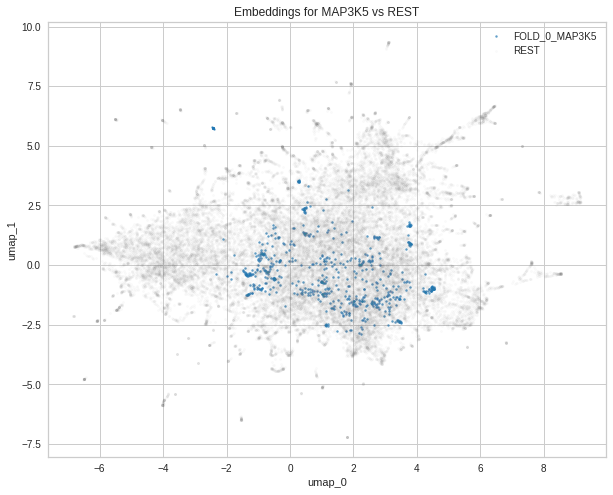

 60%|█████▉    | 25/42 [00:06<00:04,  3.90it/s]

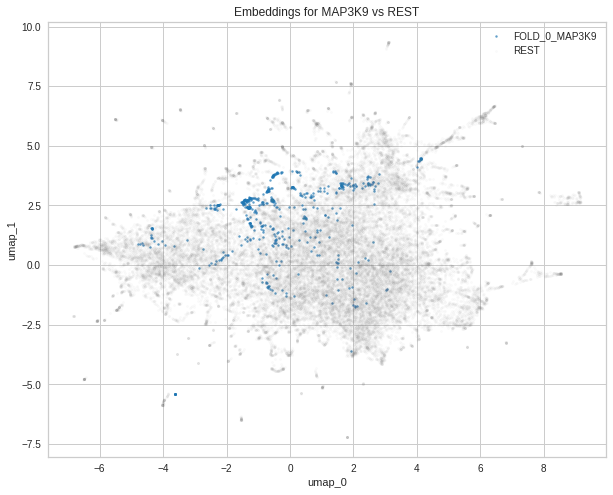

 62%|██████▏   | 26/42 [00:07<00:04,  3.89it/s]

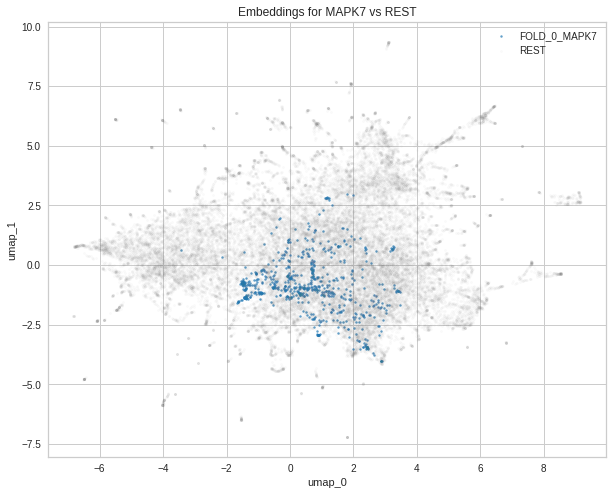

 64%|██████▍   | 27/42 [00:07<00:03,  3.93it/s]

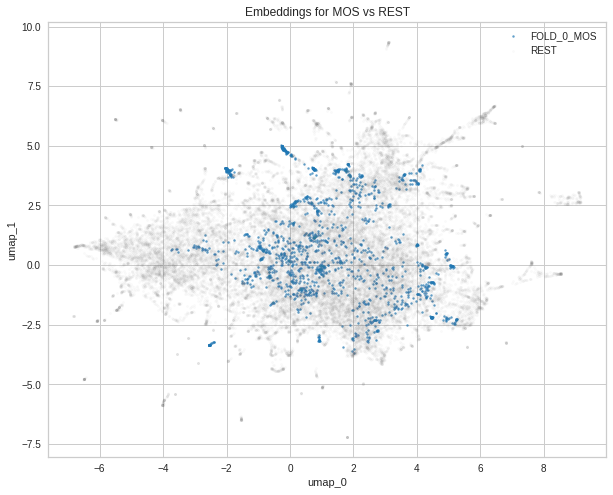

 67%|██████▋   | 28/42 [00:07<00:03,  3.93it/s]

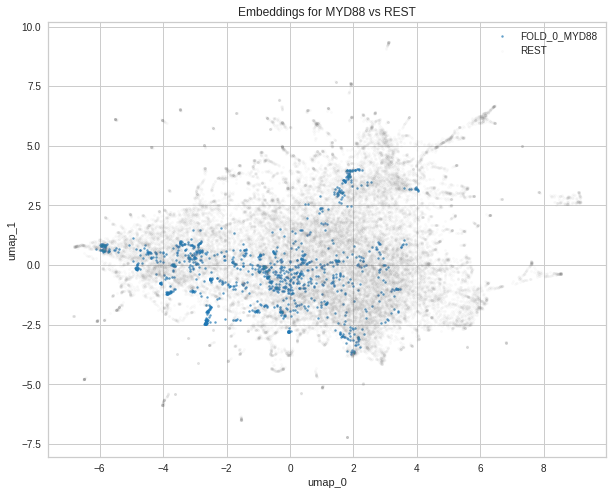

 69%|██████▉   | 29/42 [00:07<00:03,  3.95it/s]

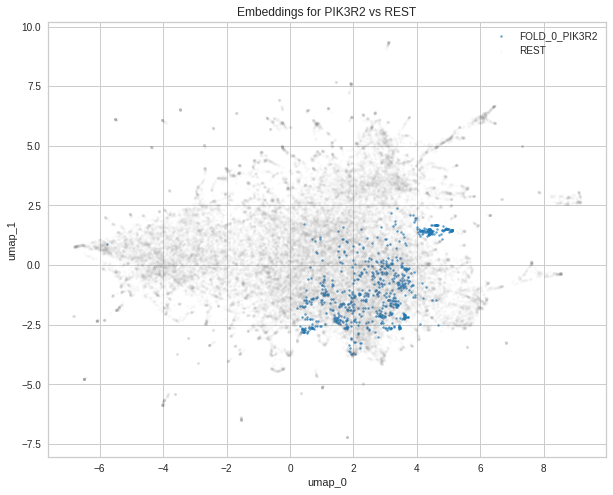

 71%|███████▏  | 30/42 [00:08<00:03,  3.96it/s]

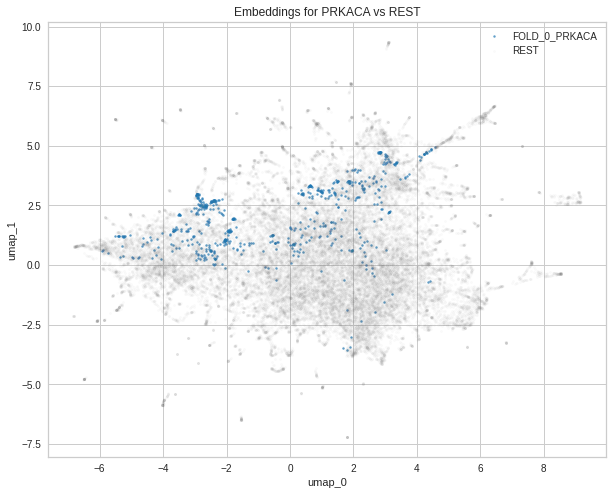

 74%|███████▍  | 31/42 [00:08<00:02,  3.97it/s]

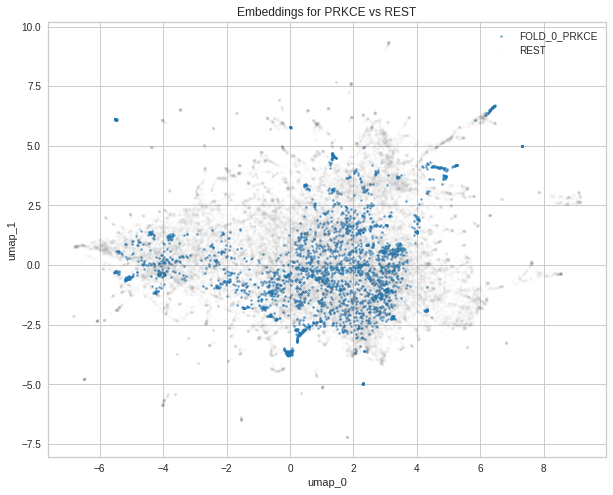

 76%|███████▌  | 32/42 [00:08<00:02,  3.99it/s]

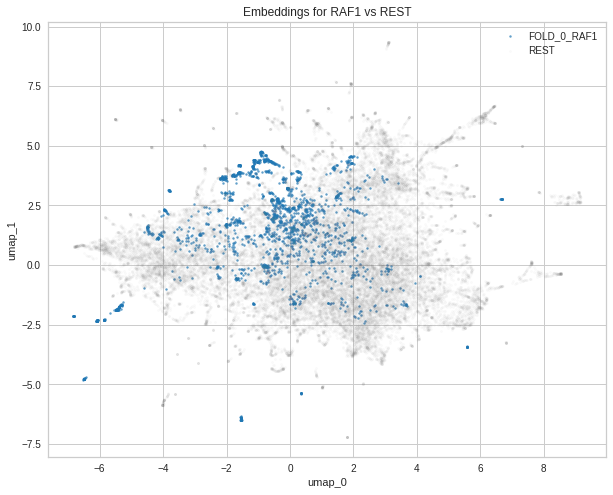

 79%|███████▊  | 33/42 [00:08<00:02,  3.29it/s]

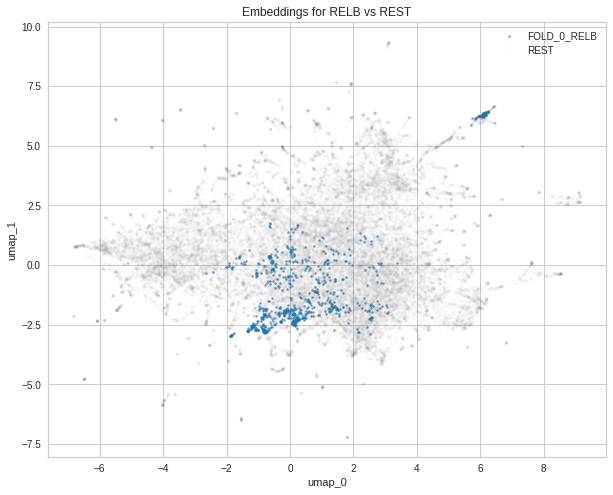

 81%|████████  | 34/42 [00:09<00:02,  3.45it/s]

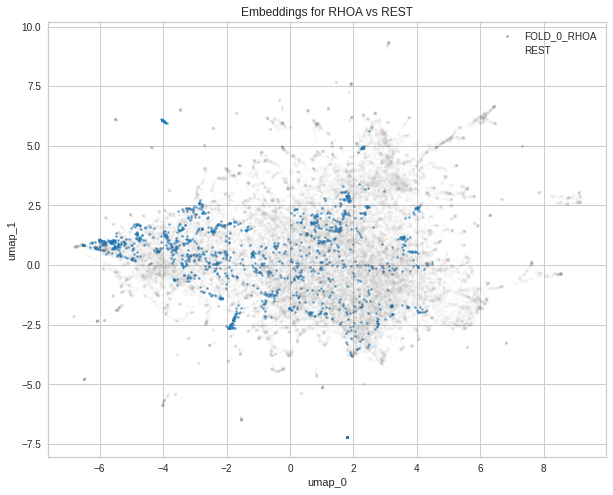

 83%|████████▎ | 35/42 [00:09<00:01,  3.57it/s]

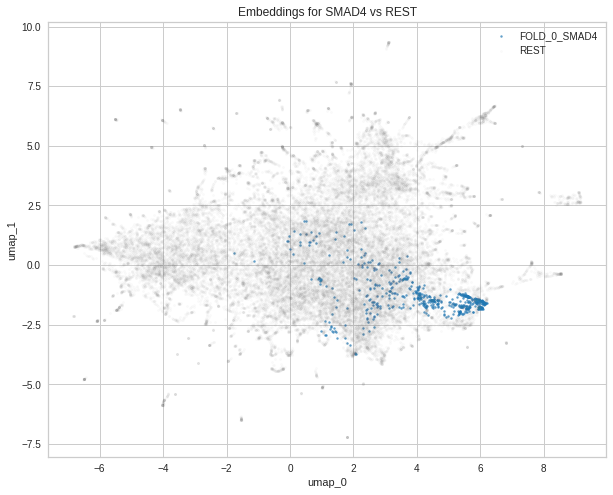

 86%|████████▌ | 36/42 [00:09<00:01,  3.67it/s]

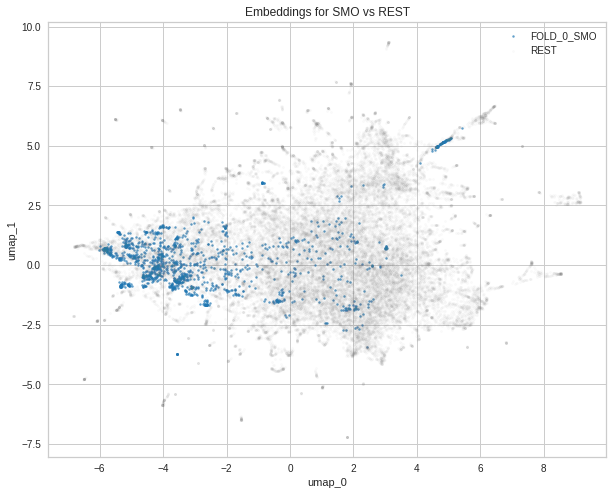

 88%|████████▊ | 37/42 [00:09<00:01,  3.72it/s]

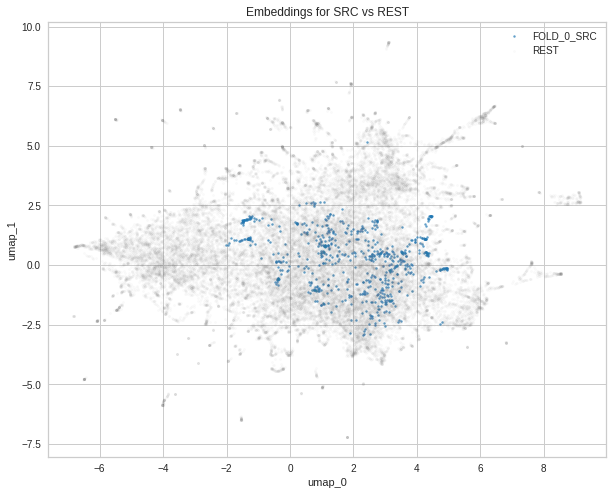

 90%|█████████ | 38/42 [00:10<00:01,  3.58it/s]

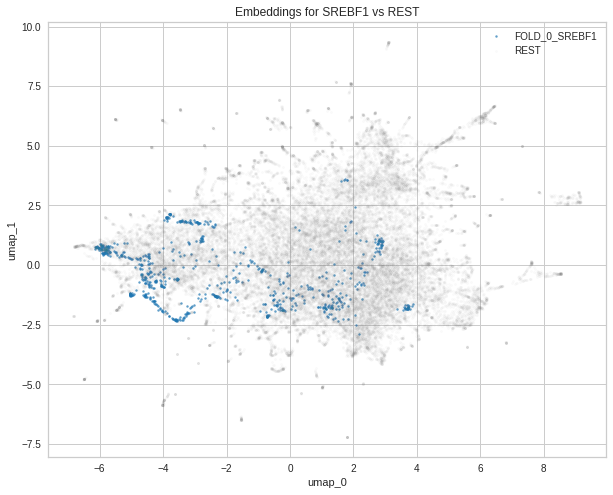

 93%|█████████▎| 39/42 [00:10<00:00,  3.64it/s]

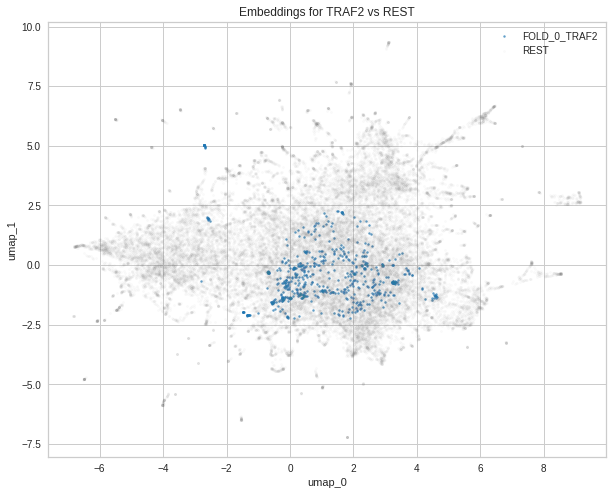

 95%|█████████▌| 40/42 [00:10<00:00,  3.69it/s]

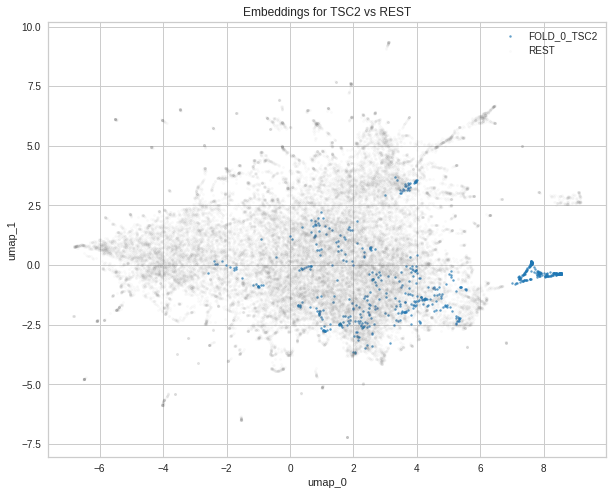

 98%|█████████▊| 41/42 [00:11<00:00,  3.66it/s]

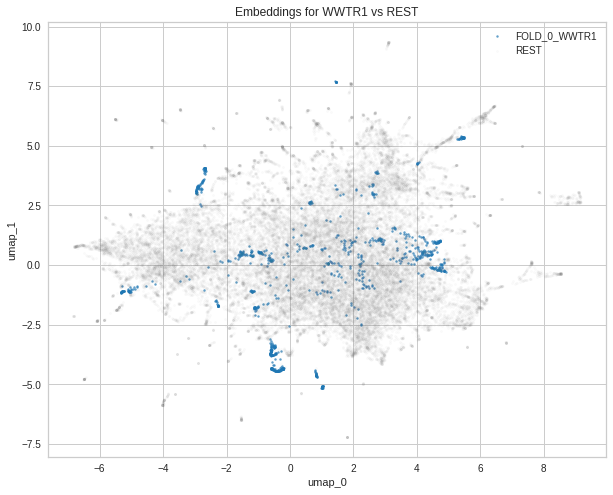

100%|██████████| 42/42 [00:11<00:00,  3.70it/s]


<IPython.core.display.Javascript object>

In [8]:
embs_0 = plot_struct_embs_cv(latents, random_state=1234, folds=["fold_0"])

##### Fold 1

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/pandas/core/indexing.py:723: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
  0%|          | 0/42 [00:00<?, ?it/s]

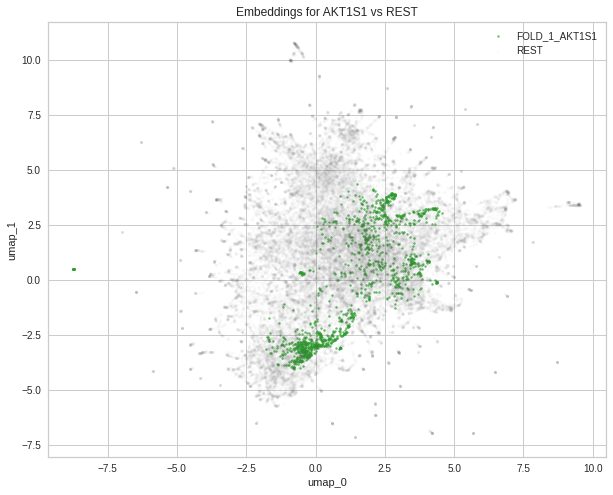

  2%|▏         | 1/42 [00:00<00:10,  4.01it/s]

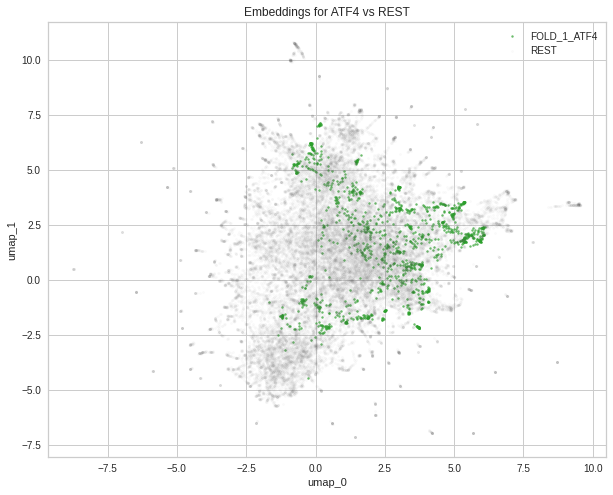

  5%|▍         | 2/42 [00:00<00:09,  4.02it/s]

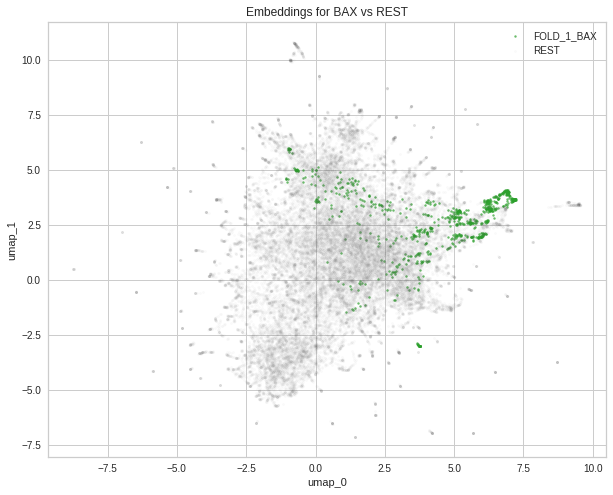

  7%|▋         | 3/42 [00:00<00:09,  3.96it/s]

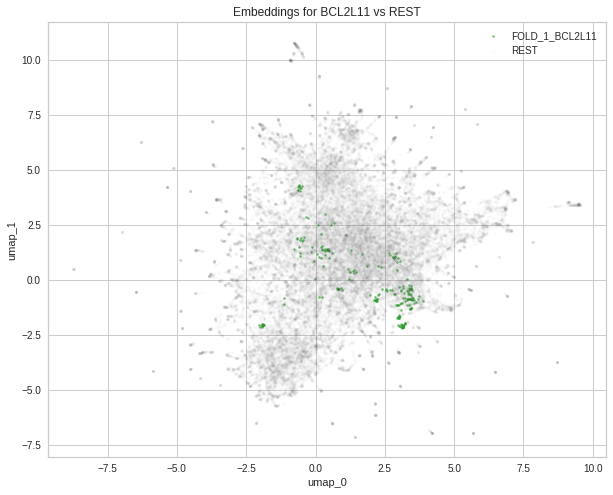

 10%|▉         | 4/42 [00:01<00:09,  3.97it/s]

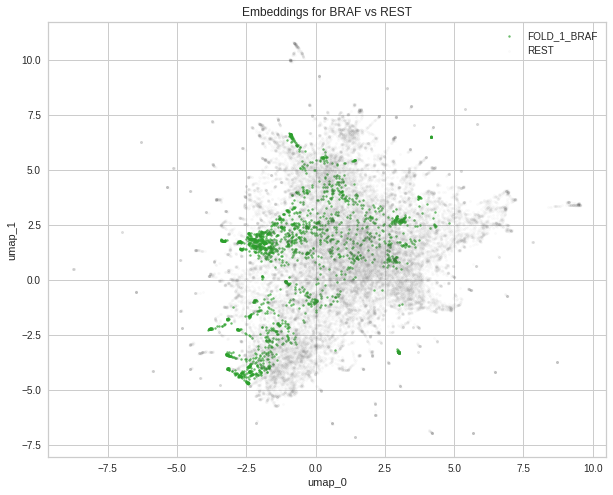

 12%|█▏        | 5/42 [00:01<00:09,  3.97it/s]

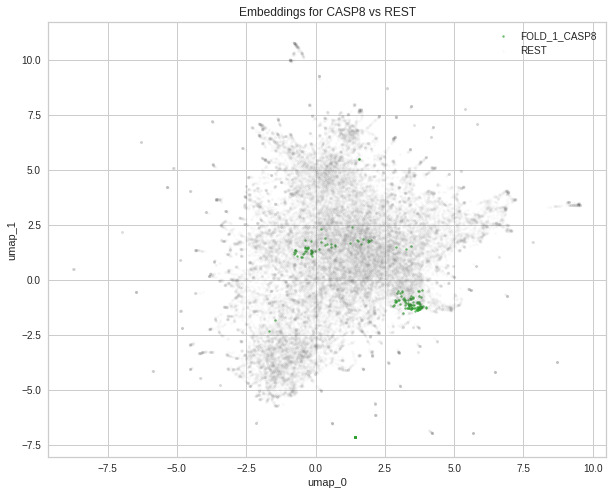

 14%|█▍        | 6/42 [00:01<00:09,  3.82it/s]

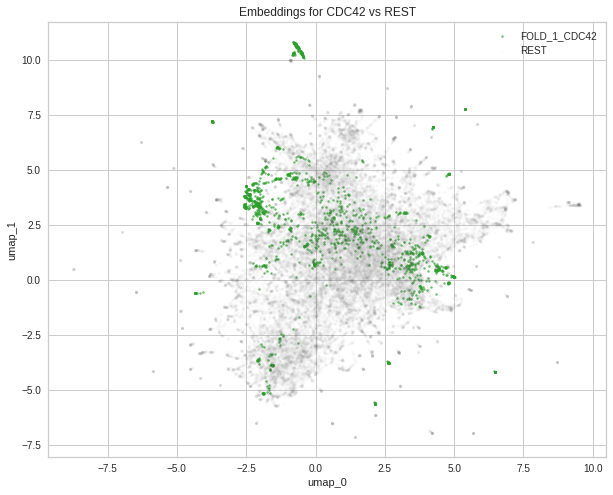

 17%|█▋        | 7/42 [00:01<00:08,  3.90it/s]

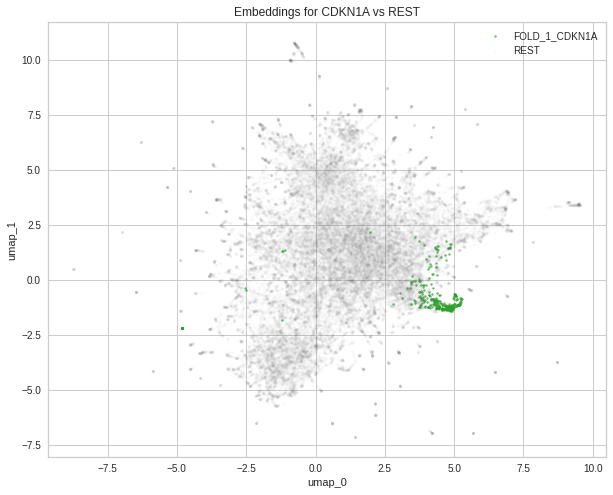

 19%|█▉        | 8/42 [00:02<00:10,  3.23it/s]

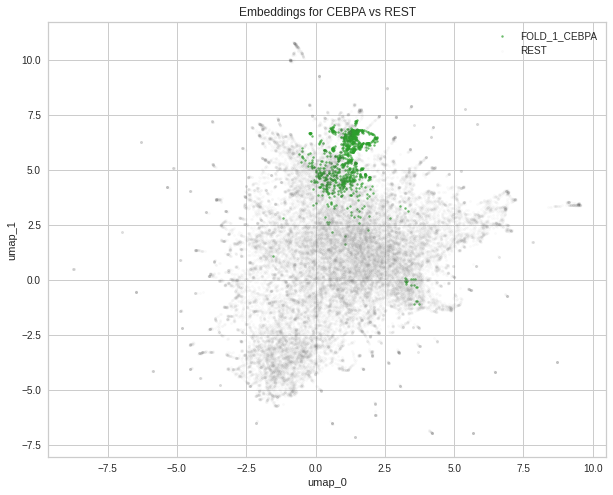

 21%|██▏       | 9/42 [00:02<00:09,  3.33it/s]

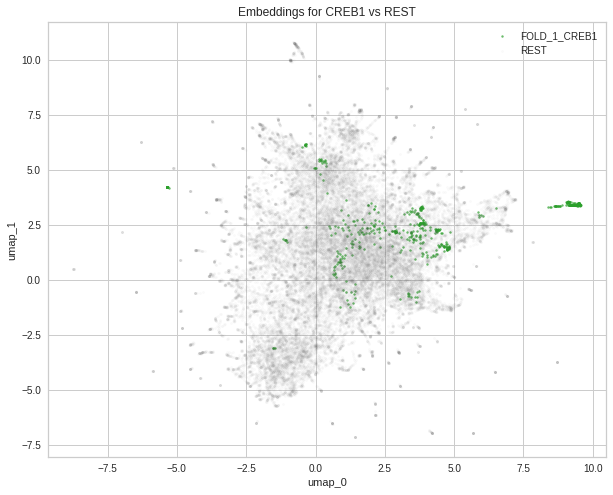

 24%|██▍       | 10/42 [00:02<00:09,  3.37it/s]

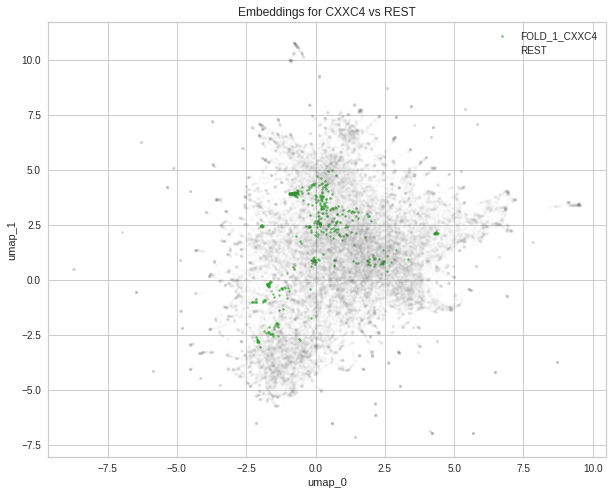

 26%|██▌       | 11/42 [00:03<00:08,  3.52it/s]

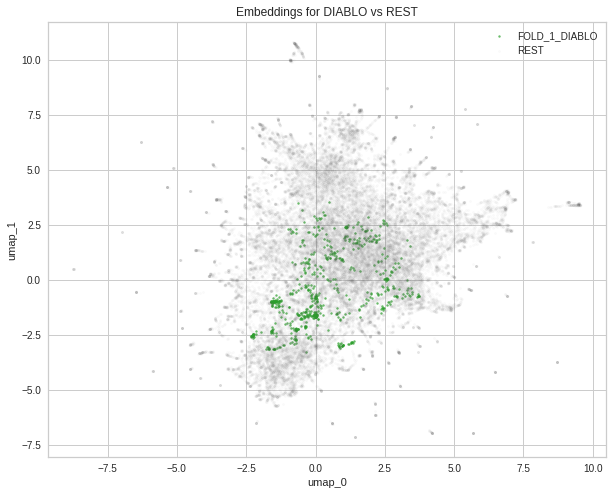

 29%|██▊       | 12/42 [00:03<00:08,  3.63it/s]

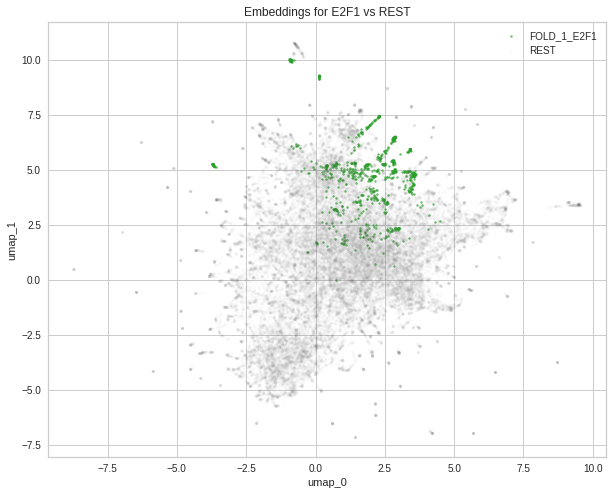

 31%|███       | 13/42 [00:03<00:07,  3.72it/s]

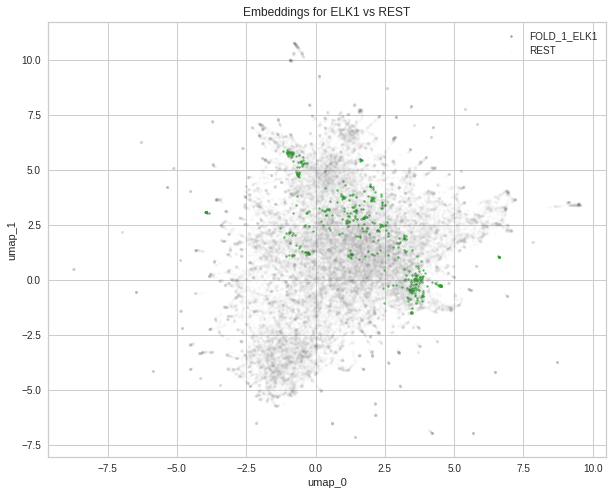

 33%|███▎      | 14/42 [00:03<00:07,  3.79it/s]

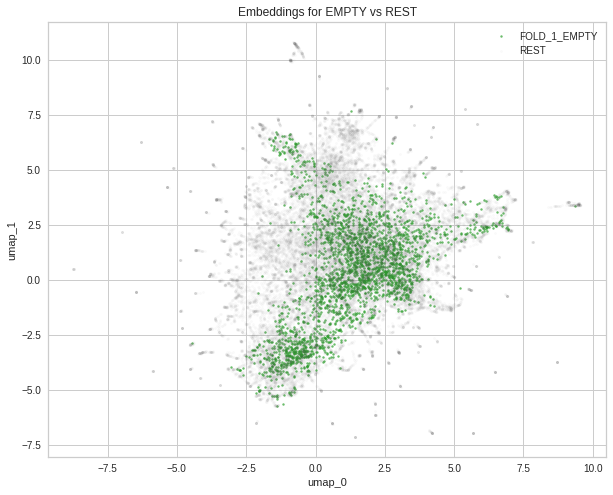

 36%|███▌      | 15/42 [00:04<00:07,  3.80it/s]

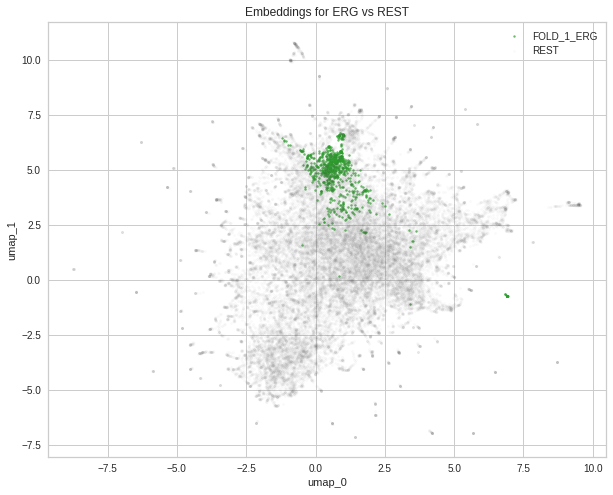

 38%|███▊      | 16/42 [00:04<00:06,  3.85it/s]

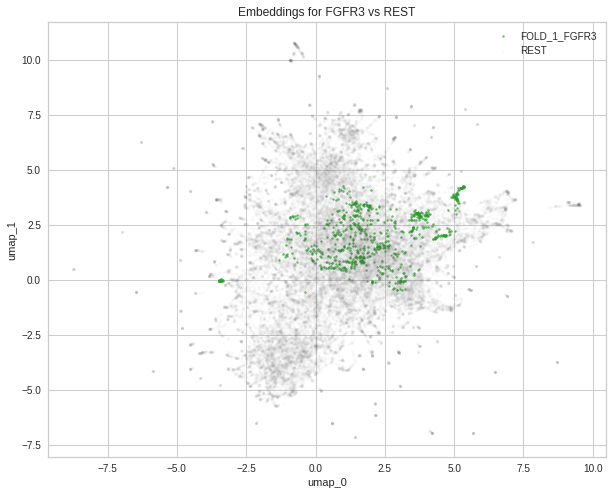

 40%|████      | 17/42 [00:04<00:06,  3.89it/s]

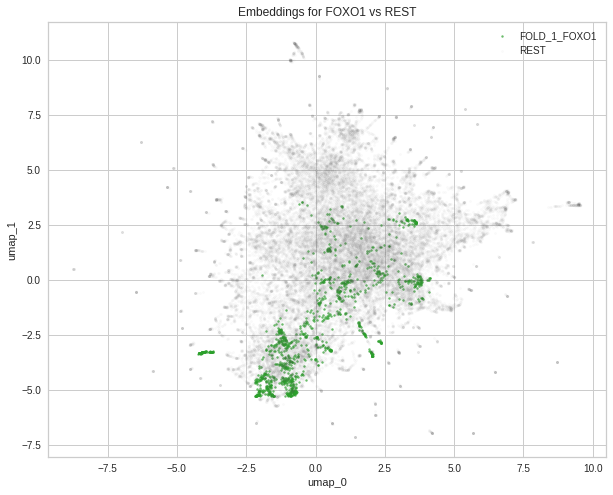

 43%|████▎     | 18/42 [00:04<00:06,  3.91it/s]

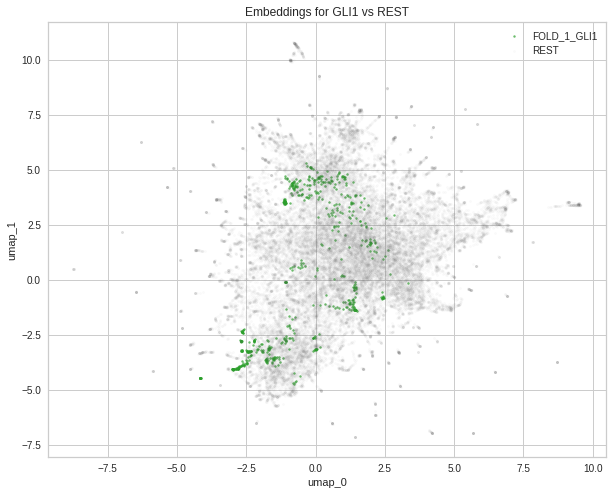

 45%|████▌     | 19/42 [00:05<00:05,  3.92it/s]

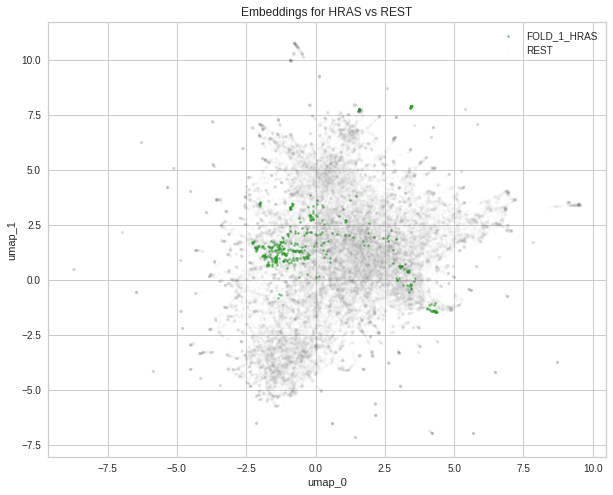

 48%|████▊     | 20/42 [00:05<00:05,  3.95it/s]

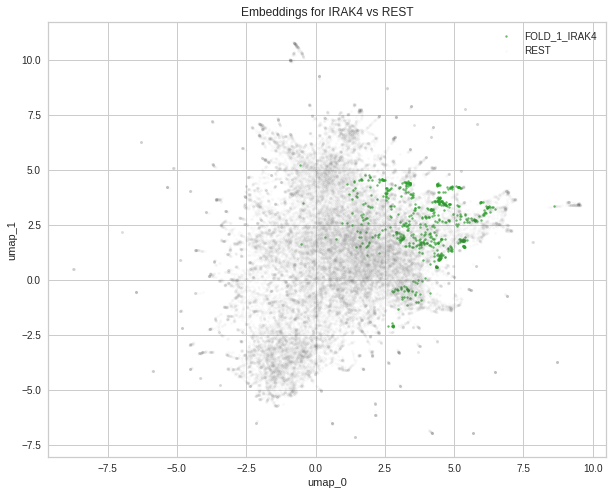

 50%|█████     | 21/42 [00:05<00:05,  3.96it/s]

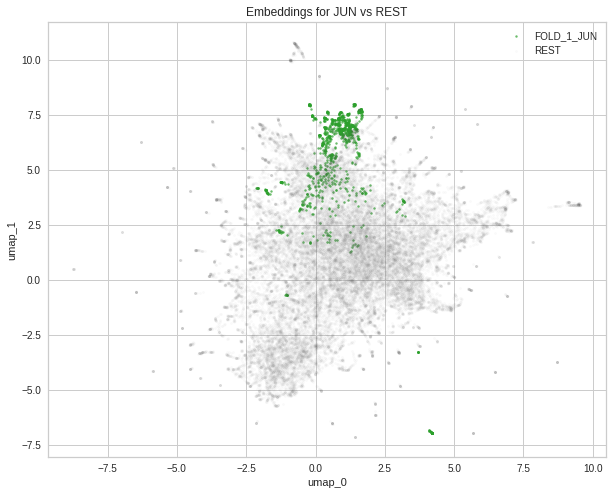

 52%|█████▏    | 22/42 [00:05<00:05,  3.98it/s]

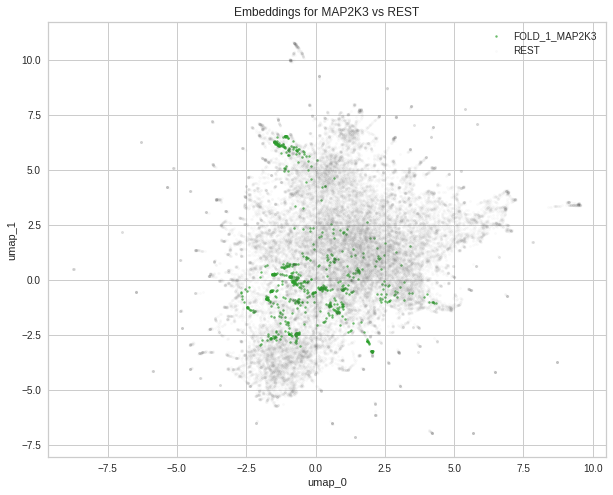

 55%|█████▍    | 23/42 [00:06<00:04,  3.99it/s]

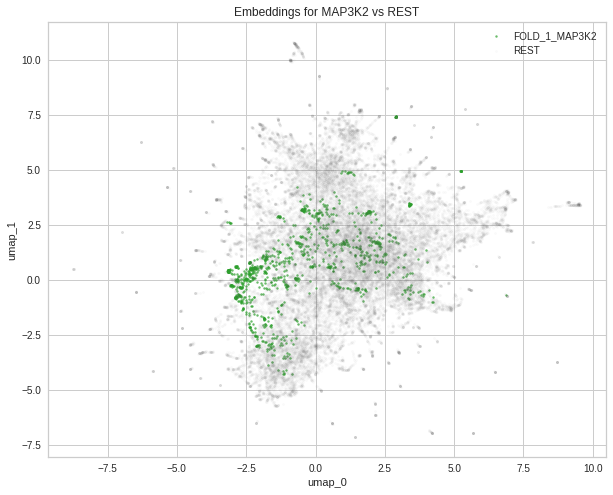

 57%|█████▋    | 24/42 [00:06<00:04,  4.00it/s]

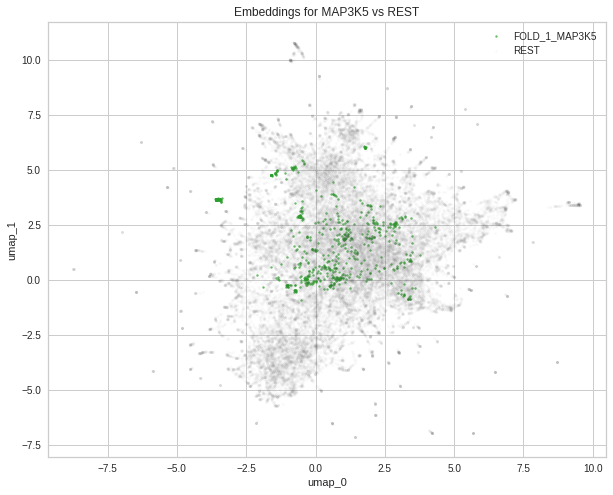

 60%|█████▉    | 25/42 [00:06<00:04,  3.99it/s]

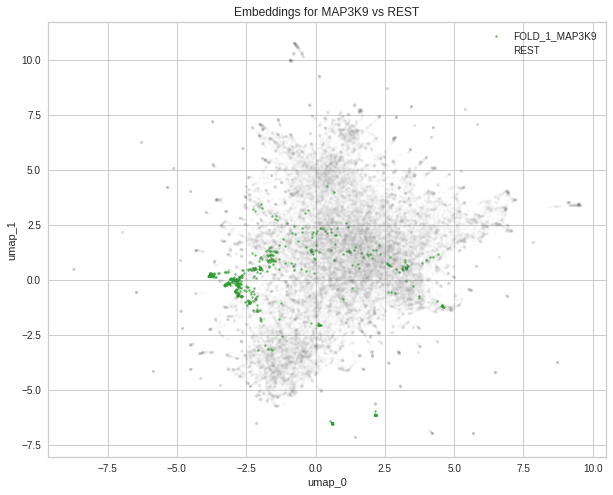

 62%|██████▏   | 26/42 [00:06<00:04,  3.99it/s]

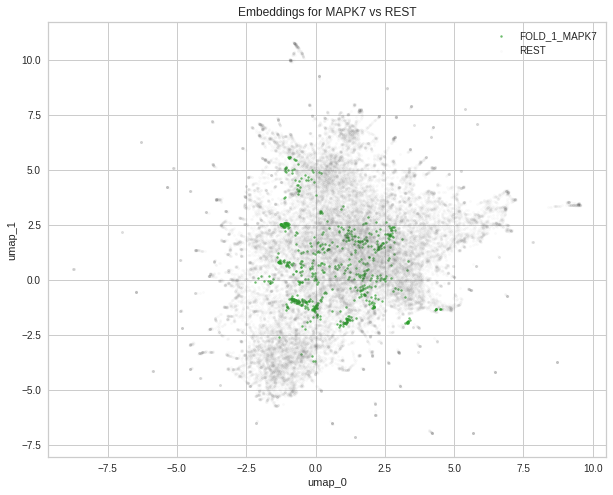

 64%|██████▍   | 27/42 [00:07<00:03,  3.99it/s]

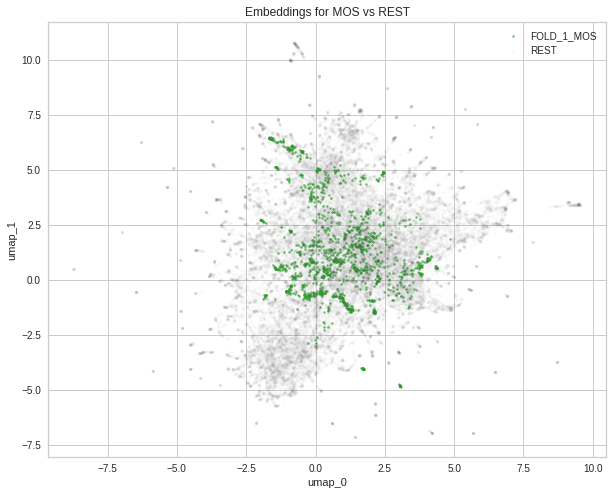

 67%|██████▋   | 28/42 [00:07<00:03,  4.01it/s]

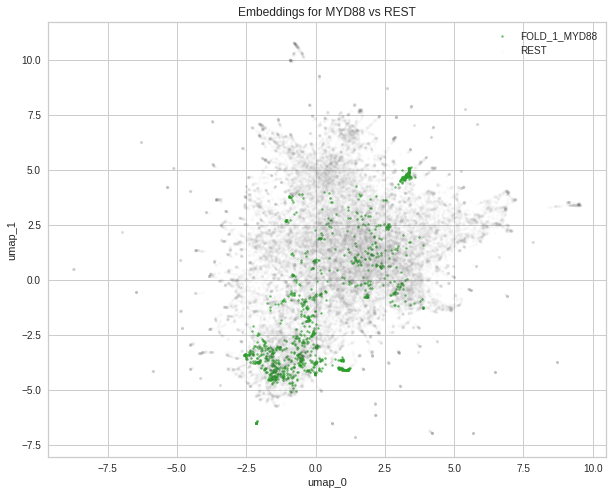

 69%|██████▉   | 29/42 [00:07<00:03,  4.01it/s]

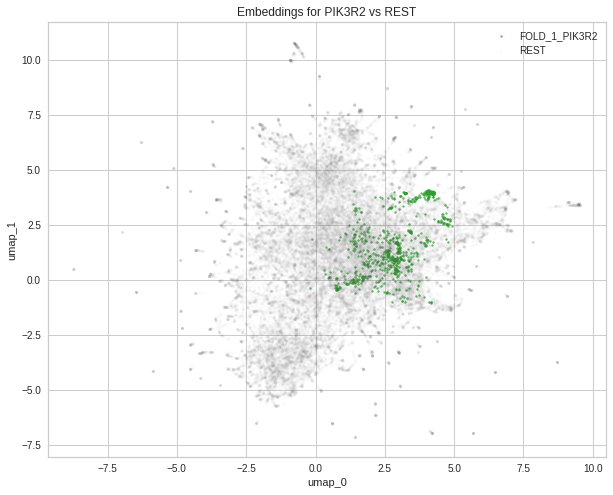

 71%|███████▏  | 30/42 [00:07<00:03,  3.93it/s]

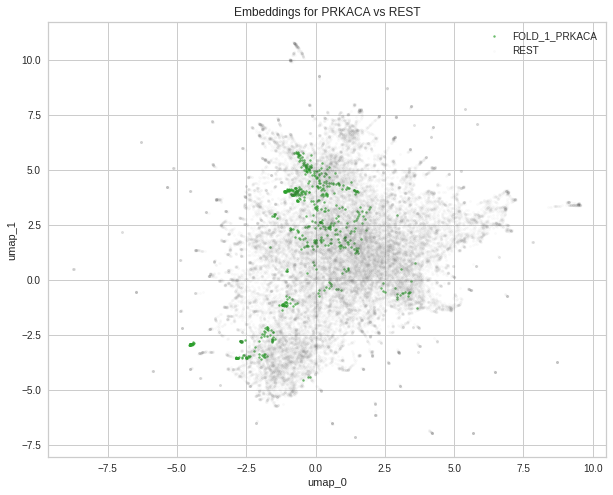

 74%|███████▍  | 31/42 [00:08<00:02,  3.97it/s]

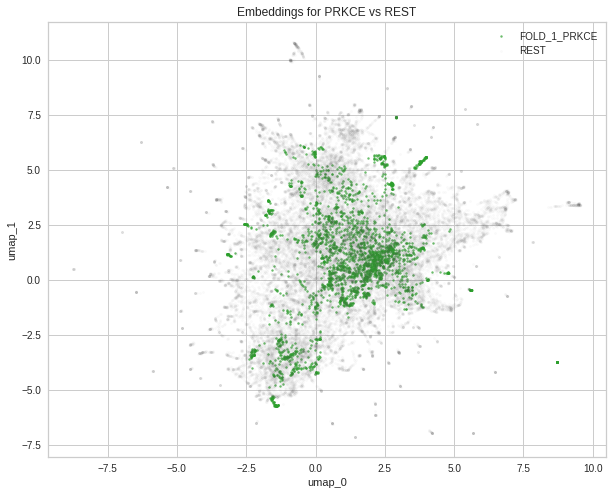

 76%|███████▌  | 32/42 [00:08<00:02,  3.78it/s]

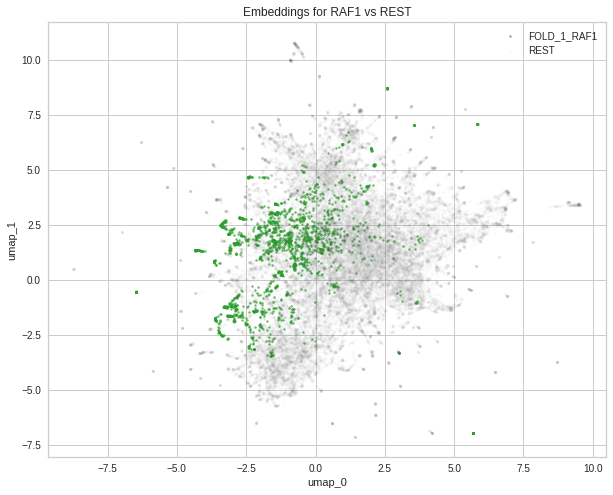

 79%|███████▊  | 33/42 [00:08<00:02,  3.85it/s]

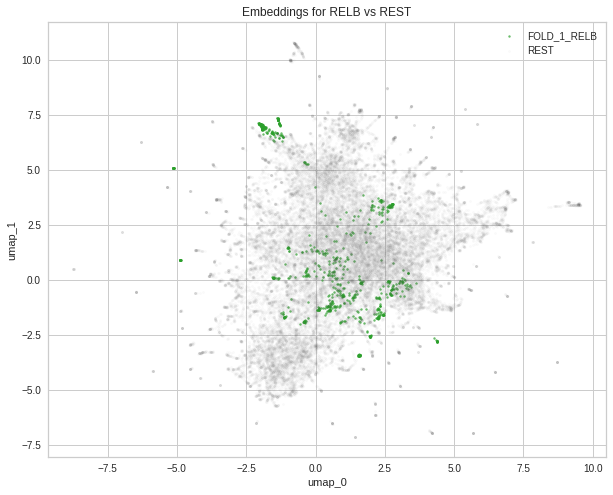

 81%|████████  | 34/42 [00:08<00:02,  3.89it/s]

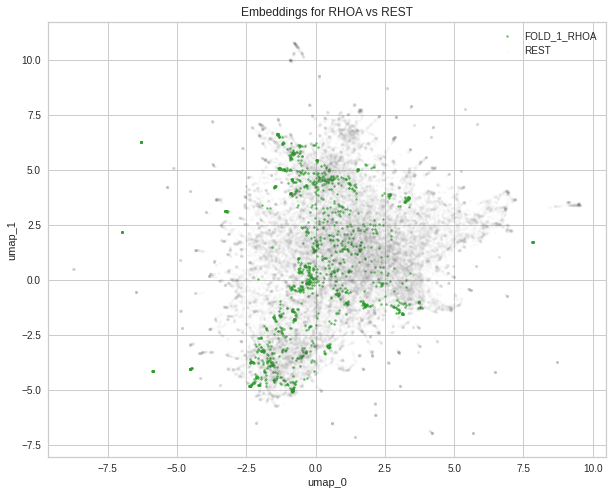

 83%|████████▎ | 35/42 [00:09<00:01,  3.85it/s]

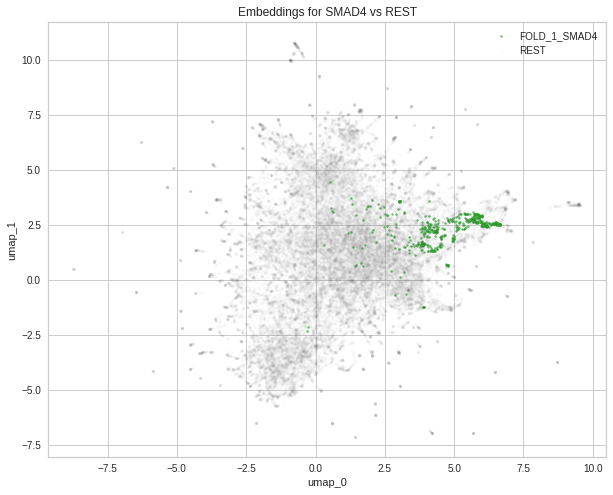

 86%|████████▌ | 36/42 [00:09<00:01,  3.20it/s]

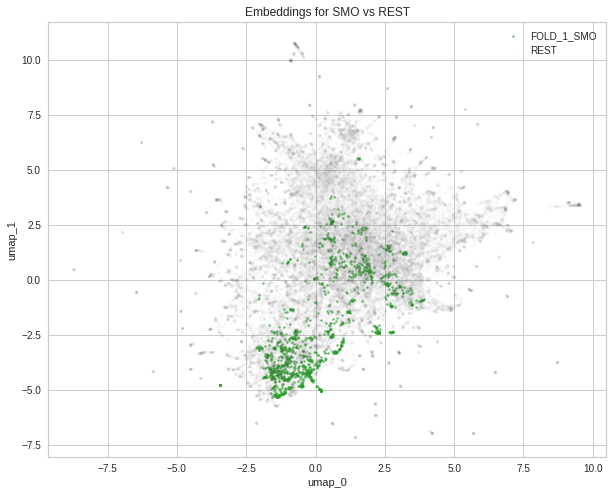

 88%|████████▊ | 37/42 [00:09<00:01,  3.38it/s]

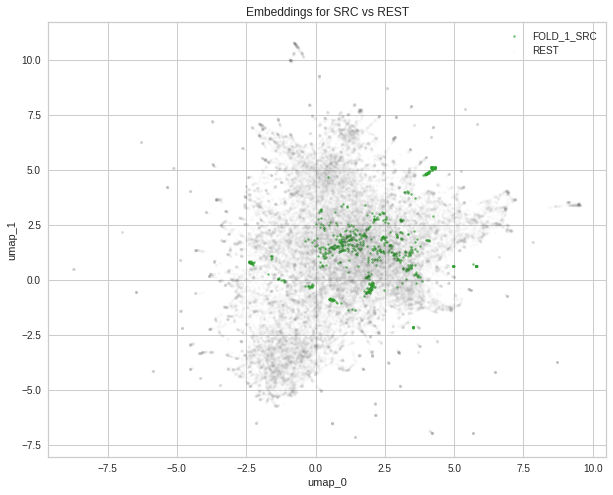

 90%|█████████ | 38/42 [00:10<00:01,  3.51it/s]

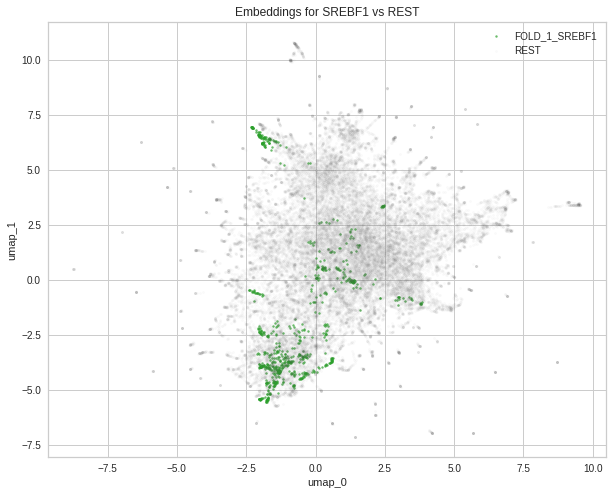

 93%|█████████▎| 39/42 [00:10<00:00,  3.61it/s]

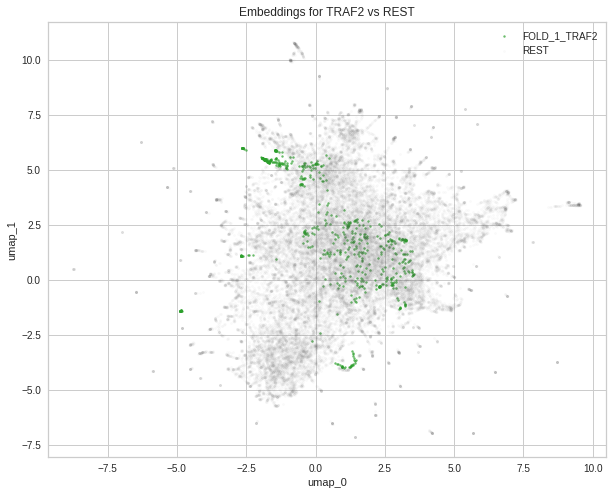

 95%|█████████▌| 40/42 [00:10<00:00,  3.71it/s]

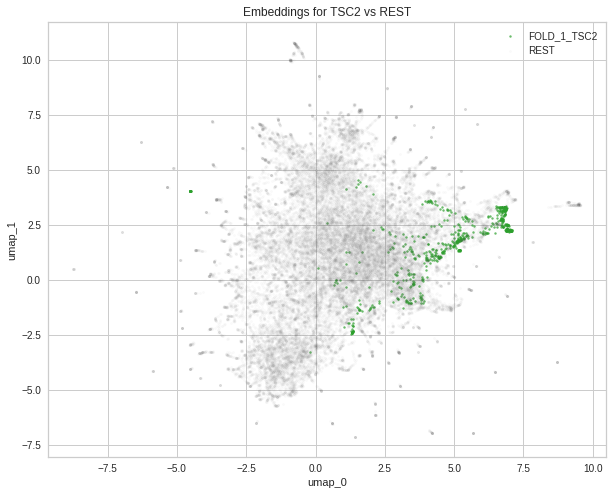

 98%|█████████▊| 41/42 [00:10<00:00,  3.78it/s]

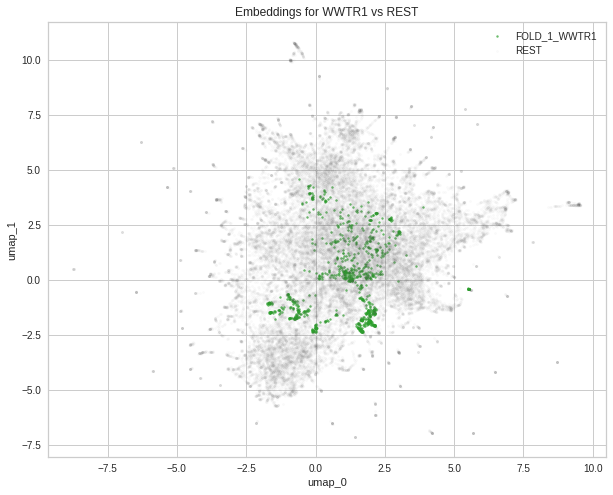

100%|██████████| 42/42 [00:11<00:00,  3.78it/s]


<IPython.core.display.Javascript object>

In [9]:
embs_1 = plot_struct_embs_cv(latents, random_state=1234, folds=["fold_1"])

##### Fold 2

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/pandas/core/indexing.py:723: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
  0%|          | 0/42 [00:00<?, ?it/s]

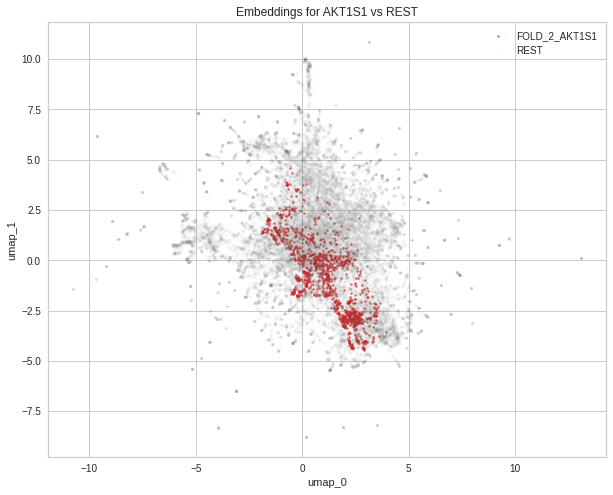

  2%|▏         | 1/42 [00:00<00:09,  4.22it/s]

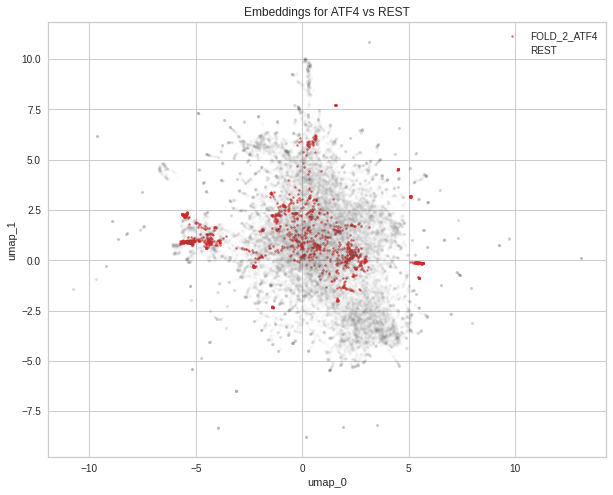

  5%|▍         | 2/42 [00:00<00:09,  4.17it/s]

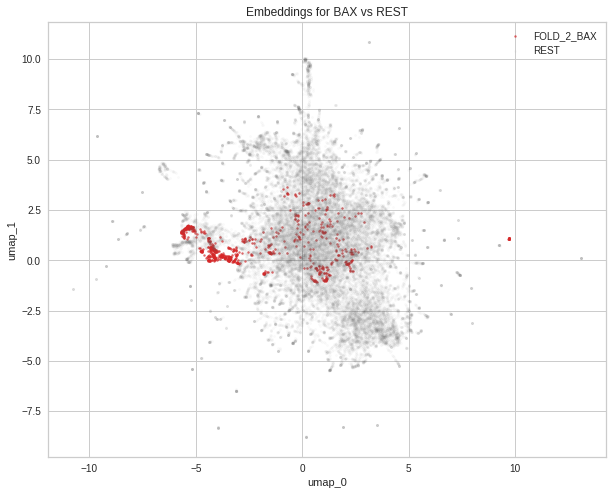

  7%|▋         | 3/42 [00:00<00:09,  4.05it/s]

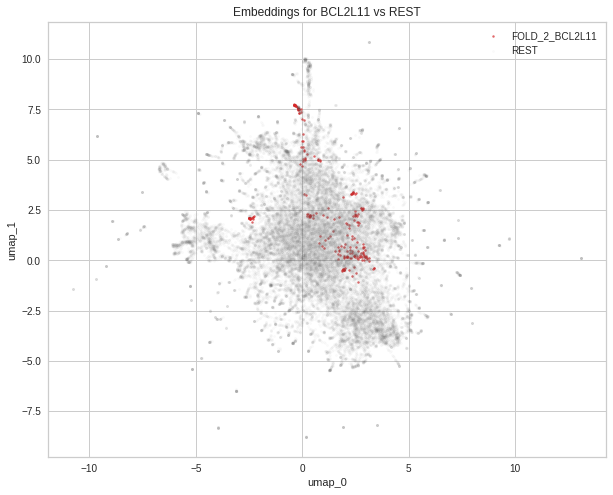

 10%|▉         | 4/42 [00:00<00:09,  3.95it/s]

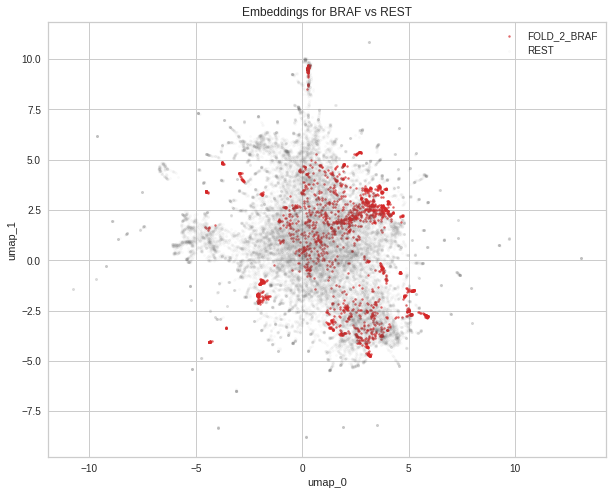

 12%|█▏        | 5/42 [00:01<00:09,  4.05it/s]

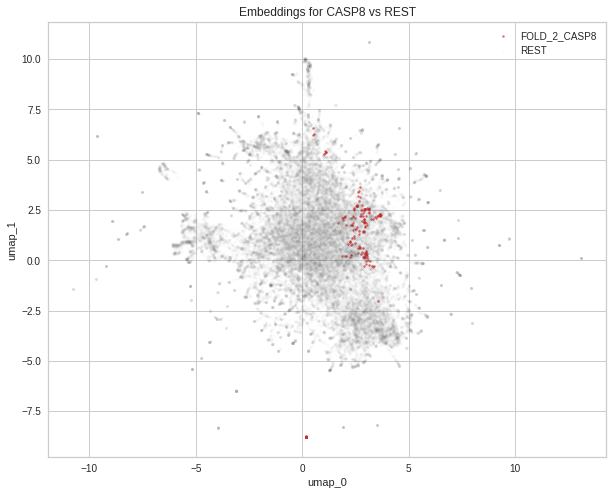

 14%|█▍        | 6/42 [00:01<00:08,  4.01it/s]

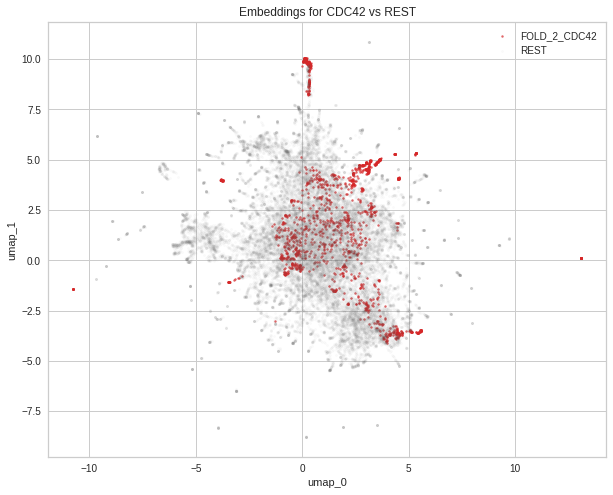

 17%|█▋        | 7/42 [00:01<00:08,  3.96it/s]

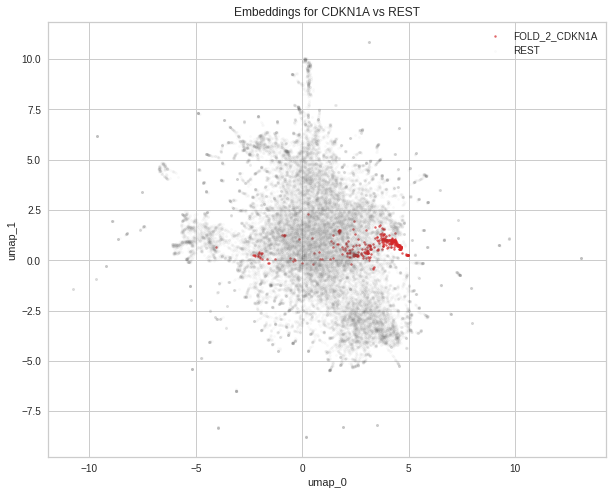

 19%|█▉        | 8/42 [00:01<00:08,  4.04it/s]

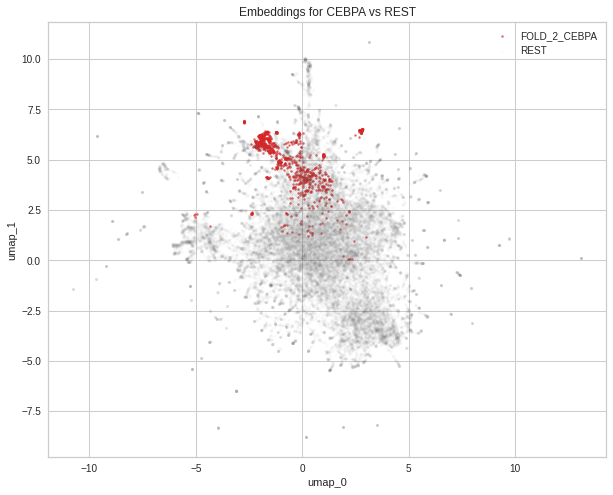

 21%|██▏       | 9/42 [00:02<00:08,  4.10it/s]

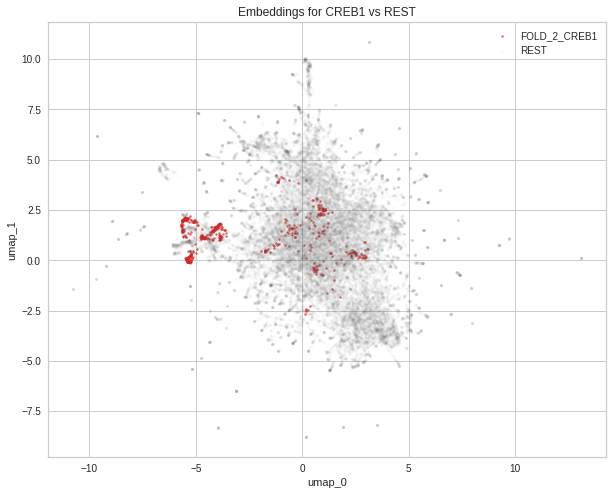

 24%|██▍       | 10/42 [00:02<00:07,  4.15it/s]

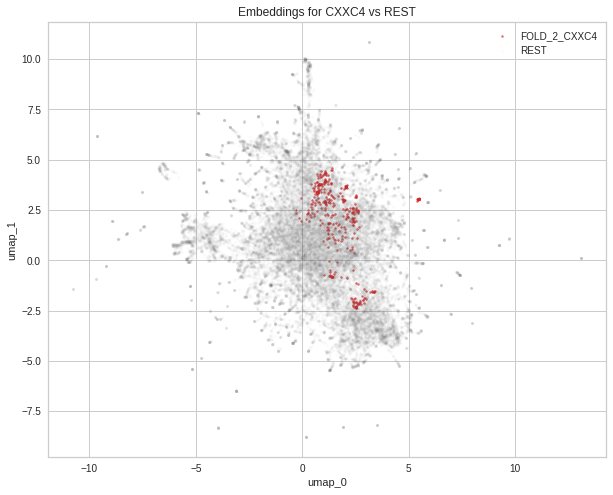

 26%|██▌       | 11/42 [00:02<00:07,  4.15it/s]

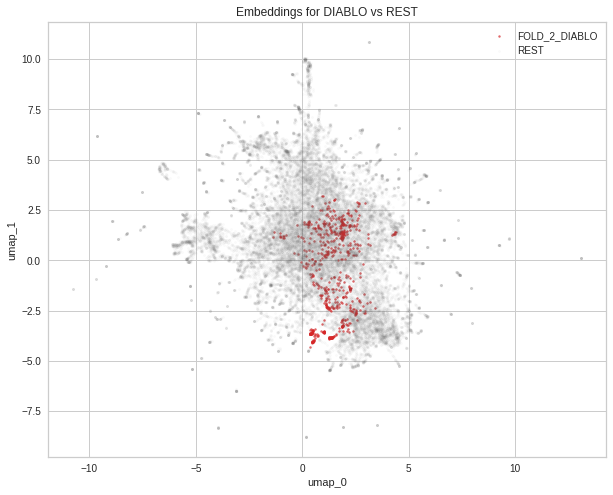

 29%|██▊       | 12/42 [00:03<00:08,  3.39it/s]

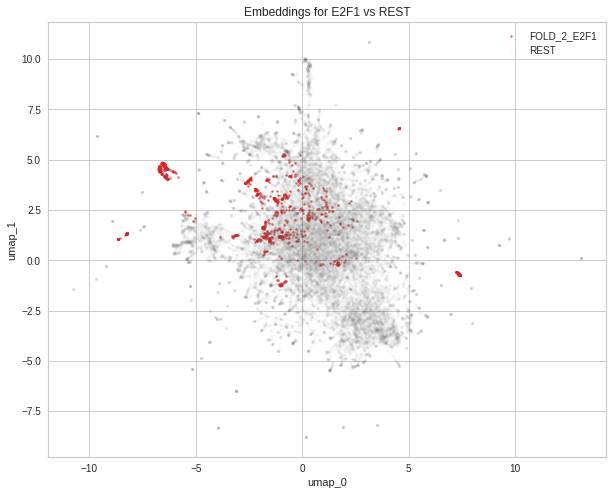

 31%|███       | 13/42 [00:03<00:08,  3.57it/s]

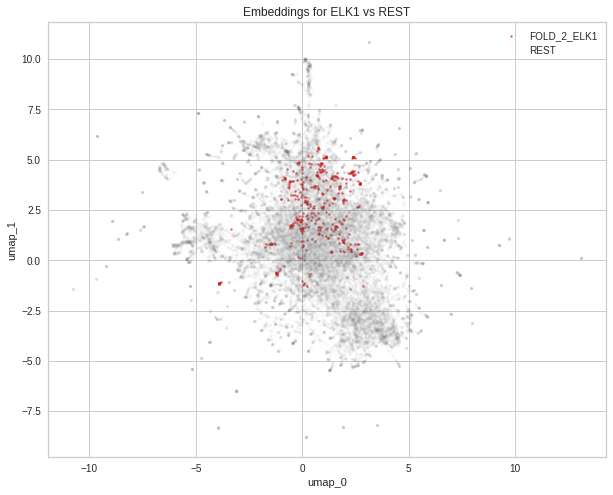

 33%|███▎      | 14/42 [00:03<00:07,  3.70it/s]

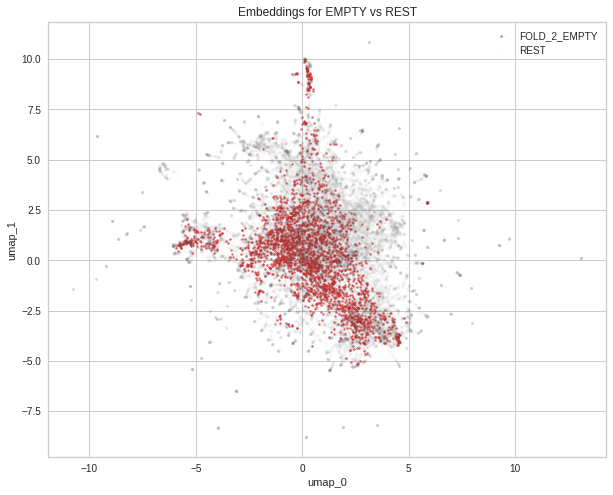

 36%|███▌      | 15/42 [00:03<00:07,  3.80it/s]

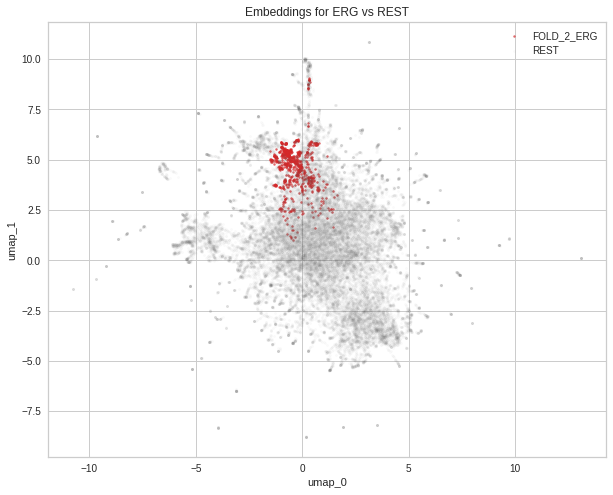

 38%|███▊      | 16/42 [00:04<00:06,  3.79it/s]

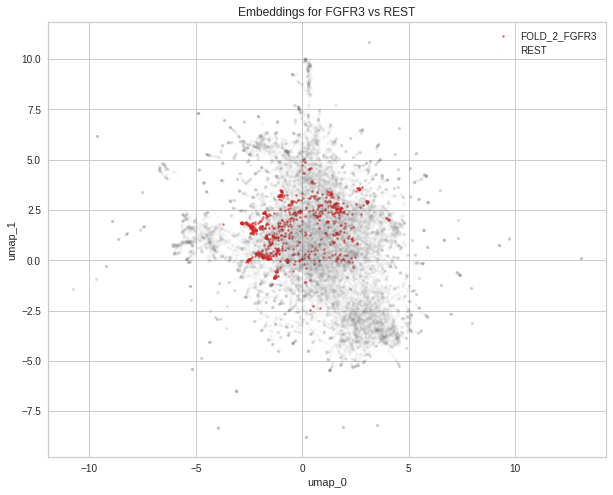

 40%|████      | 17/42 [00:04<00:06,  3.89it/s]

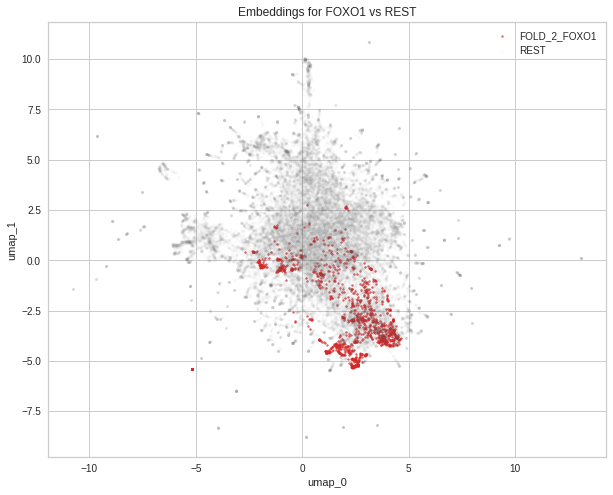

 43%|████▎     | 18/42 [00:04<00:06,  3.94it/s]

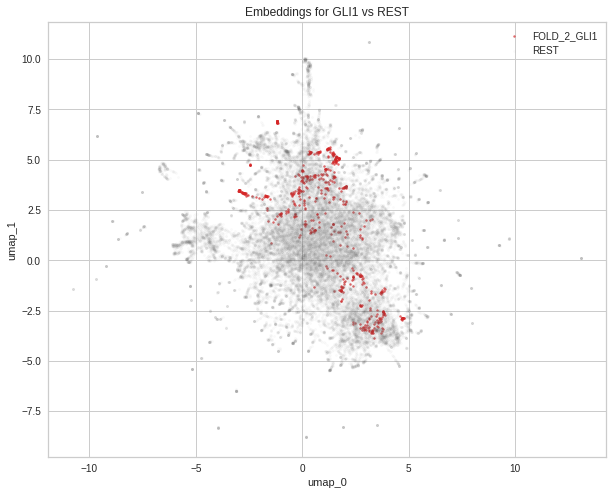

 45%|████▌     | 19/42 [00:04<00:06,  3.81it/s]

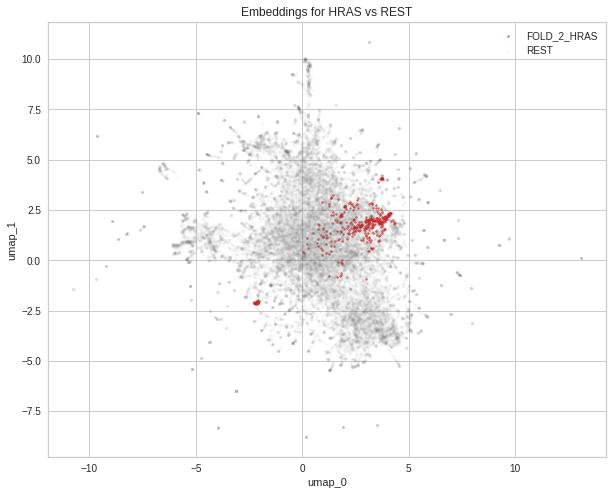

 48%|████▊     | 20/42 [00:05<00:05,  3.87it/s]

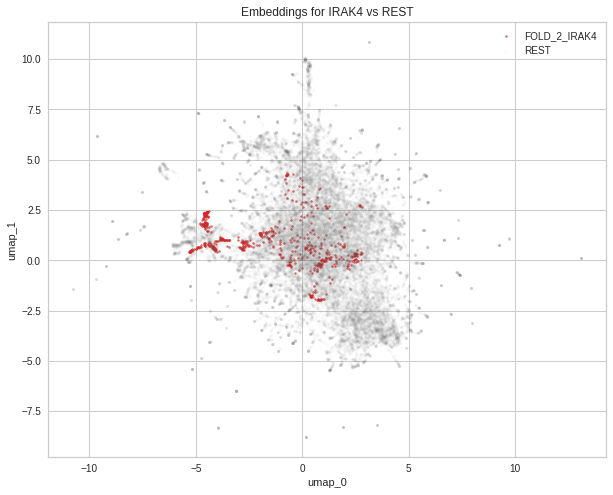

 50%|█████     | 21/42 [00:05<00:05,  3.93it/s]

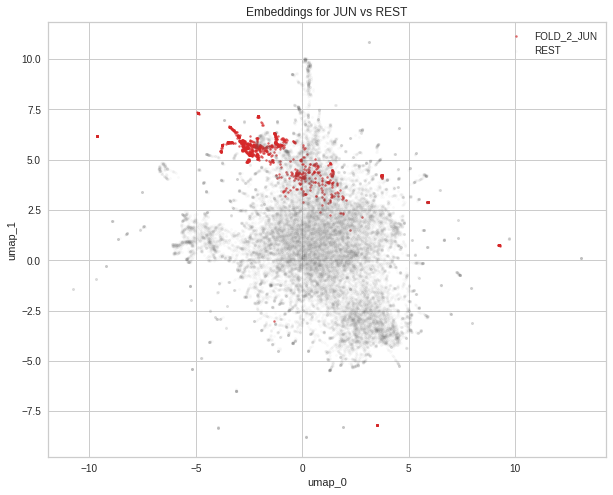

 52%|█████▏    | 22/42 [00:05<00:04,  4.03it/s]

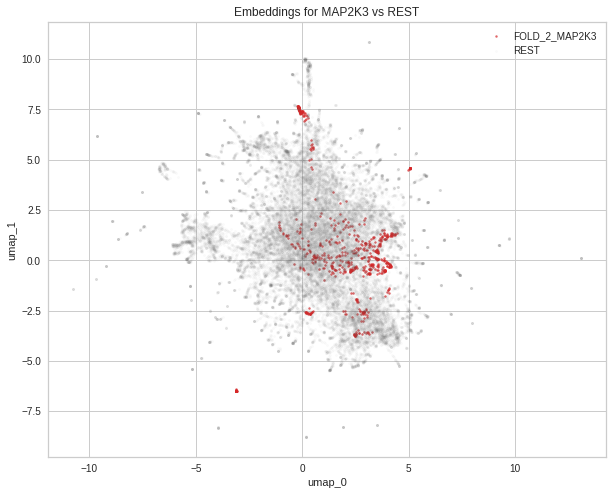

 55%|█████▍    | 23/42 [00:05<00:04,  4.06it/s]

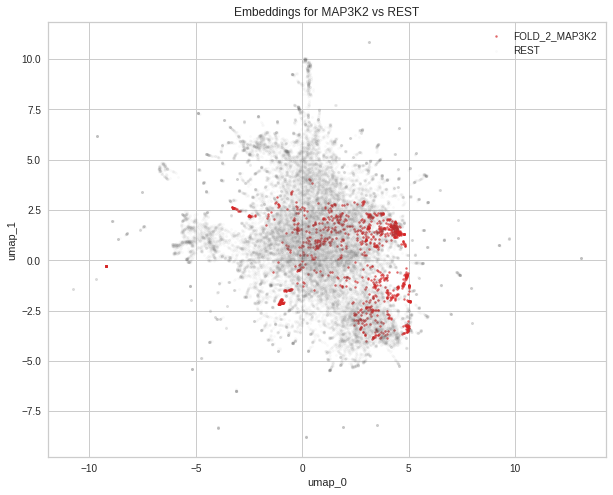

 57%|█████▋    | 24/42 [00:06<00:04,  3.93it/s]

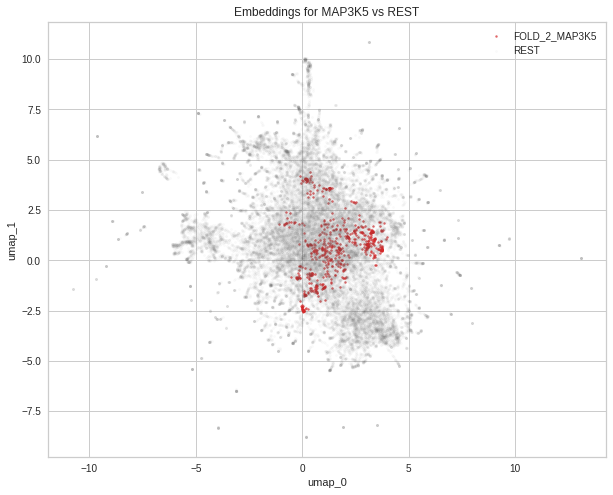

 60%|█████▉    | 25/42 [00:06<00:04,  3.89it/s]

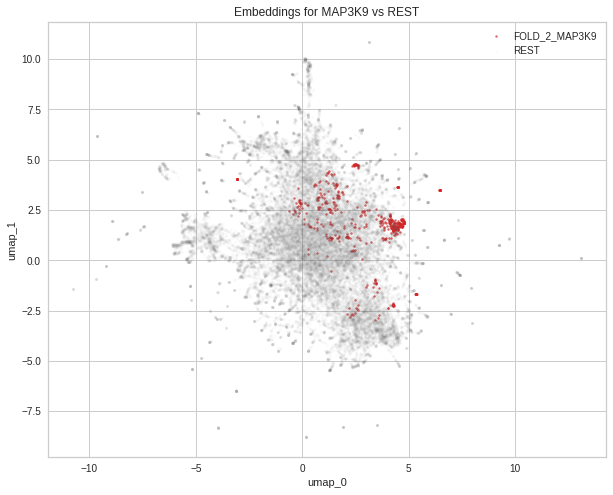

 62%|██████▏   | 26/42 [00:06<00:04,  3.84it/s]

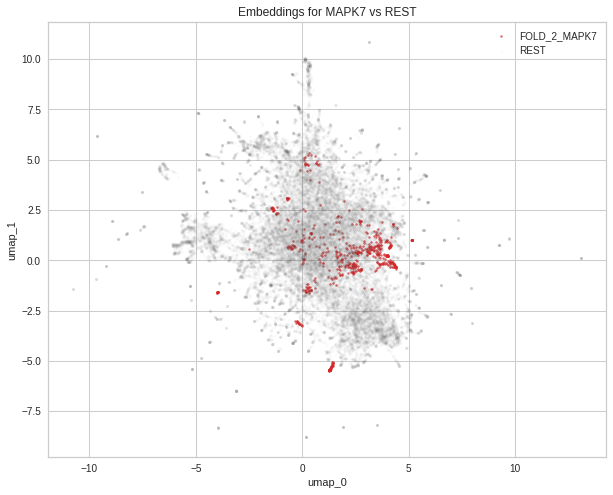

 64%|██████▍   | 27/42 [00:06<00:03,  3.77it/s]

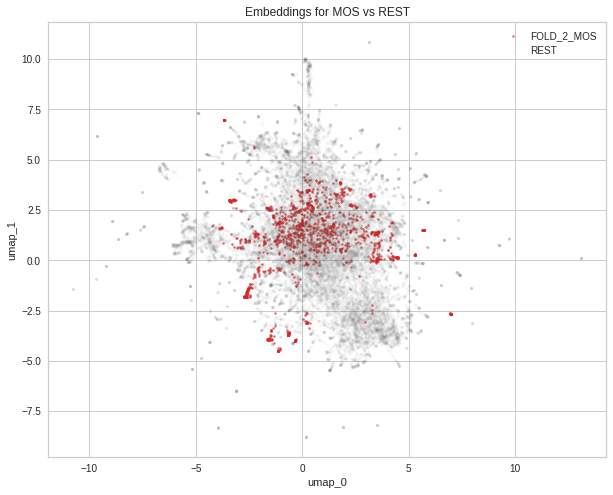

 67%|██████▋   | 28/42 [00:07<00:03,  3.75it/s]

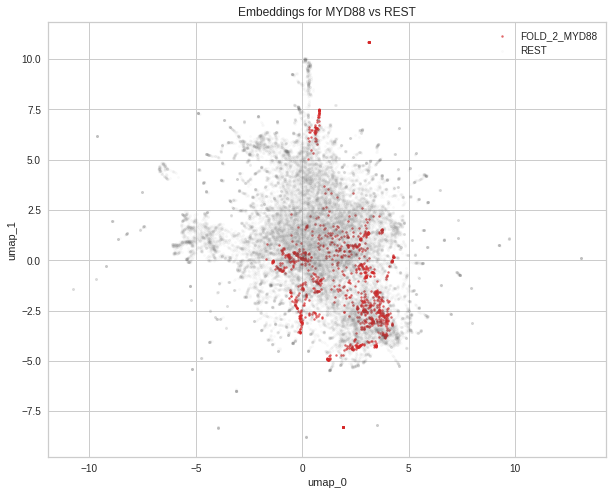

 69%|██████▉   | 29/42 [00:07<00:03,  3.78it/s]

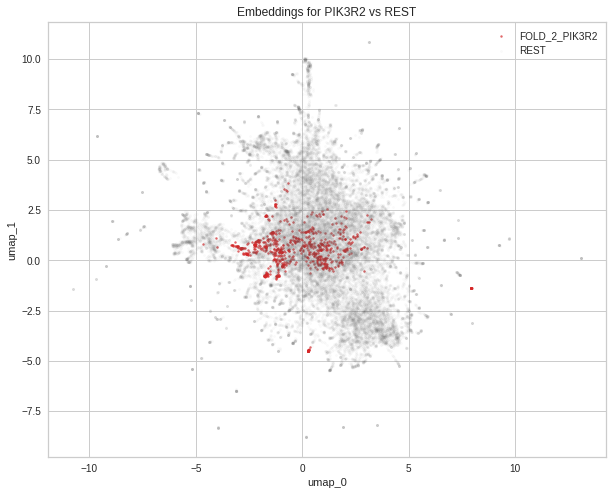

 71%|███████▏  | 30/42 [00:07<00:03,  3.87it/s]

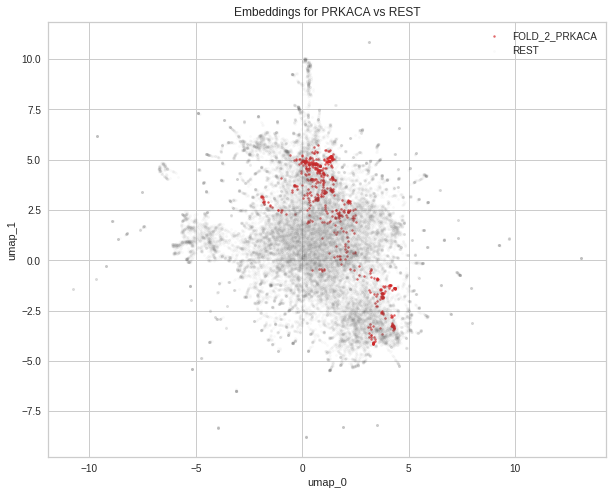

 74%|███████▍  | 31/42 [00:07<00:02,  3.96it/s]

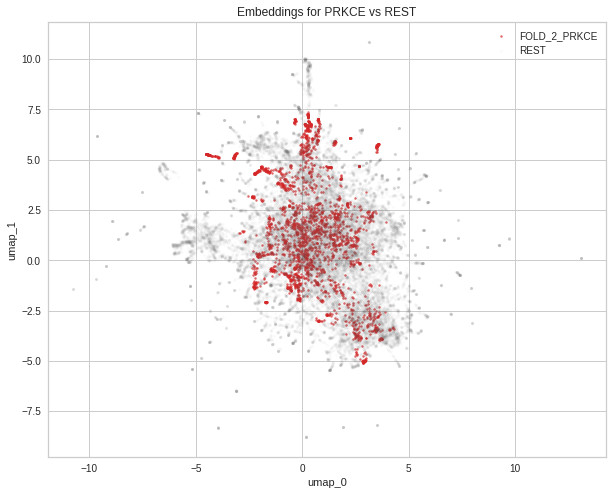

 76%|███████▌  | 32/42 [00:08<00:02,  3.99it/s]

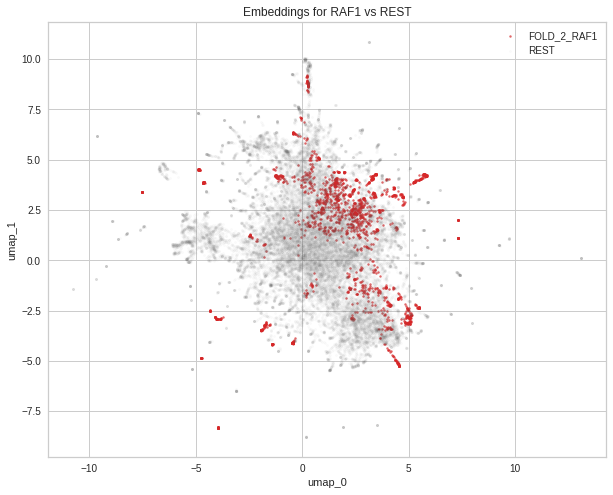

 79%|███████▊  | 33/42 [00:08<00:02,  4.06it/s]

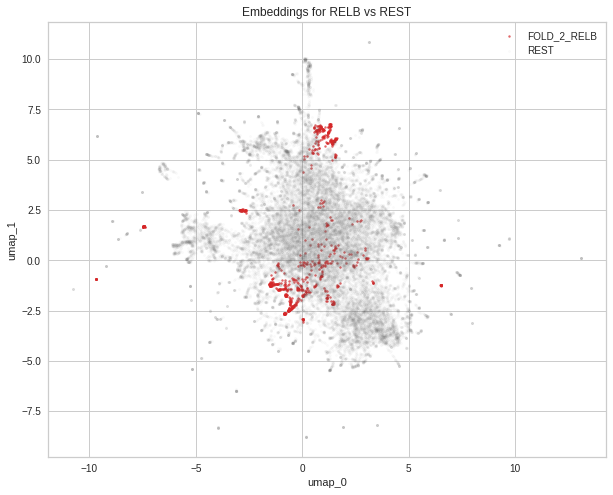

 81%|████████  | 34/42 [00:08<00:01,  4.10it/s]

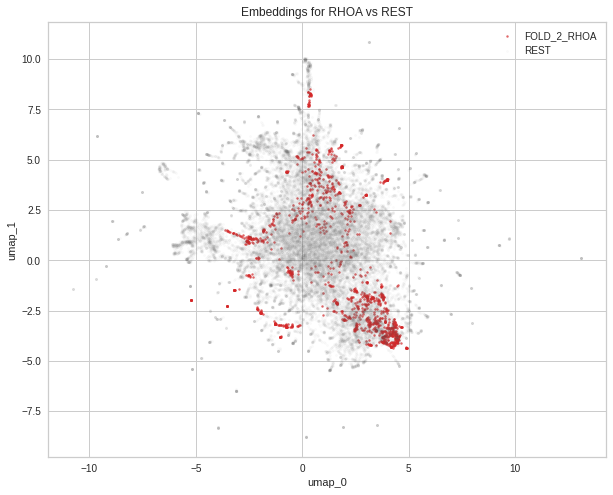

 83%|████████▎ | 35/42 [00:08<00:01,  3.96it/s]

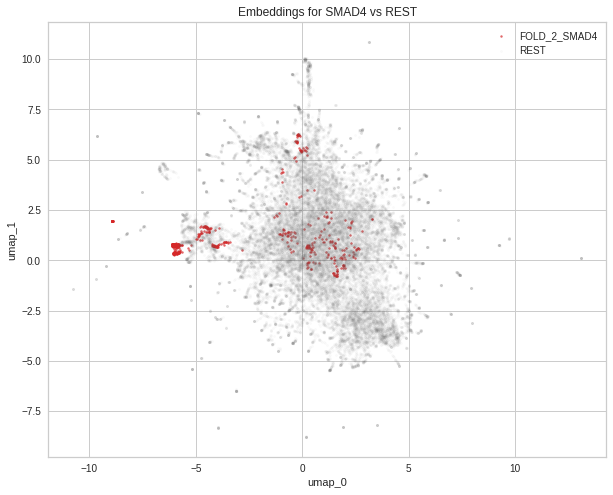

 86%|████████▌ | 36/42 [00:09<00:01,  3.97it/s]

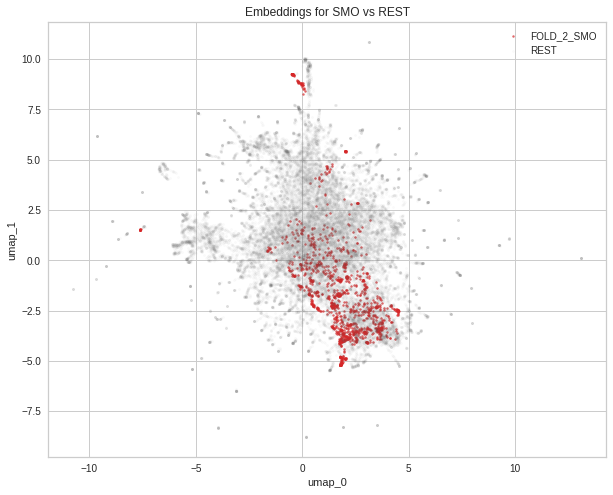

 88%|████████▊ | 37/42 [00:09<00:01,  4.03it/s]

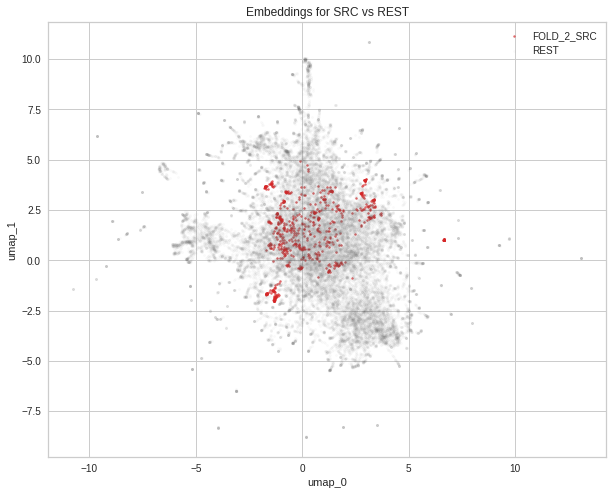

 90%|█████████ | 38/42 [00:09<00:00,  4.09it/s]

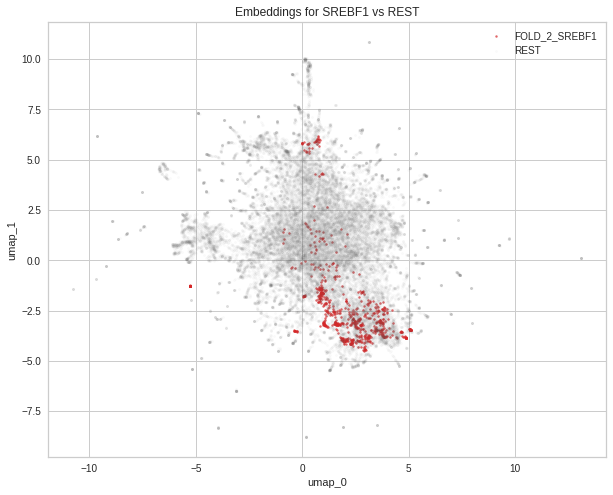

 93%|█████████▎| 39/42 [00:09<00:00,  4.13it/s]

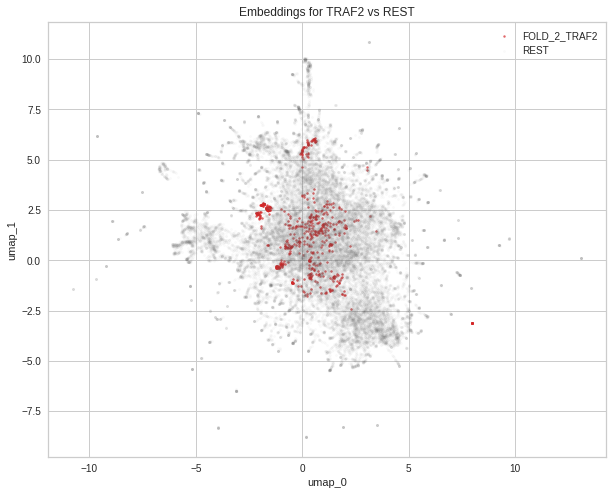

 95%|█████████▌| 40/42 [00:10<00:00,  4.16it/s]

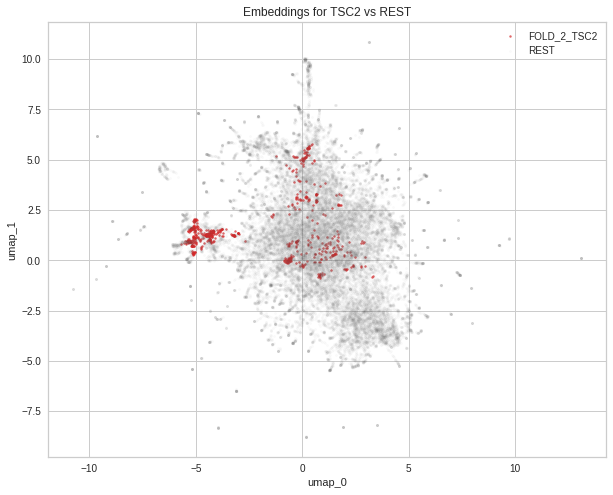

 98%|█████████▊| 41/42 [00:10<00:00,  4.18it/s]

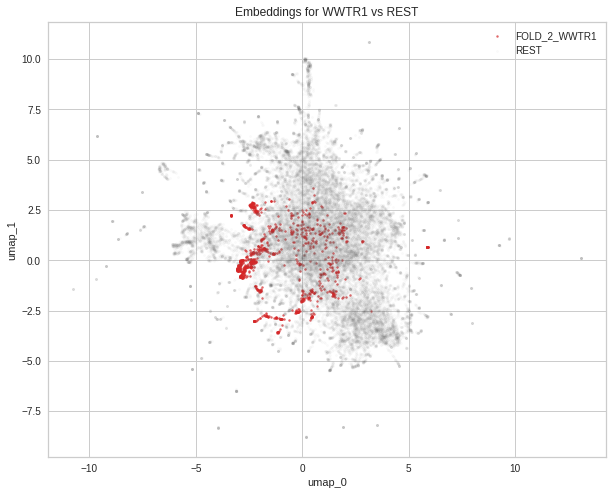

100%|██████████| 42/42 [00:10<00:00,  3.89it/s]


<IPython.core.display.Javascript object>

In [10]:
embs_2 = plot_struct_embs_cv(latents, random_state=1234, folds=["fold_2"])

##### Fold 3

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/pandas/core/indexing.py:723: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
  0%|          | 0/42 [00:00<?, ?it/s]

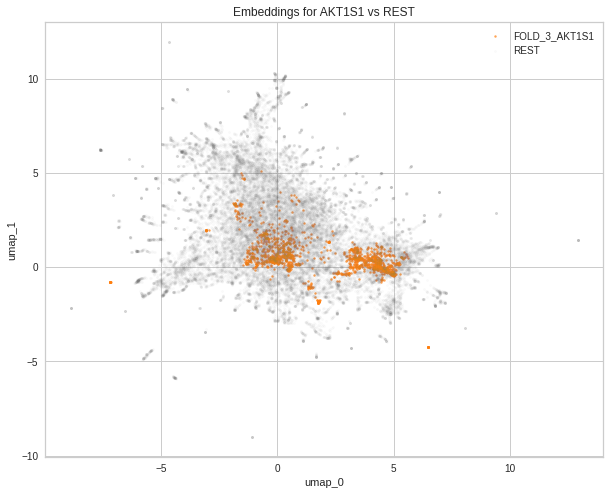

  2%|▏         | 1/42 [00:00<00:09,  4.32it/s]

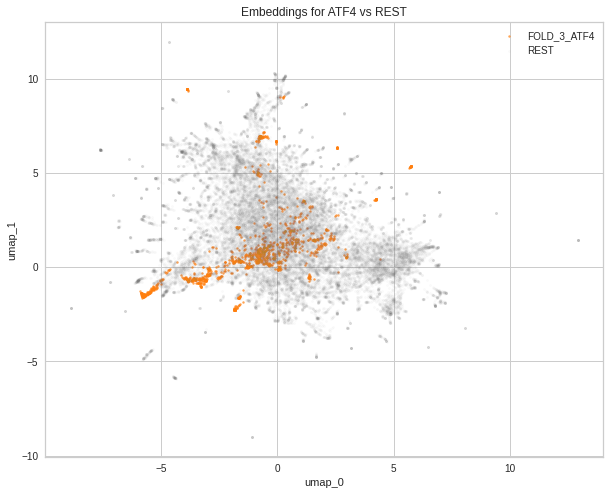

  5%|▍         | 2/42 [00:00<00:09,  4.22it/s]

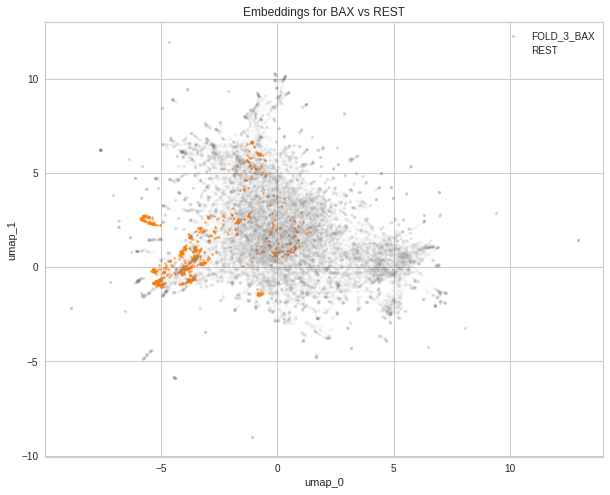

  7%|▋         | 3/42 [00:00<00:09,  4.07it/s]

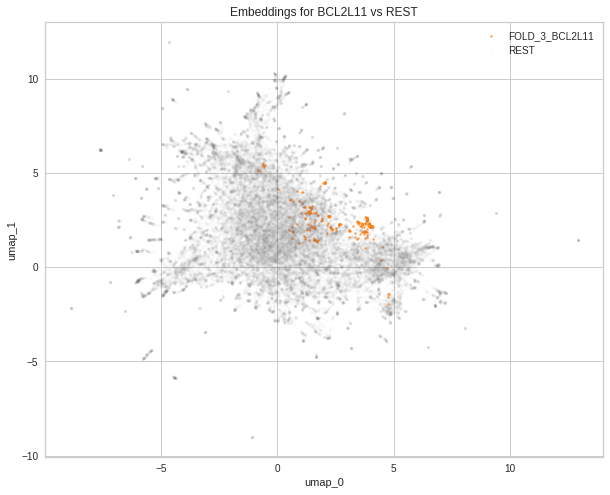

 10%|▉         | 4/42 [00:00<00:09,  4.18it/s]

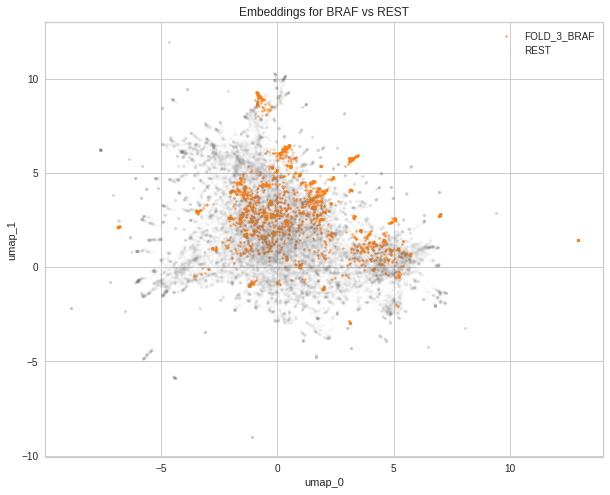

 12%|█▏        | 5/42 [00:01<00:08,  4.19it/s]

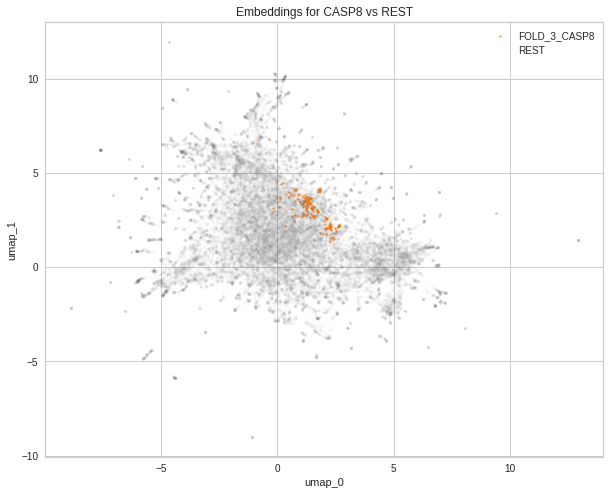

 14%|█▍        | 6/42 [00:01<00:08,  4.24it/s]

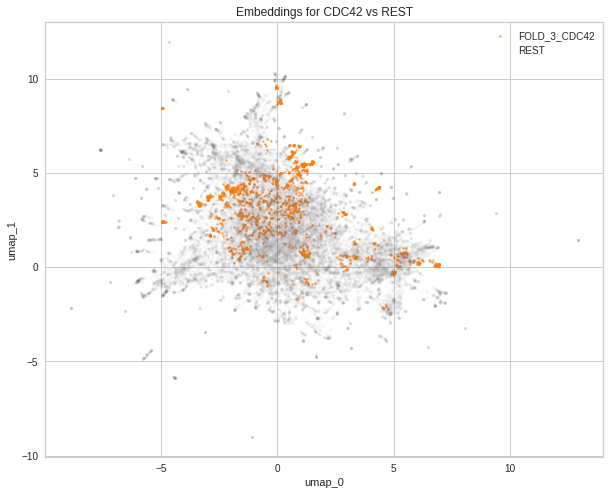

 17%|█▋        | 7/42 [00:01<00:08,  4.25it/s]

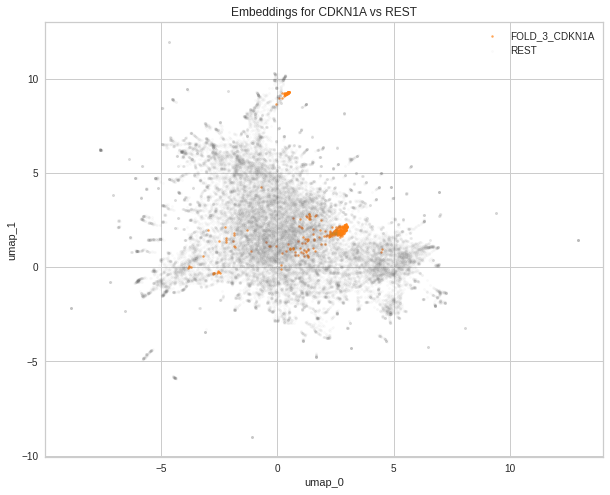

 19%|█▉        | 8/42 [00:01<00:07,  4.29it/s]

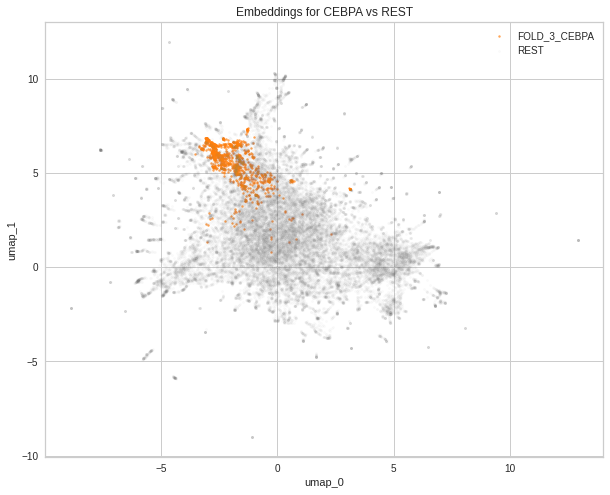

 21%|██▏       | 9/42 [00:02<00:08,  4.03it/s]

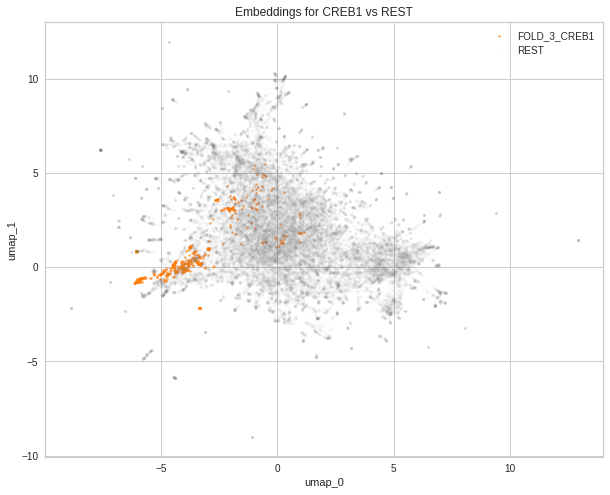

 24%|██▍       | 10/42 [00:02<00:07,  4.04it/s]

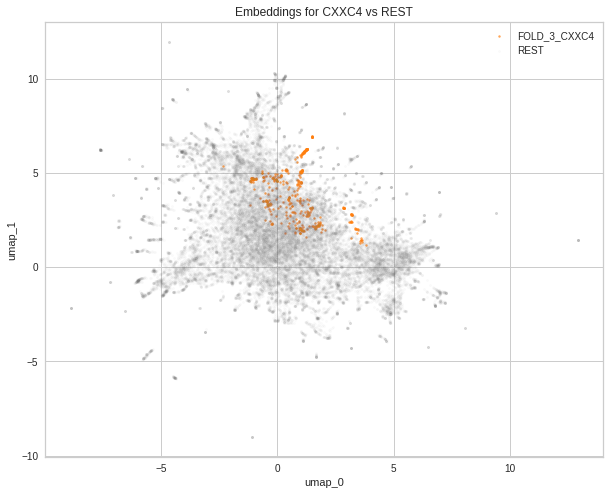

 26%|██▌       | 11/42 [00:02<00:07,  4.12it/s]

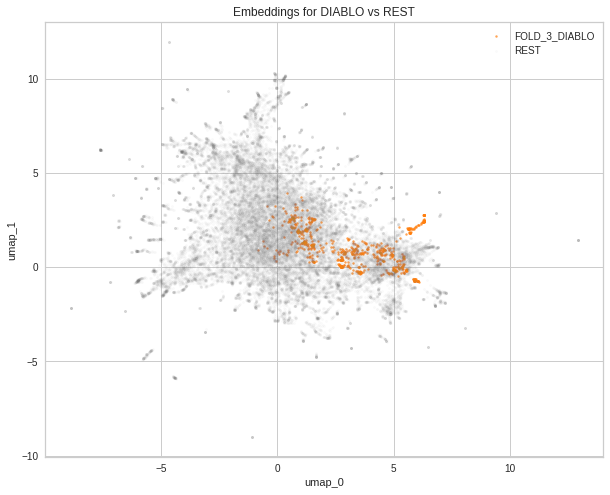

 29%|██▊       | 12/42 [00:02<00:07,  4.21it/s]

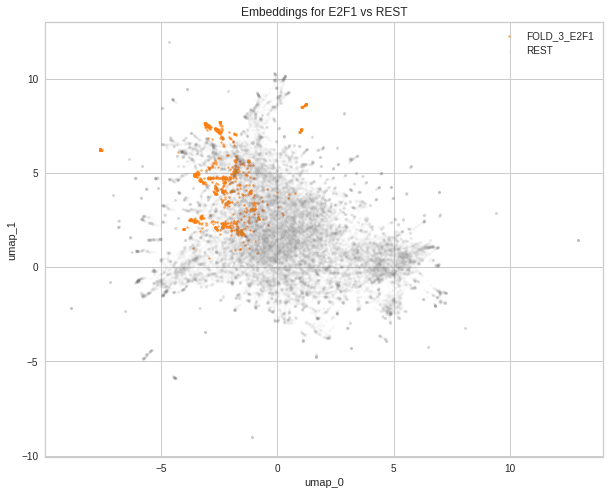

 31%|███       | 13/42 [00:03<00:06,  4.27it/s]

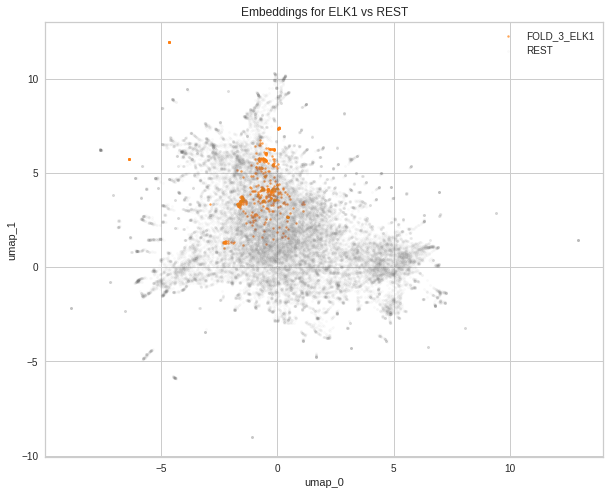

 33%|███▎      | 14/42 [00:03<00:06,  4.15it/s]

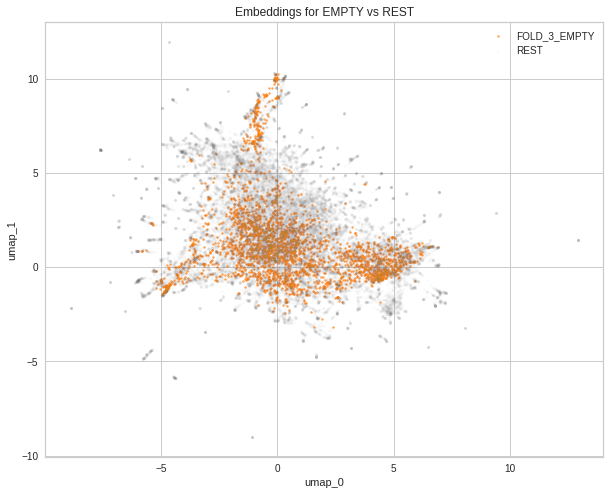

 36%|███▌      | 15/42 [00:03<00:06,  4.05it/s]

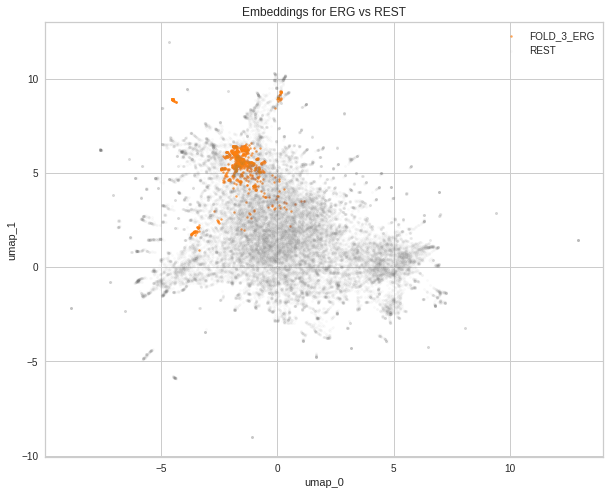

 38%|███▊      | 16/42 [00:03<00:06,  4.15it/s]

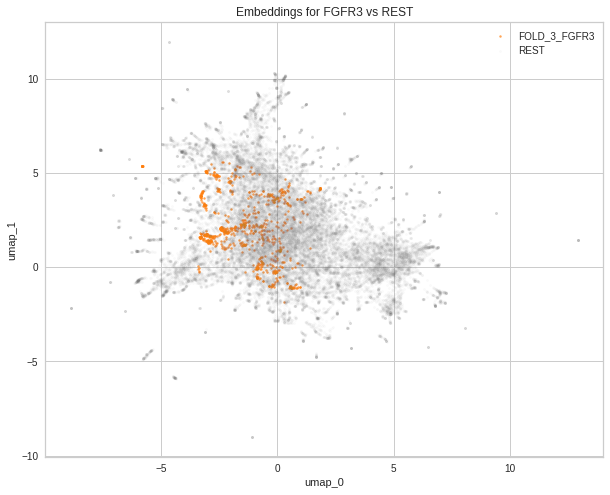

 40%|████      | 17/42 [00:04<00:05,  4.22it/s]

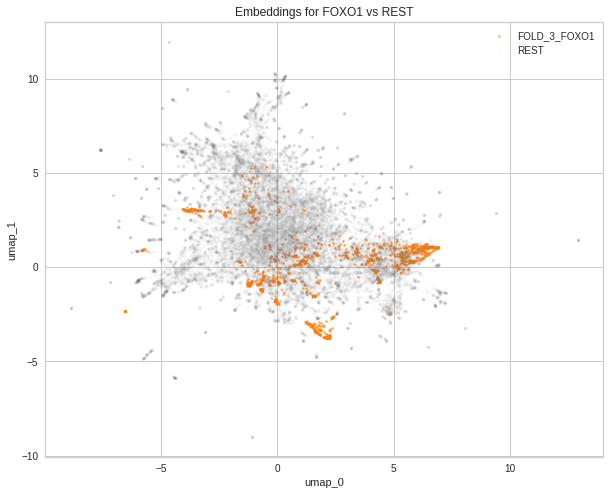

 43%|████▎     | 18/42 [00:04<00:05,  4.27it/s]

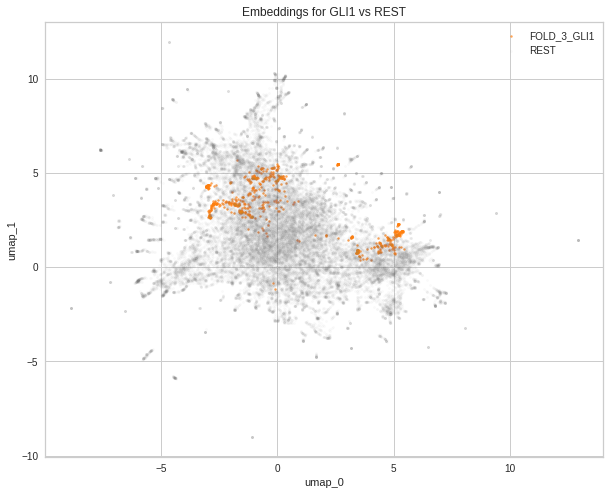

 45%|████▌     | 19/42 [00:04<00:05,  4.30it/s]

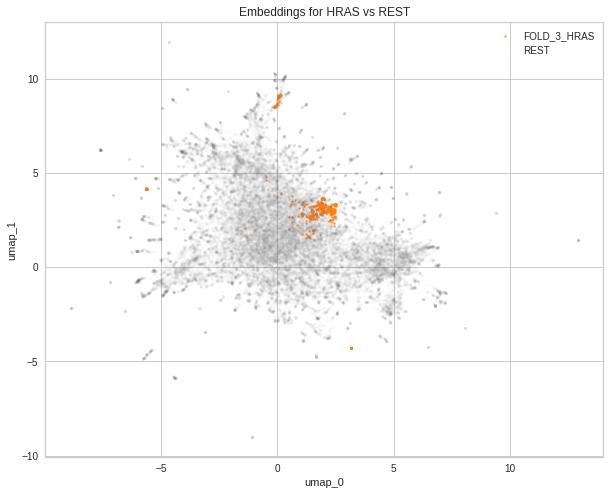

 48%|████▊     | 20/42 [00:04<00:06,  3.43it/s]

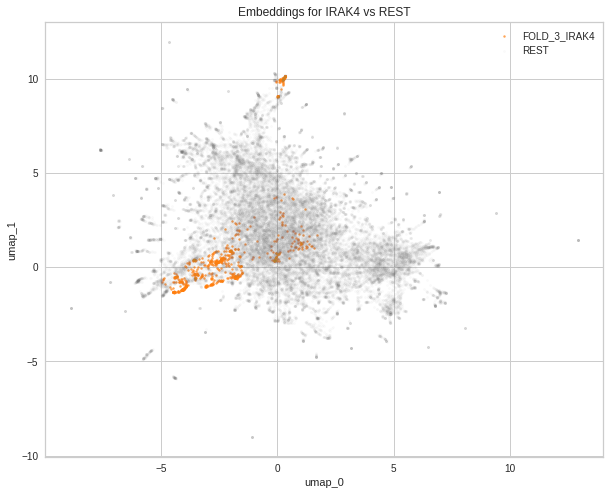

 50%|█████     | 21/42 [00:05<00:05,  3.64it/s]

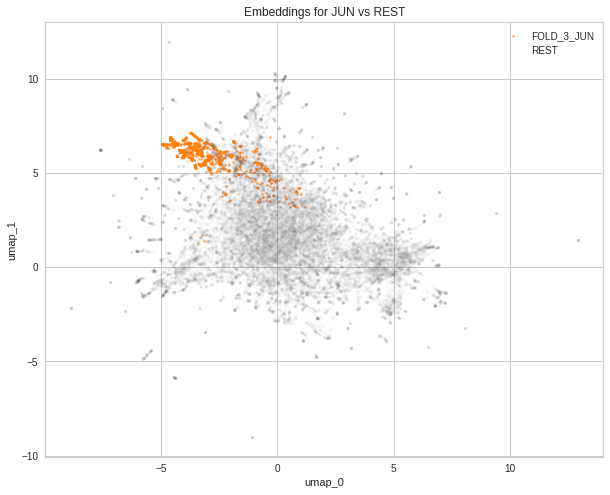

 52%|█████▏    | 22/42 [00:05<00:05,  3.79it/s]

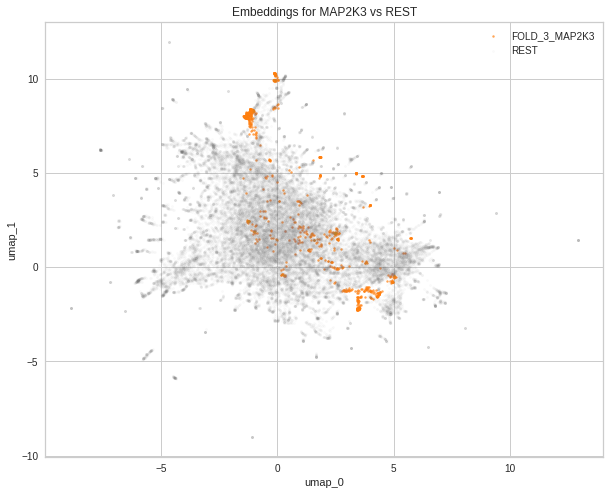

 55%|█████▍    | 23/42 [00:05<00:04,  3.91it/s]

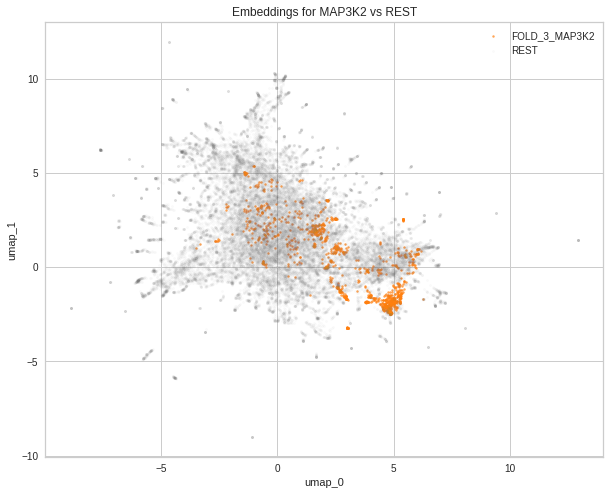

 57%|█████▋    | 24/42 [00:05<00:04,  4.00it/s]

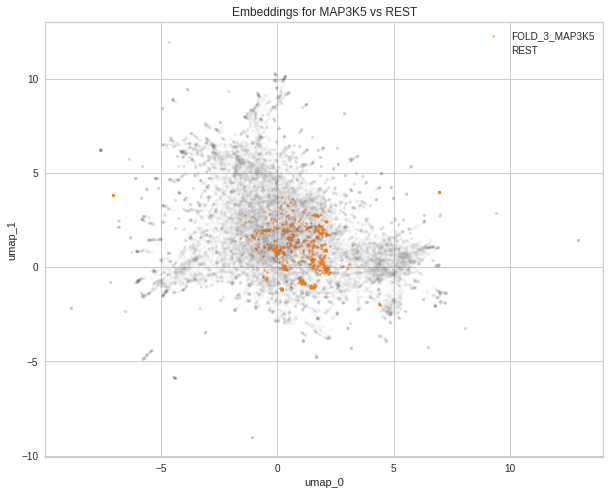

 60%|█████▉    | 25/42 [00:06<00:04,  4.08it/s]

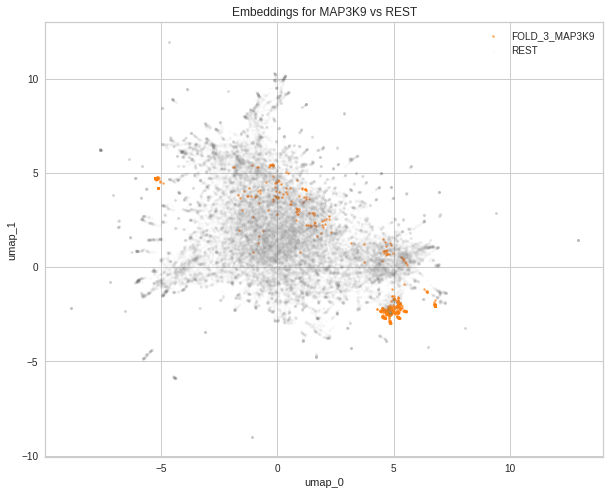

 62%|██████▏   | 26/42 [00:06<00:03,  4.13it/s]

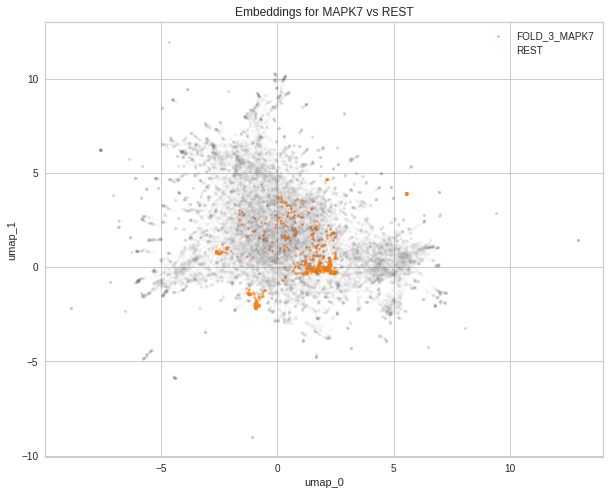

 64%|██████▍   | 27/42 [00:06<00:03,  3.97it/s]

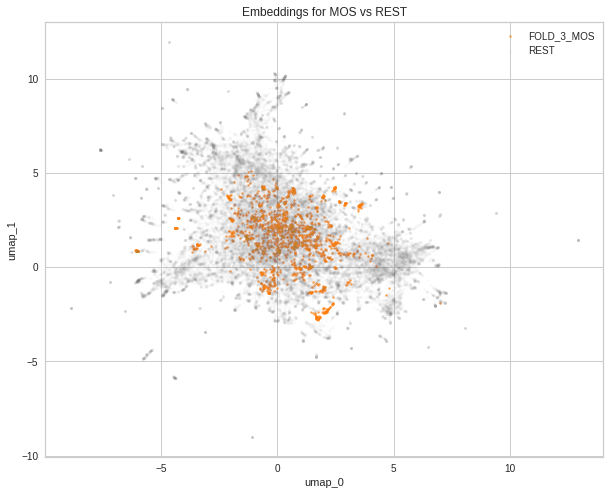

 67%|██████▋   | 28/42 [00:06<00:03,  4.07it/s]

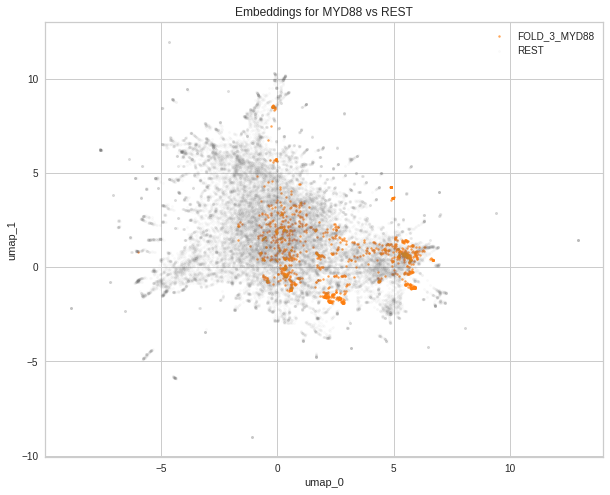

 69%|██████▉   | 29/42 [00:07<00:03,  4.13it/s]

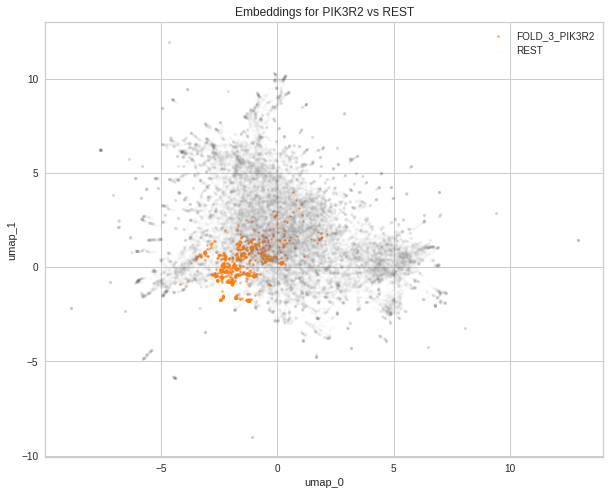

 71%|███████▏  | 30/42 [00:07<00:02,  4.19it/s]

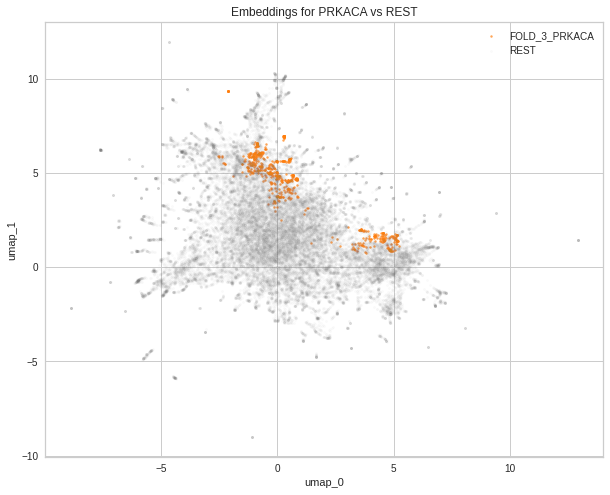

 74%|███████▍  | 31/42 [00:07<00:02,  4.24it/s]

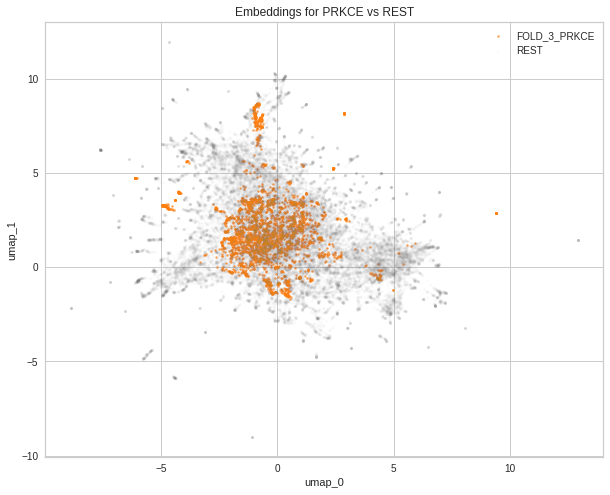

 76%|███████▌  | 32/42 [00:07<00:02,  4.26it/s]

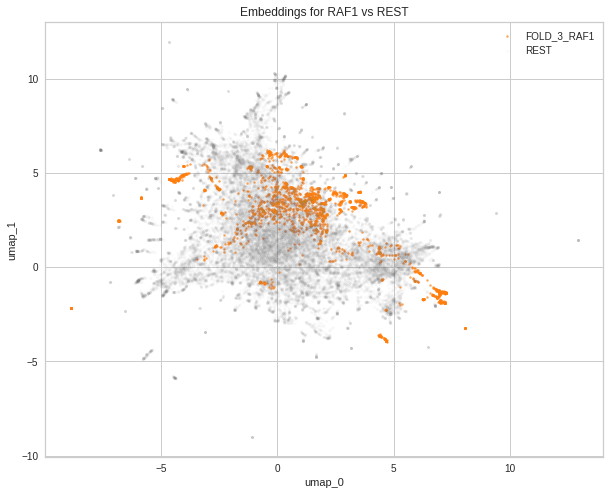

 79%|███████▊  | 33/42 [00:08<00:02,  4.27it/s]

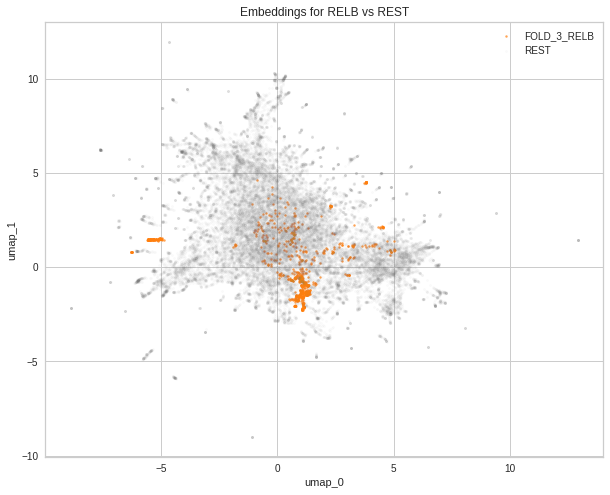

 81%|████████  | 34/42 [00:08<00:01,  4.30it/s]

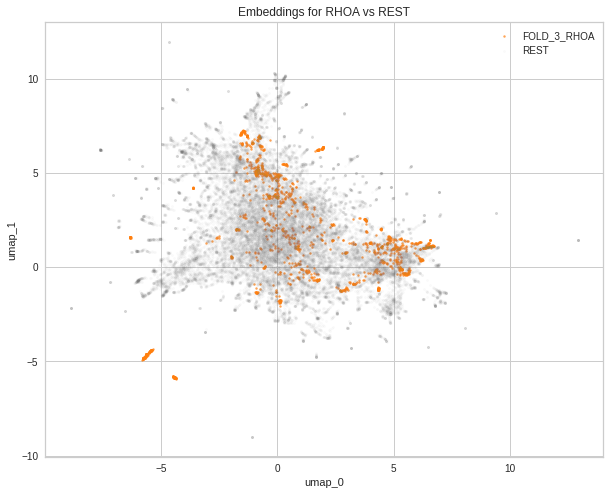

 83%|████████▎ | 35/42 [00:08<00:01,  4.31it/s]

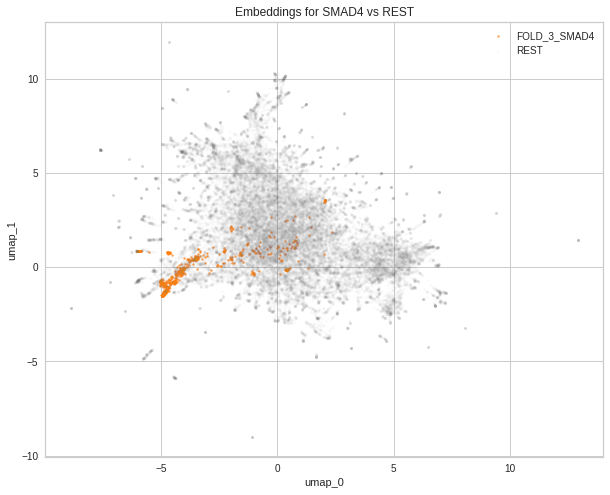

 86%|████████▌ | 36/42 [00:08<00:01,  4.32it/s]

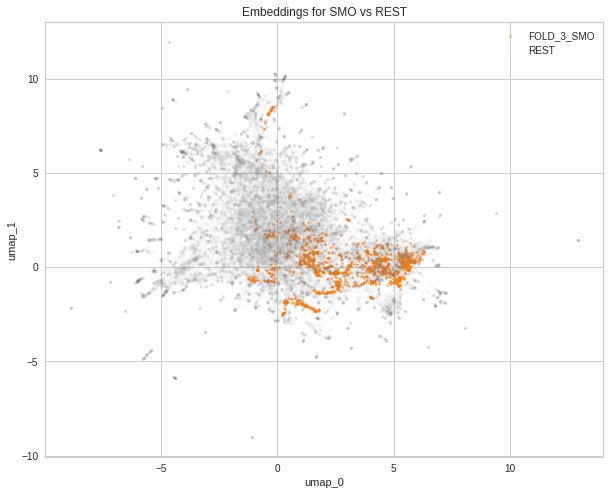

 88%|████████▊ | 37/42 [00:08<00:01,  4.35it/s]

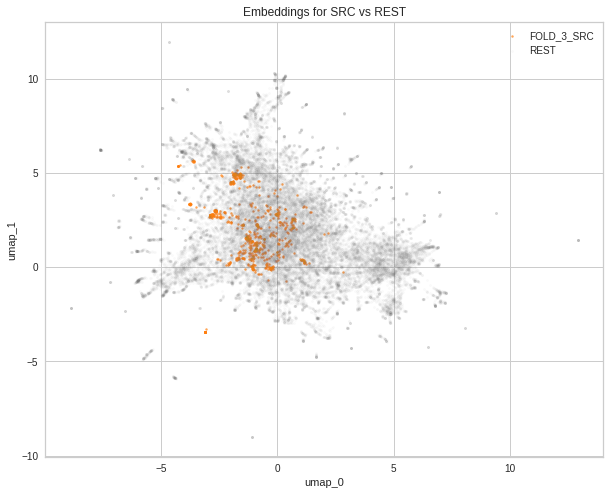

 90%|█████████ | 38/42 [00:09<00:00,  4.35it/s]

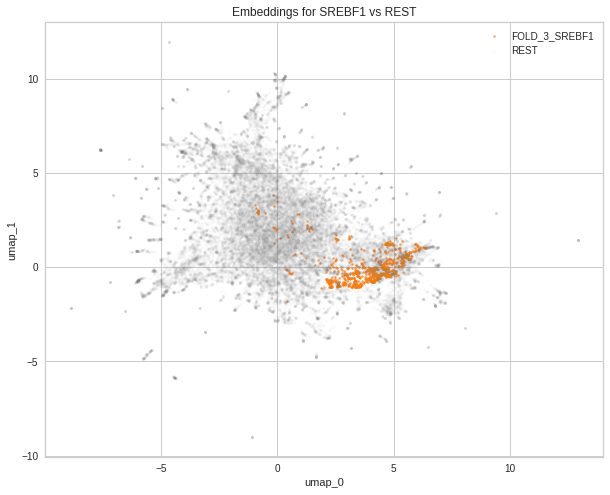

 93%|█████████▎| 39/42 [00:09<00:00,  4.36it/s]

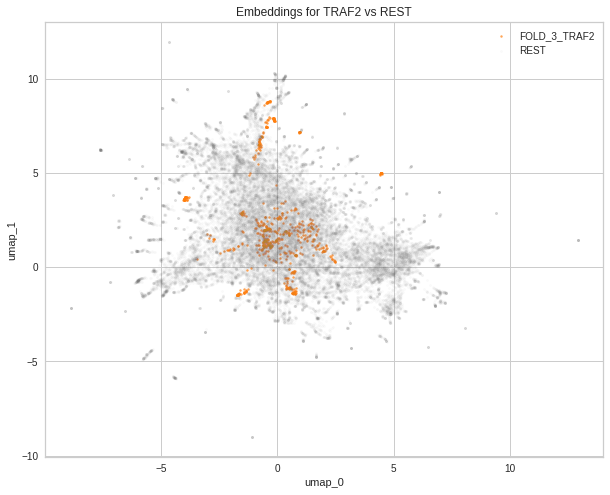

 95%|█████████▌| 40/42 [00:09<00:00,  4.35it/s]

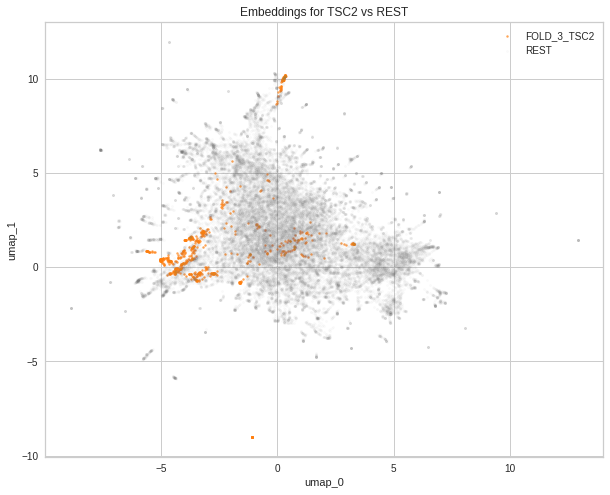

 98%|█████████▊| 41/42 [00:09<00:00,  4.36it/s]

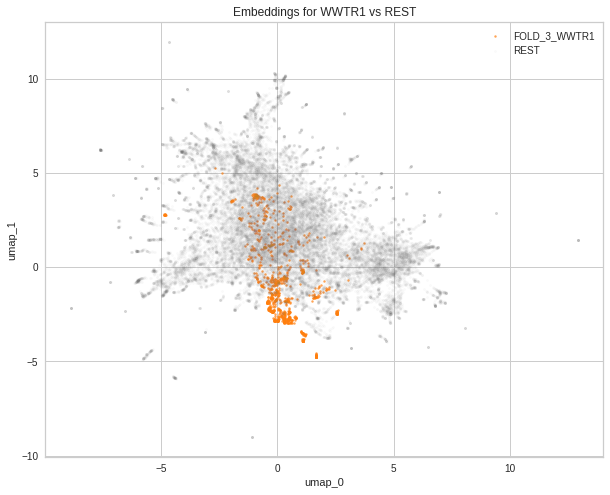

100%|██████████| 42/42 [00:10<00:00,  4.15it/s]


<IPython.core.display.Javascript object>

In [11]:
embs_3 = plot_struct_embs_cv(latents, random_state=1234, folds=["fold_3"])

---

#### 2.2.b. Gene set visualization

After having looked at each target plotted against the rest for each fold, we will have a look at the colocalization of the structural embeddings for a number of pre-defined gene sets.

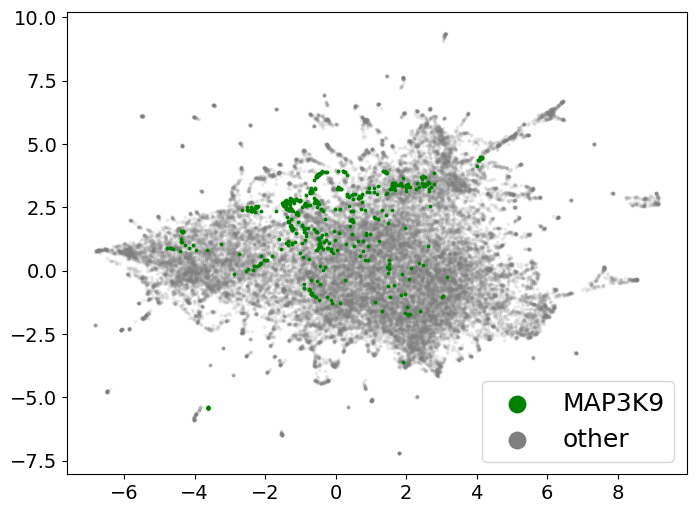

<IPython.core.display.Javascript object>

In [13]:
geneset = ["MAP3K9"]
mpl.style.use("default")
fig, ax = plt.subplots(figsize=[8, 6])
ax.scatter(
    np.array(embs_0.loc[~embs_0.label.isin(geneset), "umap_0"]),
    np.array(embs_0.loc[~embs_0.label.isin(geneset), "umap_1"]),
    c="tab:gray",
    alpha=0.1,
    label="other",
    s=3,
)
ax.scatter(
    np.array(embs_0.loc[embs_0.label.isin(geneset), "umap_0"]),
    np.array(embs_0.loc[embs_0.label.isin(geneset), "umap_1"]),
    label="MAP3K9",
    s=3,
    alpha=1,
    color="green",
)
ax.legend(loc="lower right")
handles, labels = ax.get_legend_handles_labels()
ax.legend(
    handles=list(handles)[::-1],
    labels=list(labels)[::-1],
    loc="lower right",
    prop=dict(size=18),
)
for lh in ax.get_legend().legendHandles:
    lh.set_alpha(1)
    lh._sizes = [140]
# ax.get_legend().set_title("Condition", prop={"size": "20"})
ax.get_legend().set_title("")
# ax.set_xlabel("umap_0", size=18)
# ax.set_ylabel("umap_1", size=18)
ax.set_xlabel("")
ax.set_ylabel("")
plt.xticks(size=14)
plt.yticks(size=14)
plt.show()

---

## 3. Analyses

### 3.1. Co-clustering analyses of the fold-embeddings


To quantitatively assess whether the embeddings of the different folds share a common structure, we cluster each of the inferred latent spaces corresponding to the individual folds individually using agglomerative clustering with average linkage applied to the Wasserstein distances of the induced cell state distributions in the different stages.

Next, we assess the co-clustering for a varying number of clusters (1-30) using the adjusted mutual information between any of the fold-specific embeddings. We expect scores close to 1 especially in proximity to the diagnol of the resulting matrices as this would indicate that the structure of which targets group together in the latent space are the similar between the different inferred latent spaces.

#### 3.1.a. Computing Wasserstein distances

For each fold we will compute a distance matrix that defines the pairwise Wasserstein-2 distances between any overexpression condition in the inferred structural space. To this end, we will use the implementation of the POT package.

##### Fold 0

In [75]:
latents_fold0 = all_latents[0].copy()
latents_fold0.loc[:, "labels"] = latents_fold0.loc[:, "labels"].map(label_dict)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [76]:
wdist_fold0 = get_emd_for_embs(embs=latents_fold0, label_col="labels")

Compute EMD: 100%|██████████| 42/42 [02:52<00:00,  4.11s/it]


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Wasserstein distance matrix of the structural space (fold 0)


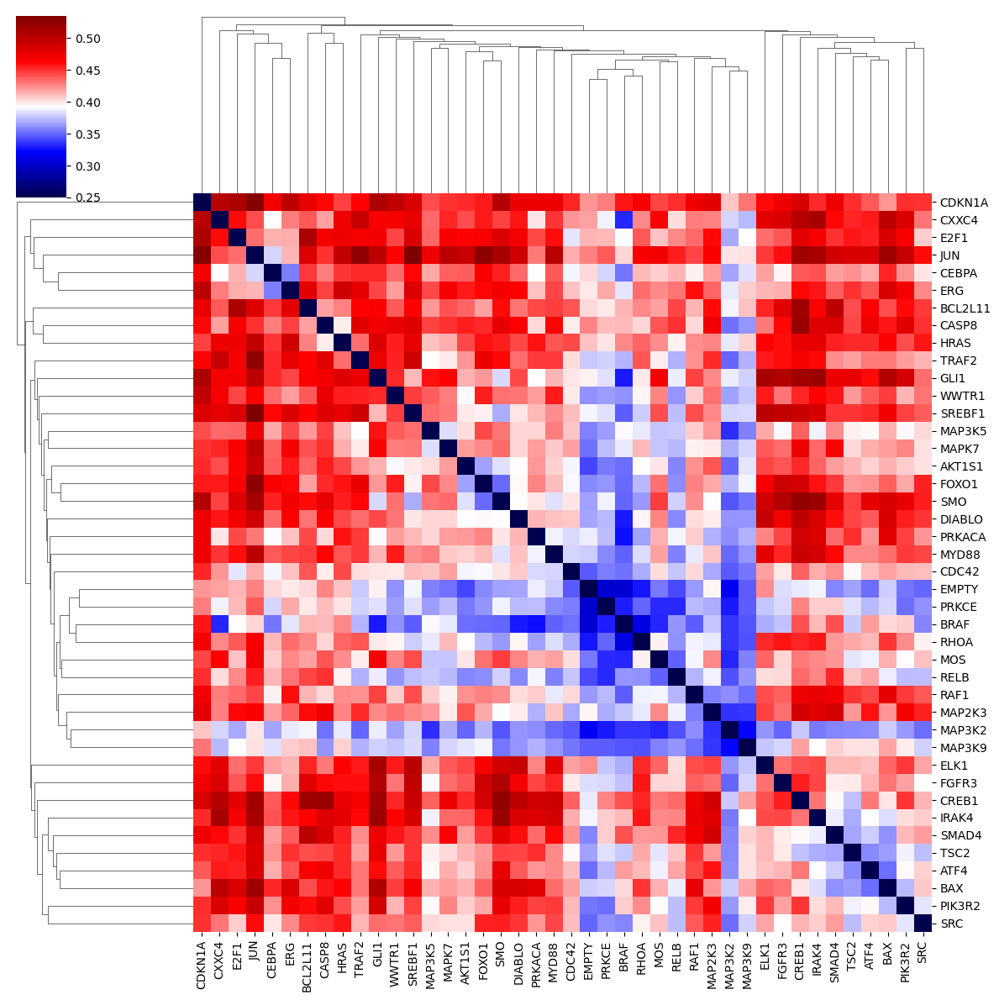

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [100]:
linkage = hc.linkage(squareform(wdist_fold0), method="average")
ax = sns.clustermap(
    wdist_fold0,
    row_linkage=linkage,
    col_linkage=linkage,
    figsize=[12, 12],
    cmap="seismic",
    vmin=0.25,
)
print("Wasserstein distance matrix of the structural space (fold 0)")
plt.show()

---

##### Fold 1

In [104]:
latents_fold1 = all_latents[1].copy()
latents_fold1.loc[:, "labels"] = latents_fold1.loc[:, "labels"].map(label_dict)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
wdist_fold1 = get_emd_for_embs(embs=latents_fold1, label_col="labels")

Compute EMD:  74%|███████▍  | 31/42 [02:40<00:29,  2.66s/it]

In [ ]:
linkage = hc.linkage(squareform(wdist_fold1), method="average")
ax = sns.clustermap(
    wdist_fold1,
    row_linkage=linkage,
    col_linkage=linkage,
    figsize=[12, 12],
    cmap="seismic",
    vmin=0.25,
)
print("Wasserstein distance matrix of the structural space (fold 1)")
plt.show()

---

##### Fold 2

In [ ]:
latents_fold2 = all_latents[2].copy()
latents_fold2.loc[:, "labels"] = latents_fold2.loc[:, "labels"].map(label_dict)

In [ ]:
wdist_fold2 = get_emd_for_embs(embs=latents_fold2, label_col="labels")

In [ ]:
linkage = hc.linkage(squareform(wdist_fold2), method="average")
ax = sns.clustermap(
    wdist_fold2,
    row_linkage=linkage,
    col_linkage=linkage,
    figsize=[12, 12],
    cmap="seismic",
    vmin=0.25,
)
print("Wasserstein distance matrix of the structural space (fold 2)")
plt.show()

---

##### Fold 3

In [ ]:
latents_fold3 = all_latents[3].copy()
latents_fold3.loc[:, "labels"] = latents_fold3.loc[:, "labels"].map(label_dict)

In [ ]:
wdist_fold3 = get_emd_for_embs(embs=latents_fold3, label_col="labels")

In [ ]:
linkage = hc.linkage(squareform(wdist_fold3), method="average")
ax = sns.clustermap(
    wdist_fold3,
    row_linkage=linkage,
    col_linkage=linkage,
    figsize=[12, 12],
    cmap="seismic",
    vmin=0.25,
)
print("Wasserstein distance matrix of the structural space (fold 3)")
plt.show()

---

#### Euclidean distance-based clustering

In [20]:
fold_latents = []
for i in range(len(all_latents)):
    fold_ls = all_latents[i].copy()
    fold_ls.loc[:, "labels"] = fold_ls.loc[:, "labels"].map(label_dict)
    fold_ls = fold_ls.groupby("labels").mean()
    fold_ls = fold_ls - fold_ls.loc["EMPTY"]
    fold_ls = fold_ls.drop(index=["EMPTY"])
    fold_latents.append(fold_ls.sort_index())

<IPython.core.display.Javascript object>

We apply clustering using the euclidean and cosine distance for average linkage.

In [21]:
avg_amis = []
names = []
for i in tqdm(range(len(fold_latents))):
    names.append("fold_{}".format(i))
    for j in range(len(fold_latents)):
        avg_amis.append(
            compute_ami_matrix(
                fold_latents[i],
                fold_latents[j],
                affinity="euclidean",
                n_max_clusters=30,
                linkage="average",
            )
        )

100%|██████████| 4/4 [01:32<00:00, 23.15s/it]


<IPython.core.display.Javascript object>

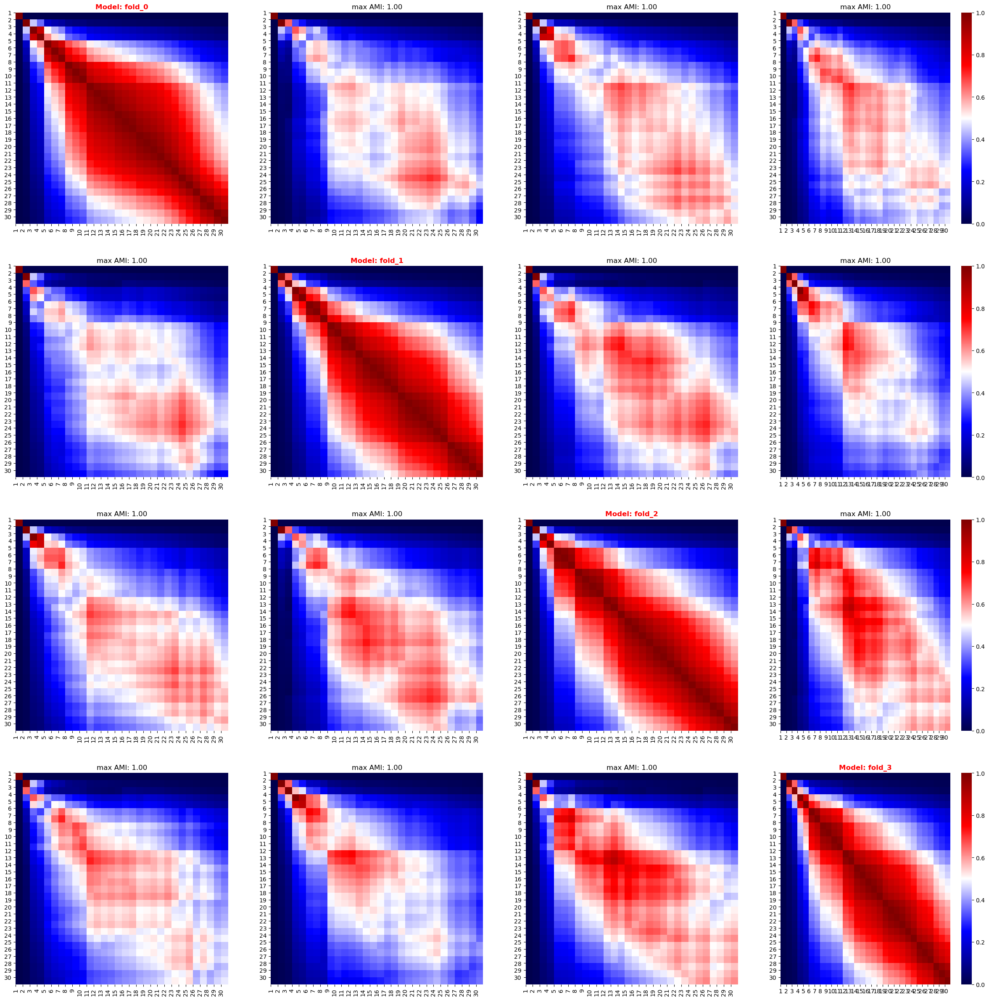

<IPython.core.display.Javascript object>

In [22]:
plot_amis_matrices(names, avg_amis)

#### Complete linkage based clustering

In [23]:
cp_amis = []
names = []
for i in tqdm(range(len(fold_latents))):
    names.append("fold_{}".format(i))
    for j in range(len(fold_latents)):
        cp_amis.append(
            compute_ami_matrix(
                fold_latents[i],
                fold_latents[j],
                affinity="euclidean",
                n_max_clusters=30,
                linkage="complete",
            )
        )

100%|██████████| 4/4 [01:33<00:00, 23.46s/it]


<IPython.core.display.Javascript object>

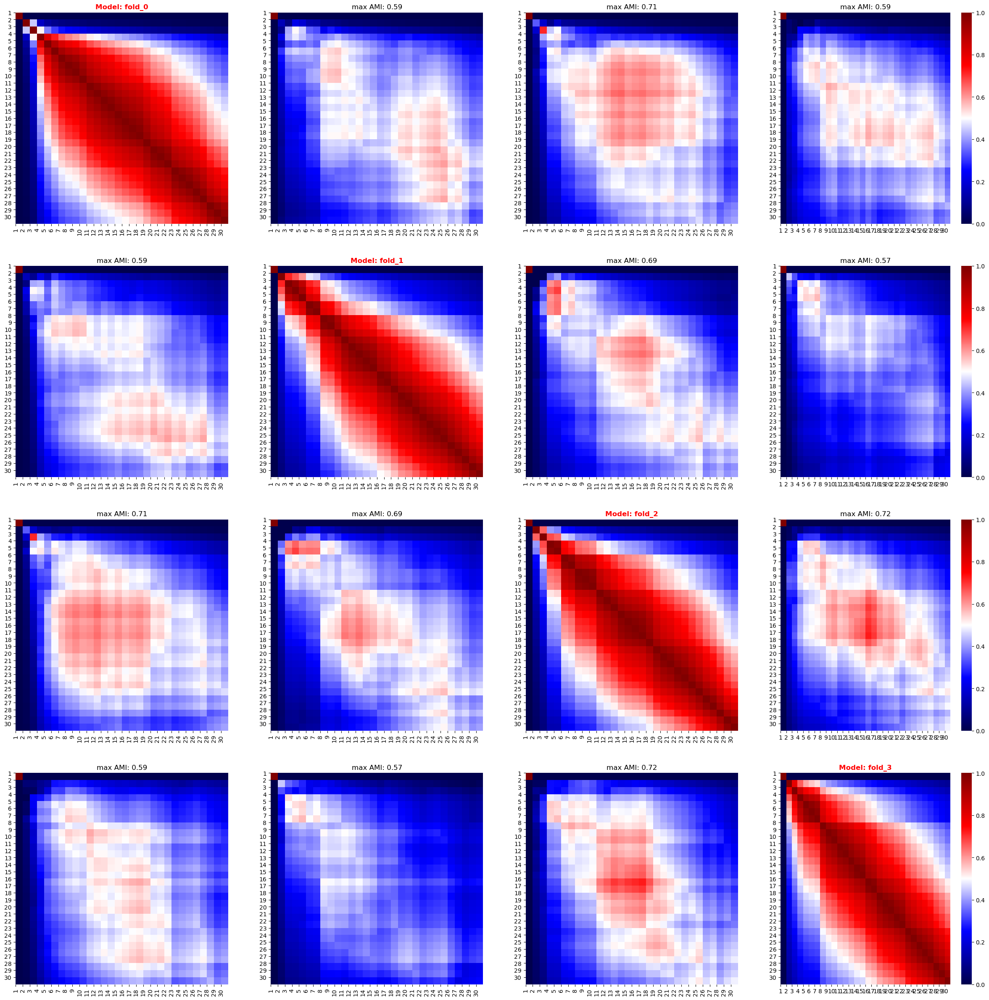

<IPython.core.display.Javascript object>

In [24]:
plot_amis_matrices(names, cp_amis)

---

### 3.2. Individual cluster analyses

After having assessed the shared structure between the different fold embeddings, we now will look at each fold individually and aim to better understand the observed cluster of those.

#### 3.2.a. Mean response clustering.

To this end, we will first cluster each fold embedding hierarchicallly using euclidean distances and average/complete linkage. We will thereby describe each gene embedding by the mean embedding of the individual cells where the corresponding gene was targeted.

---

#### Fold 0

In [25]:
fold0_latents = latents.loc[latents.fold == "fold_0"]
mean_fold0_latents = fold0_latents.groupby("labels").mean()

<IPython.core.display.Javascript object>

##### TSNE representation

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


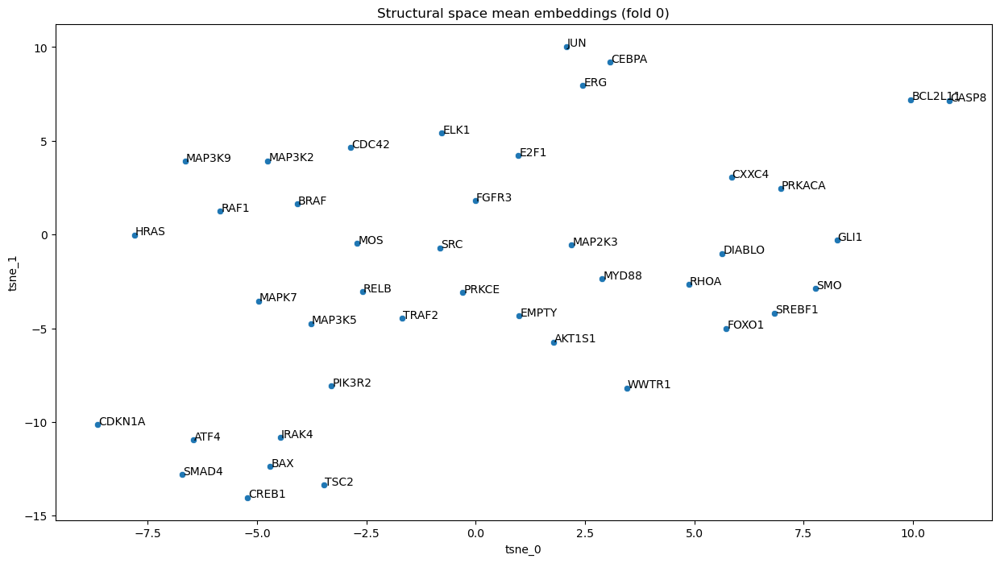

<IPython.core.display.Javascript object>

In [37]:
fig, ax = plt.subplots(figsize=[15, 8])
ax = plot_tsne_embs(mean_fold0_latents, ax=ax, perplexity=10)
ax.set_title("Structural space mean embeddings (fold 0)")
plt.show()

##### Hierarchical clustering

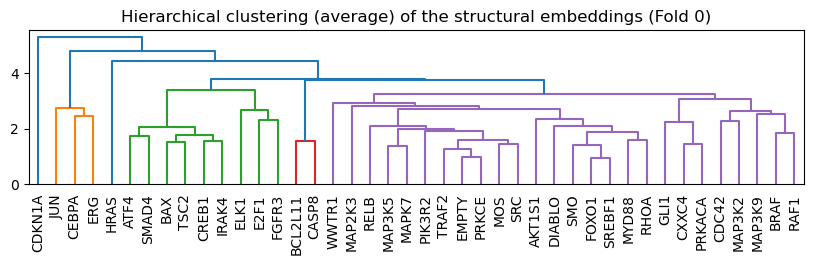

<IPython.core.display.Javascript object>

In [27]:
plot_clustertree(
    mean_fold0_latents,
    title="Hierarchical clustering (average) of the structural embeddings (Fold 0)",
    figsize=[10, 2],
)

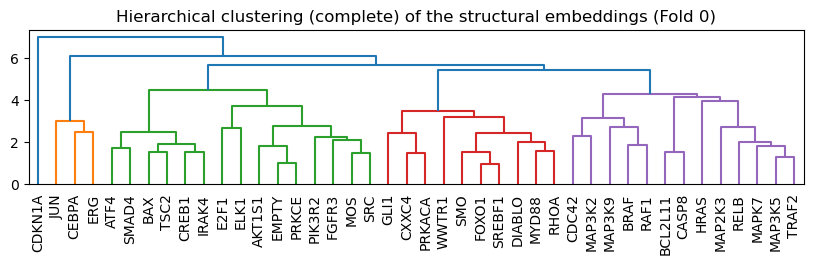

<IPython.core.display.Javascript object>

In [28]:
plot_clustertree(
    mean_fold0_latents,
    title="Hierarchical clustering (complete) of the structural embeddings (Fold 0)",
    figsize=[10, 2],
    method="complete",
)

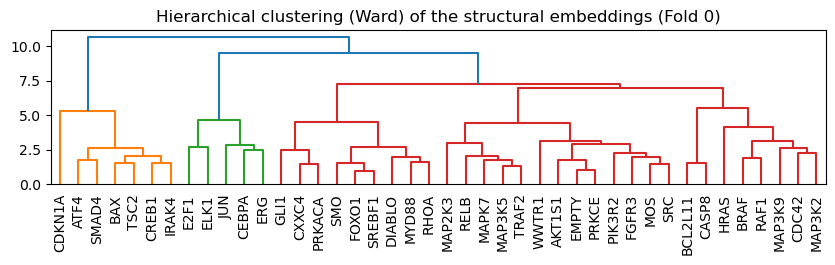

<IPython.core.display.Javascript object>

In [29]:
plot_clustertree(
    mean_fold0_latents,
    title="Hierarchical clustering (Ward) of the structural embeddings (Fold 0)",
    figsize=[10, 2],
    method="ward",
)

Using Ward linkage we will now aim to identify the optimal number of clusters. To this end, we look at three commonly considered metrics to determine the number of clusters that is the Silhouette score, the Distortion score and the Calinski-Harabasz score.

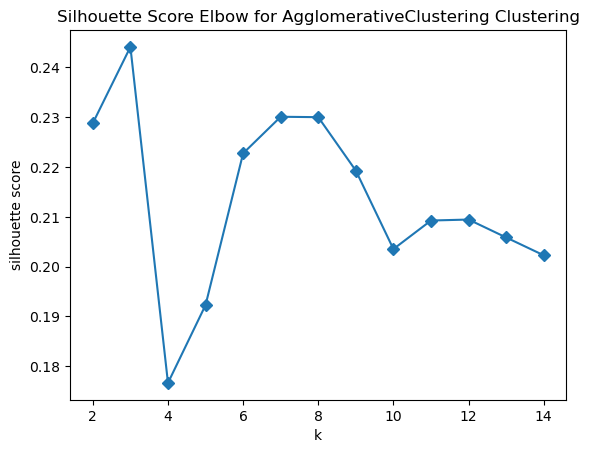

<IPython.core.display.Javascript object>

In [71]:
model = AgglomerativeClustering(linkage="ward")
# model = KMeans(random_state=1234)
visualizer = KElbowVisualizer(
    model, k=(2, 15), metric="silhouette", timings=False, locate_elbow=False
)

visualizer.fit(mean_fold0_latents)
ax = visualizer.show()

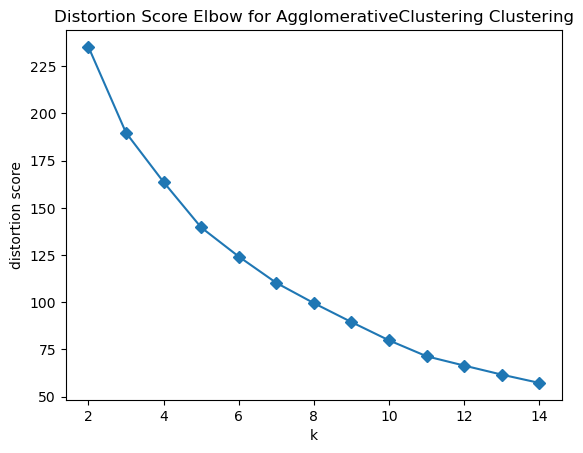

<IPython.core.display.Javascript object>

In [72]:
visualizer = KElbowVisualizer(
    model, k=(2, 15), metric="distortion", timings=False, locate_elbow=False
)

visualizer.fit(mean_fold0_latents)
ax = visualizer.show()

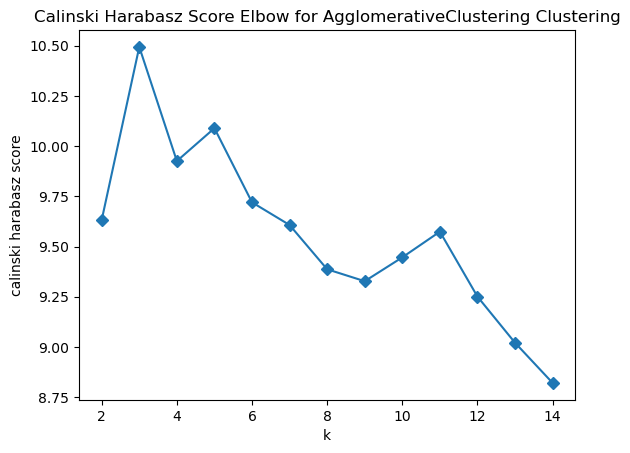

<IPython.core.display.Javascript object>

In [73]:
visualizer = KElbowVisualizer(
    model, k=(2, 15), metric="calinski_harabasz", timings=False, locate_elbow=False
)

visualizer.fit(mean_fold0_latents)
ax = visualizer.show()

We see that the optimum for the Silhoeutte score is reached at 3 clusters, which is also the maximum of the Calinski-Harabasz score. There is no clear elbow in the distortion score which is why we select three clusters as the optimal solution.

We note that genes partly group by their function, family and pathways. To quantify this we propose looking at the pairwise distances of the corresponding mean embeddings for any pair of gene targets. The plot below shows that for the distances of the mean structural embeddings for two genes is significantly larger if the two genes are not in the same pathway as opposed to the situation where they are in the same pathway. We use the KEGG pathway set to quanitfy that. The applied Mann-Withney-Wilcoxon test indicates that the two distance distribution do not differ significantly, which is a) due to the course of dimensionality and b) due to the fact that many of the KEGG pathways are relatively large which is why 730/1190 gene pairs fall within the same pathway and among those these genes share many pathways.

In [38]:
kegg_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/c2.cp.kegg.v7.5.1.symbols.gmt"
)

<IPython.core.display.Javascript object>

Note that we only consider gene targets that are part of at least one of the 184 KEGG pathways.

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

within pathways v.s. between pathways: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.602e-01 U_stat=1.760e+05


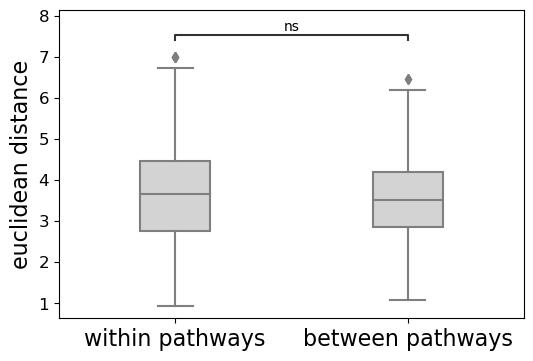

<IPython.core.display.Javascript object>

In [63]:
all_kegg_genes = []
for v in kegg_gs_dict.values():
    all_kegg_genes.extend(list(v))

within_pathway_dist = []
outside_pathway_dist = []

targets_within_kegg_pws = list(
    set(all_kegg_genes).intersection(set(list(mean_fold0_latents.index)))
)
for i in range(len(targets_within_kegg_pws)):
    for j in range(len(targets_within_kegg_pws)):
        if i != j:
            dist = euclidean(
                np.array(mean_fold0_latents.loc[targets_within_kegg_pws[i]]).ravel(),
                np.array(mean_fold0_latents.loc[targets_within_kegg_pws[j]]).ravel(),
            )
            within_gs_dist = []
            for k, v in kegg_gs_dict.items():
                if targets_within_kegg_pws[i] in v and targets_within_kegg_pws[j] in v:
                    within_gs_dist.append(dist)
            if len(within_gs_dist) > 0:
                within_pathway_dist.append(dist)
            else:
                outside_pathway_dist.append(dist)

fig, ax = plt.subplots(figsize=[6, 4])
dist_pd = pd.DataFrame(
    np.array(within_pathway_dist + outside_pathway_dist), columns=["mean_euc_dist"]
)
dist_pd["mode"] = np.array(
    ["within pathways"] * len(within_pathway_dist)
    + ["between pathways"] * len(outside_pathway_dist)
)
ax = sns.boxplot(
    data=dist_pd, x="mode", y="mean_euc_dist", ax=ax, width=0.3, color="lightgrey"
)
add_stat_annotation(
    ax,
    data=dist_pd,
    x="mode",
    y="mean_euc_dist",
    box_pairs=[("within pathways", "between pathways")],
    test="Mann-Whitney",
    text_format="star",
    loc="inside",
)
ax.set_ylabel("euclidean distance", size=16)
plt.xticks(fontsize=16)
plt.yticks(fontsize=12)
ax.set_xlabel("")
# ax.set_title("Distances of averaged structural embeddings", size=14)
plt.show()

In [65]:
dist_pd.groupby("mode").count()

,mean_euc_dist
mode,
between pathways,460
within pathways,730


<IPython.core.display.Javascript object>

---

#### 3.2.b. KMeans-based response clustering

Inspired by the observation of an often multi-modal response in the visual embedding plots. Aquantification of the multi-modality of the embeddings is subject to future work. We will now represent each condition by 3 distinct clusters and repeat the above clustering approach using to see which genes might actually be multimodal as the centroid of the 3 kmeans clusters are more similar to one another than to those of of other OE conditions.

In [91]:
model = KMeans(n_clusters=2, random_state=seed)

<IPython.core.display.Javascript object>

#### Fold 0

In [92]:
fold0_latents = latents.loc[latents.fold == "fold_0"]
fold0_latents = add_cluster_membership(model, fold0_latents, "labels")

Add cluster memberships: 100%|██████████| 42/42 [00:42<00:00,  1.00s/it]


<IPython.core.display.Javascript object>

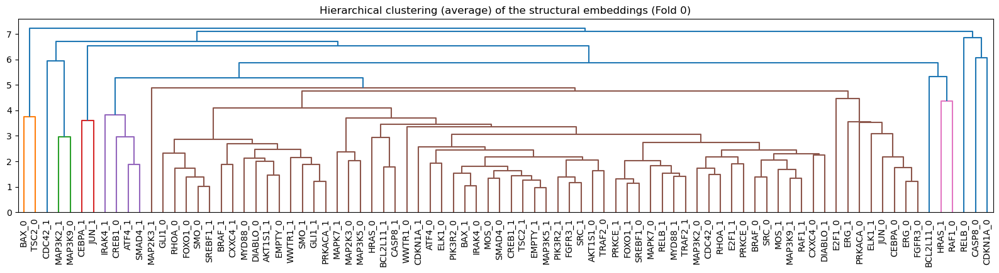

<IPython.core.display.Javascript object>

In [93]:
mean_fold0_cl_latents = fold0_latents.groupby("cluster").mean()
plot_clustertree(
    mean_fold0_cl_latents,
    title="Hierarchical clustering (average) of the structural embeddings (Fold 0)",
)

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


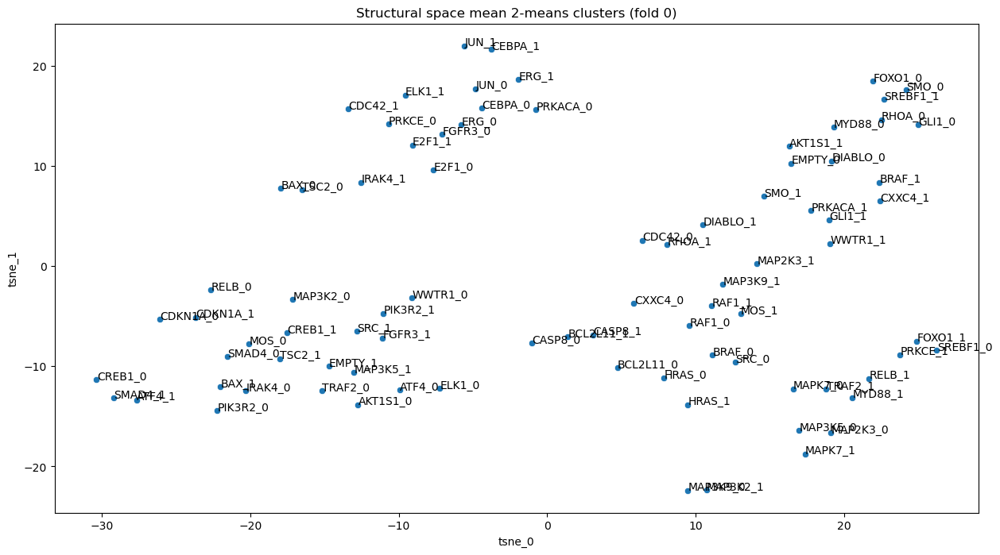

<IPython.core.display.Javascript object>

In [94]:
fig, ax = plt.subplots(figsize=[15, 8])
ax = plot_tsne_embs(mean_fold0_cl_latents, ax=ax, perplexity=7)
ax.set_title("Structural space mean 2-means clusters (fold 0)")
plt.show()

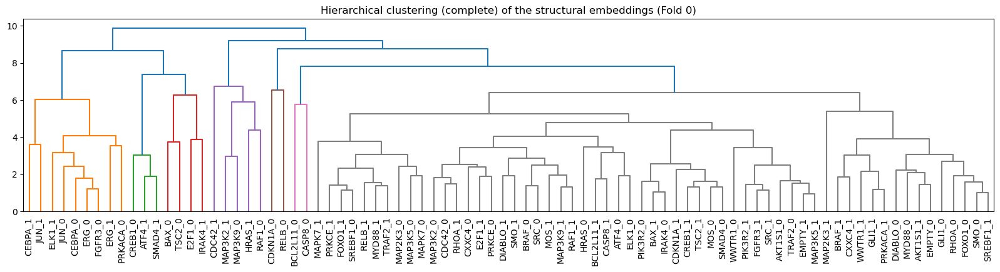

<IPython.core.display.Javascript object>

In [95]:
plot_clustertree(
    mean_fold0_cl_latents,
    title="Hierarchical clustering (complete) of the structural embeddings (Fold 0)",
    method="complete",
)

---

#### Fold 1

In [96]:
fold1_latents = latents.loc[latents.fold == "fold_1"]
fold1_latents = add_cluster_membership(model, fold1_latents, "labels")
mean_fold1_cl_latents = fold1_latents.groupby("cluster").mean()

Add cluster memberships: 100%|██████████| 42/42 [00:41<00:00,  1.01it/s]


<IPython.core.display.Javascript object>

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


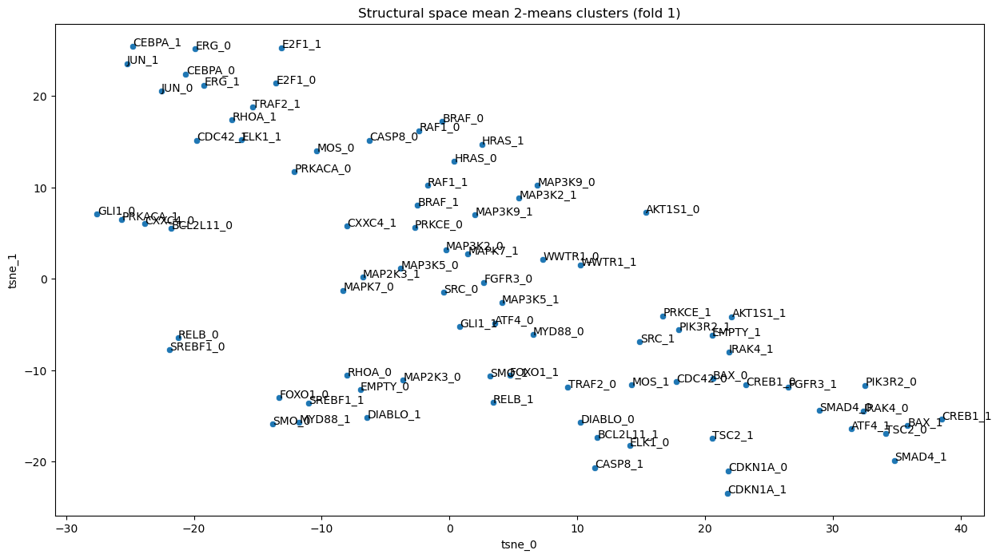

<IPython.core.display.Javascript object>

In [97]:
fig, ax = plt.subplots(figsize=[15, 8])
ax = plot_tsne_embs(mean_fold1_cl_latents, ax=ax, perplexity=7)
ax.set_title("Structural space mean 2-means clusters (fold 1)")
plt.show()

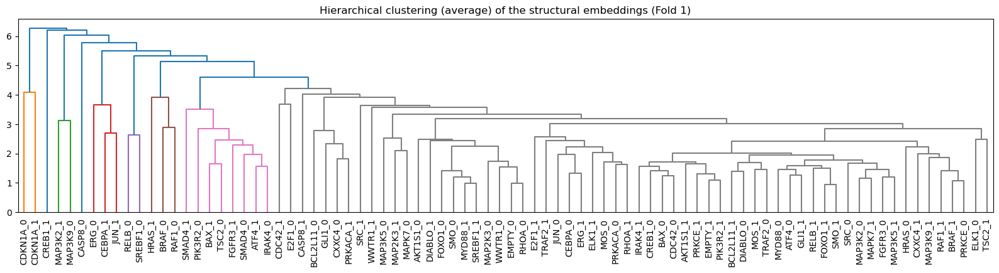

<IPython.core.display.Javascript object>

In [98]:
plot_clustertree(
    mean_fold1_cl_latents,
    title="Hierarchical clustering (average) of the structural embeddings (Fold 1)",
)

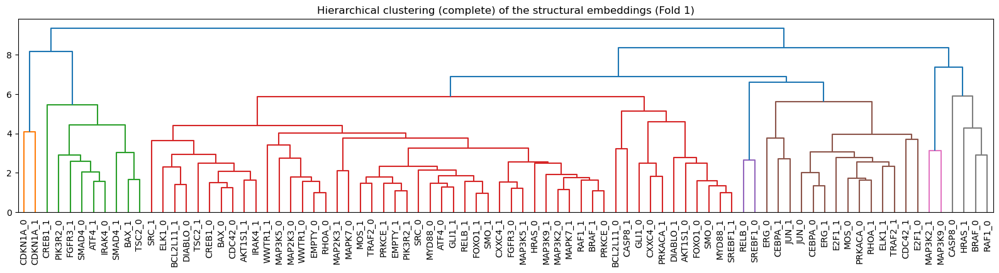

<IPython.core.display.Javascript object>

In [99]:
plot_clustertree(
    mean_fold1_cl_latents,
    title="Hierarchical clustering (complete) of the structural embeddings (Fold 1)",
    method="complete",
)

---

#### Fold 2

In [100]:
fold2_latents = latents.loc[latents.fold == "fold_2"]
fold2_latents = add_cluster_membership(model, fold2_latents, "labels")
mean_fold2_cl_latents = fold2_latents.groupby("cluster").mean()

Add cluster memberships: 100%|██████████| 42/42 [00:41<00:00,  1.00it/s]


<IPython.core.display.Javascript object>

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


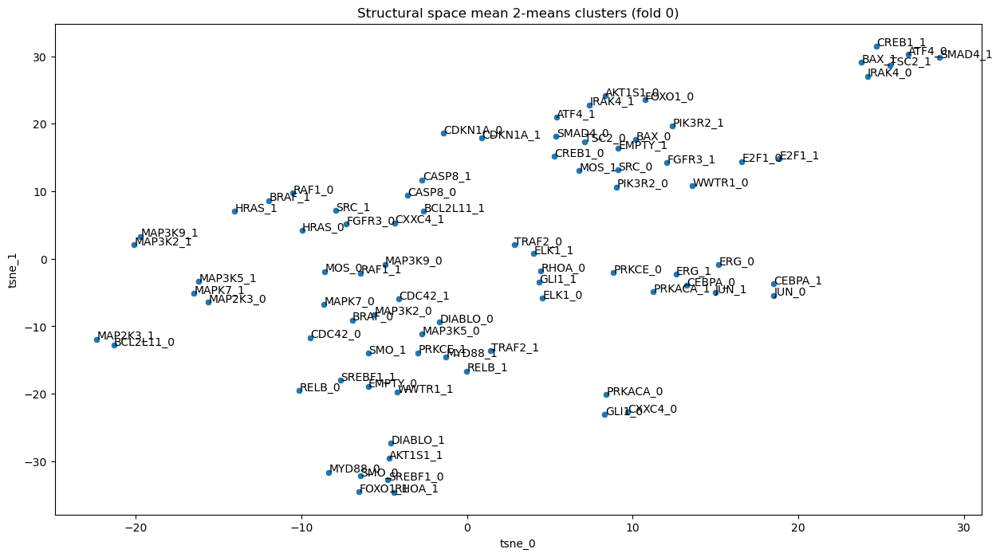

<IPython.core.display.Javascript object>

In [101]:
fig, ax = plt.subplots(figsize=[15, 8])
ax = plot_tsne_embs(mean_fold2_cl_latents, ax=ax, perplexity=7)
ax.set_title("Structural space mean 2-means clusters (fold 0)")
plt.show()

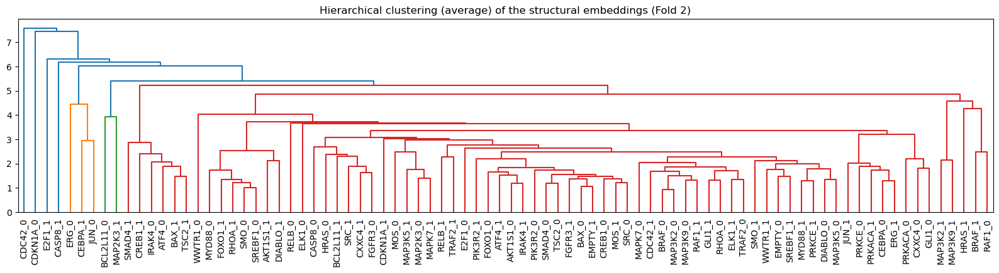

<IPython.core.display.Javascript object>

In [102]:
plot_clustertree(
    mean_fold2_cl_latents,
    title="Hierarchical clustering (average) of the structural embeddings (Fold 2)",
)

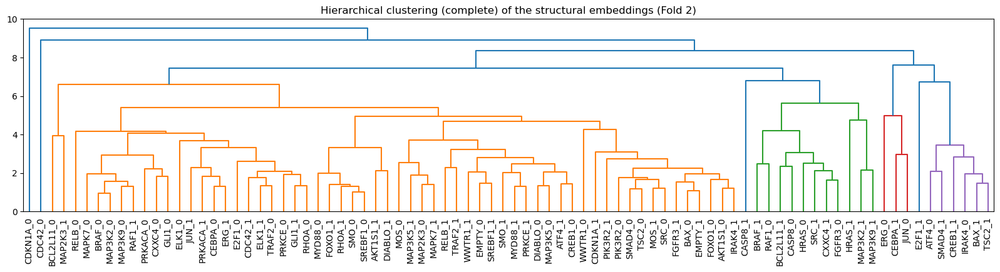

<IPython.core.display.Javascript object>

In [103]:
plot_clustertree(
    mean_fold2_cl_latents,
    title="Hierarchical clustering (complete) of the structural embeddings (Fold 2)",
    method="complete",
)

---

#### Fold 3

In [104]:
fold3_latents = latents.loc[latents.fold == "fold_3"]
fold3_latents = add_cluster_membership(model, fold3_latents, "labels")
mean_fold3_cl_latents = fold3_latents.groupby("cluster").mean()

Add cluster memberships: 100%|██████████| 42/42 [00:42<00:00,  1.02s/it]


<IPython.core.display.Javascript object>

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


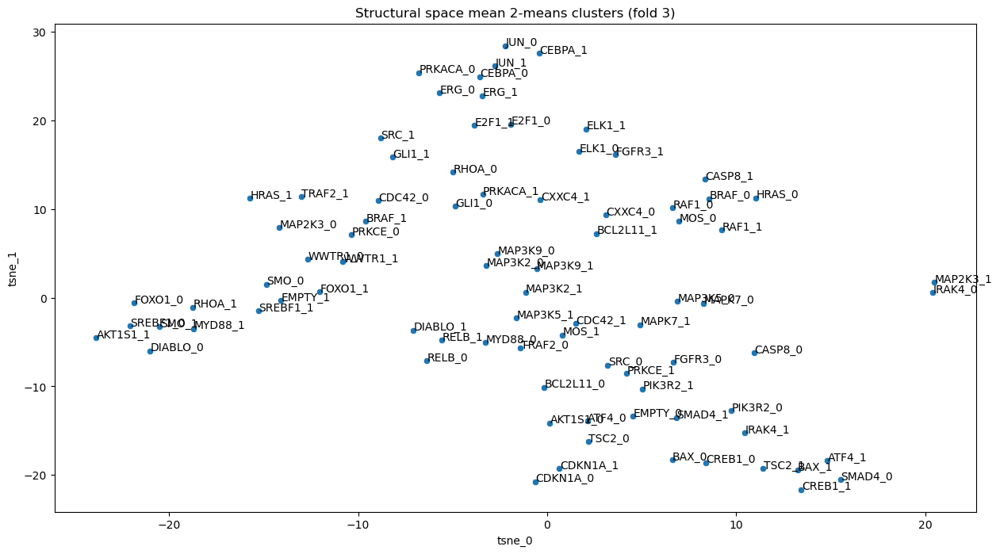

<IPython.core.display.Javascript object>

In [105]:
fig, ax = plt.subplots(figsize=[15, 8])
ax = plot_tsne_embs(mean_fold3_cl_latents, ax=ax, perplexity=7)
ax.set_title("Structural space mean 2-means clusters (fold 3)")
plt.show()

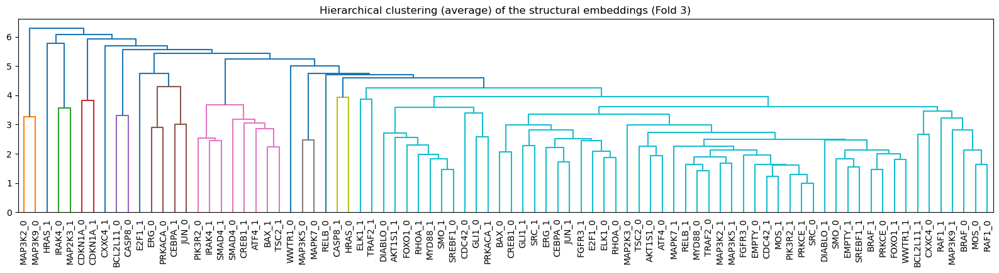

<IPython.core.display.Javascript object>

In [106]:
plot_clustertree(
    mean_fold3_cl_latents,
    title="Hierarchical clustering (average) of the structural embeddings (Fold 3)",
)

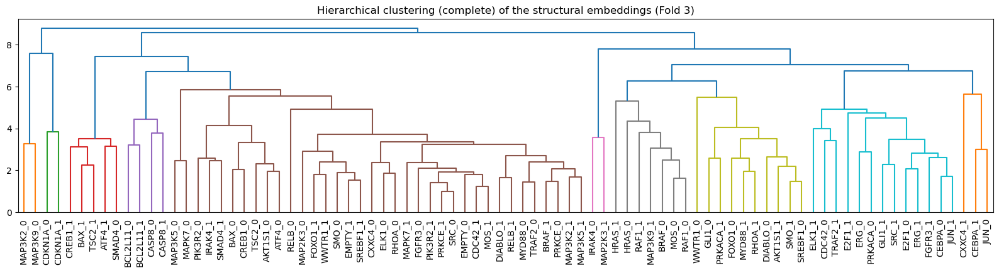

<IPython.core.display.Javascript object>

In [107]:
plot_clustertree(
    mean_fold3_cl_latents,
    title="Hierarchical clustering (complete) of the structural embeddings (Fold 3)",
    method="complete",
)

Jointly the plots again emphasize the structural differences between the individual embedding spaces. Moreover, we however see that there indeed seems to be often a multimodal response as we see rarely a co-clustering of the centroids representing the two modes of the structural response to the different OE conditions. Nonetheless, we find recurring structures as e.g. while it seems as if the response of U2OS cells to the overexpression of JUN, CEBPA and ERG is multi-modal, those induced modes seem to be fairly similar.

Inspired by these findings we suggest to represent each overexpression condition in the structural space by a number of mean embeddings representing the different modes of the structural cell state distribution that the overexpression induces in the population of U2OS cells. For simplicity, we decide to use k=10 modes to represent each gene. We add the corresponding cluster labels as before.

  0%|          | 0/42 [00:00<?, ?it/s]

AKT1S1


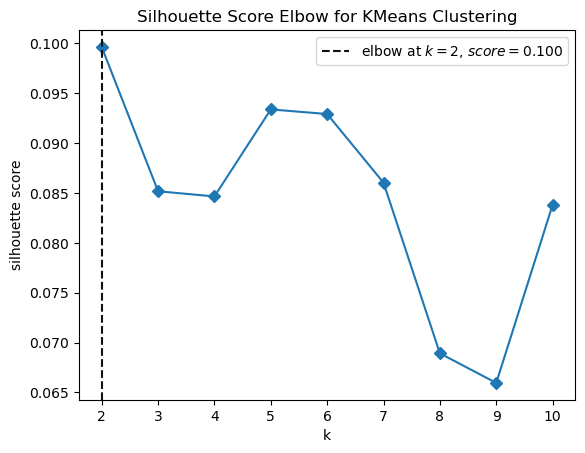

  2%|▏         | 1/42 [00:11<07:34, 11.08s/it]

ATF4


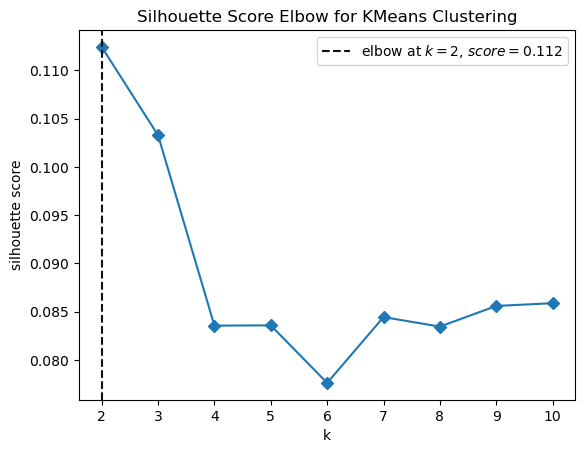

  5%|▍         | 2/42 [00:21<07:07, 10.69s/it]

BAX


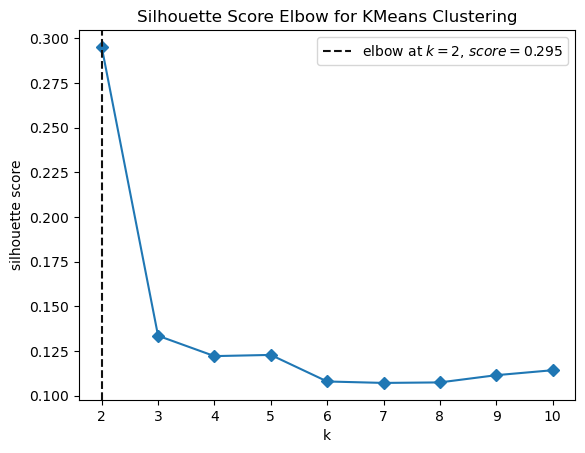

  7%|▋         | 3/42 [00:30<06:24,  9.85s/it]

BCL2L11


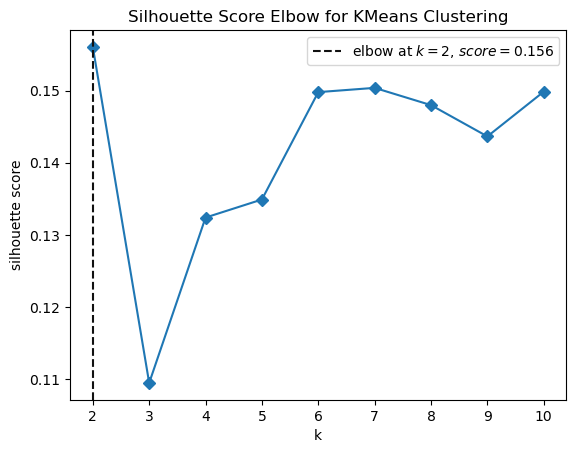

 10%|▉         | 4/42 [00:36<05:15,  8.31s/it]

BRAF


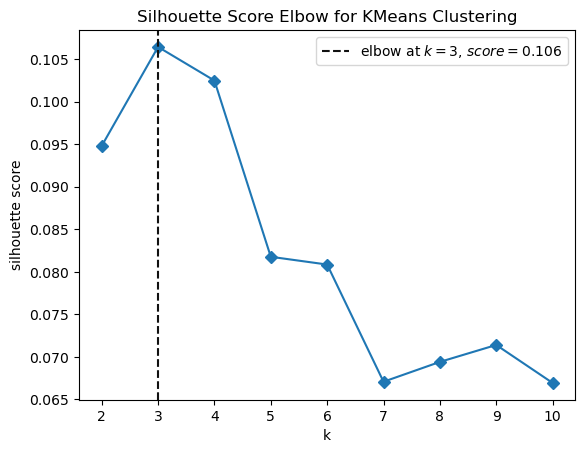

 12%|█▏        | 5/42 [00:48<05:56,  9.64s/it]

CASP8


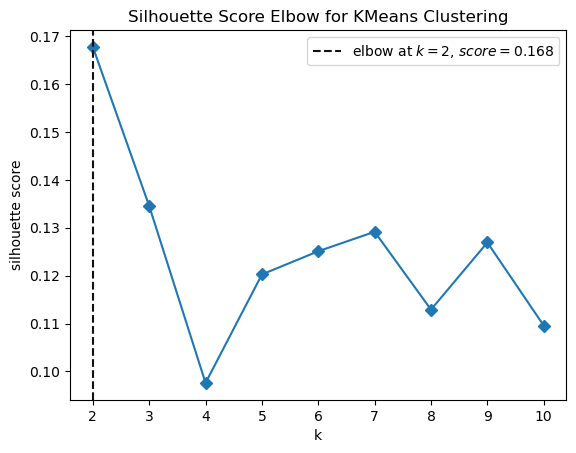

 14%|█▍        | 6/42 [00:54<05:06,  8.52s/it]

CDC42


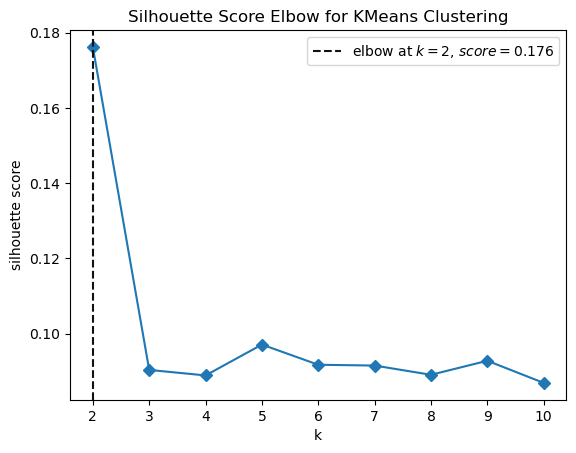

 17%|█▋        | 7/42 [01:05<05:23,  9.24s/it]

CDKN1A


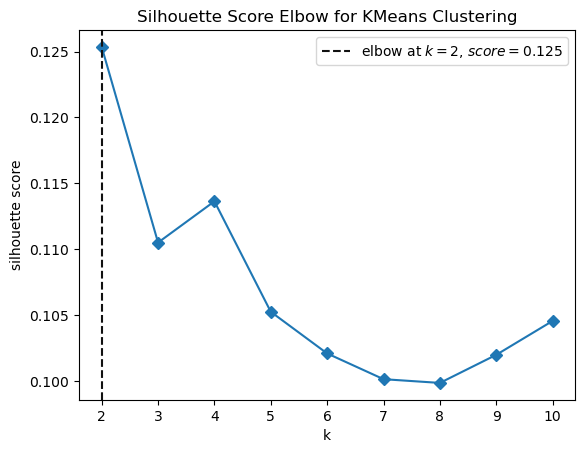

 19%|█▉        | 8/42 [01:12<04:55,  8.70s/it]

CEBPA


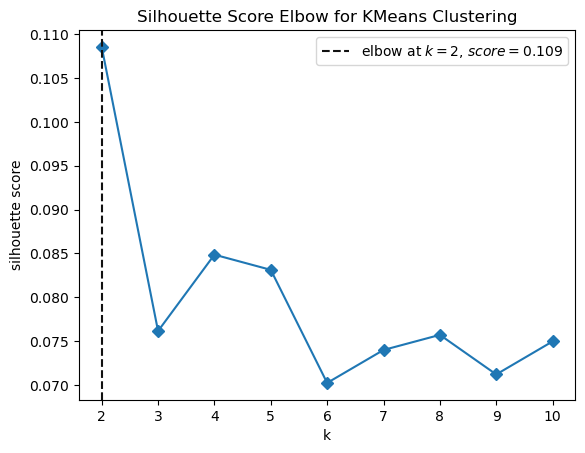

 21%|██▏       | 9/42 [01:22<04:57,  9.02s/it]

CREB1


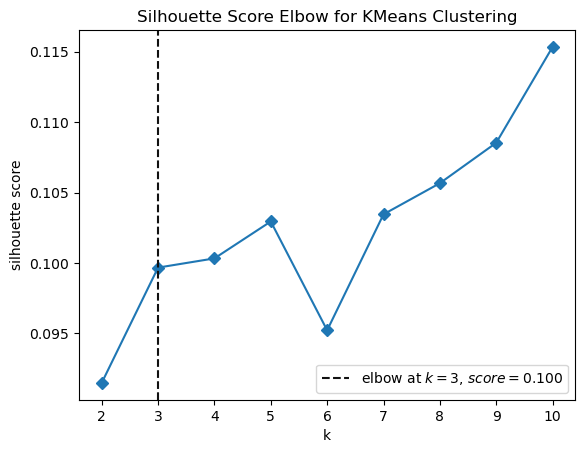

 24%|██▍       | 10/42 [01:31<04:44,  8.90s/it]

CXXC4


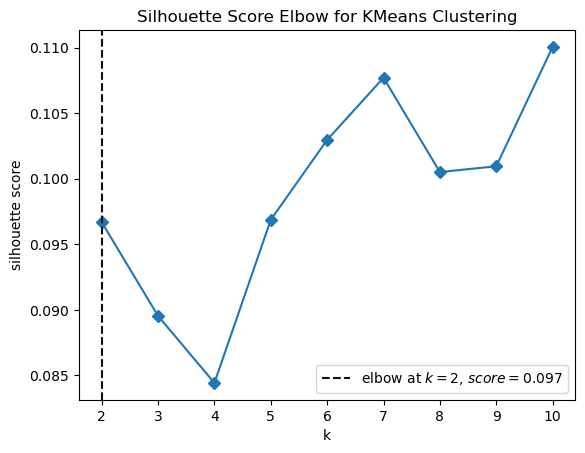

 26%|██▌       | 11/42 [01:38<04:23,  8.52s/it]

DIABLO


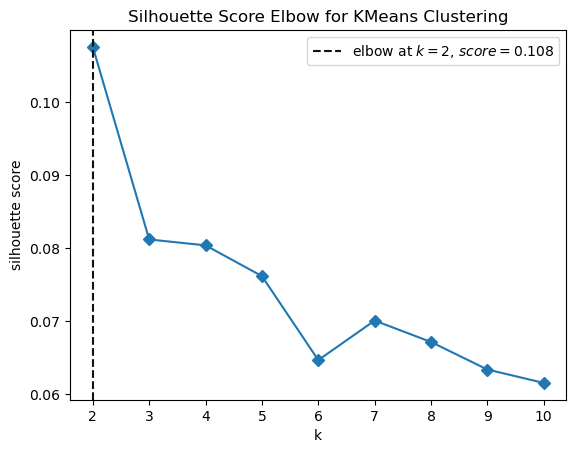

 29%|██▊       | 12/42 [01:47<04:17,  8.59s/it]

E2F1


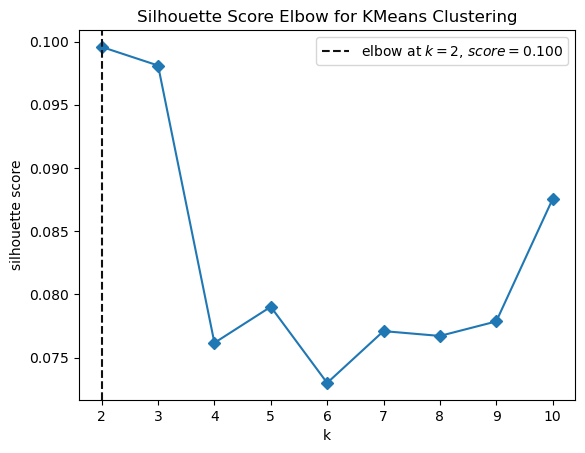

 31%|███       | 13/42 [01:57<04:18,  8.90s/it]

ELK1


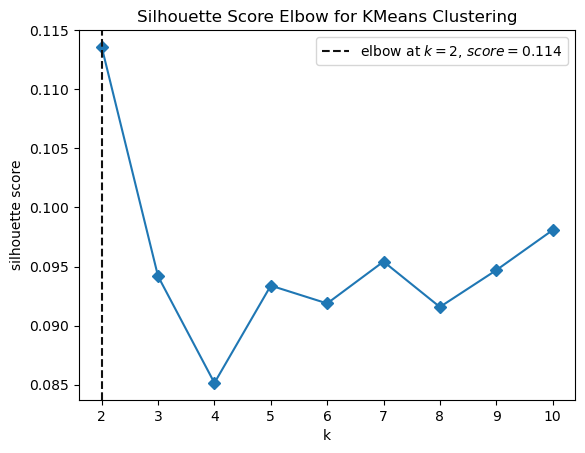

 33%|███▎      | 14/42 [02:05<04:00,  8.58s/it]

EMPTY


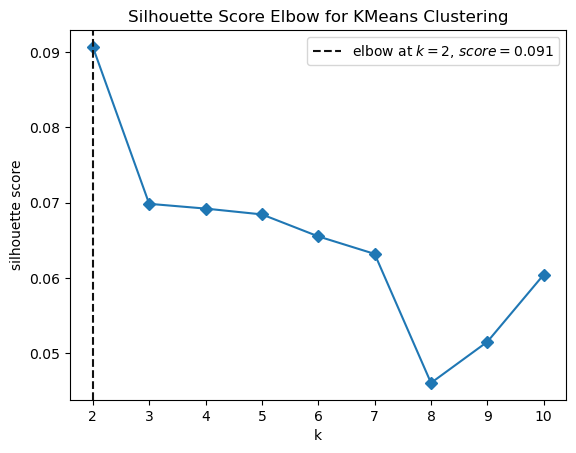

 36%|███▌      | 15/42 [02:19<04:38, 10.31s/it]

ERG


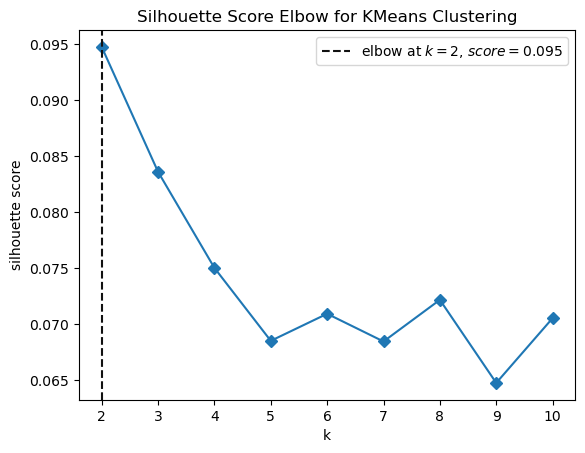

 38%|███▊      | 16/42 [02:28<04:21, 10.07s/it]

FGFR3


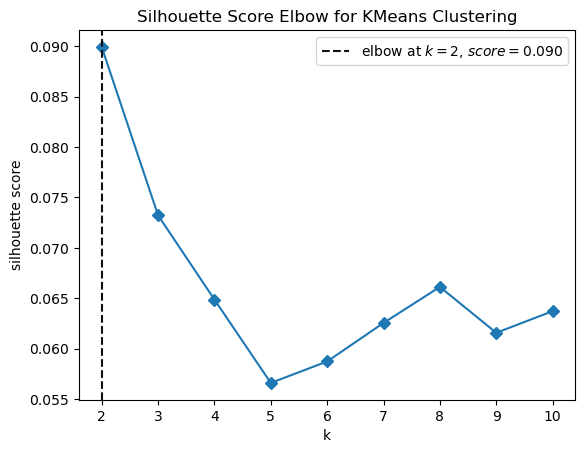

 40%|████      | 17/42 [02:38<04:06,  9.86s/it]

FOXO1


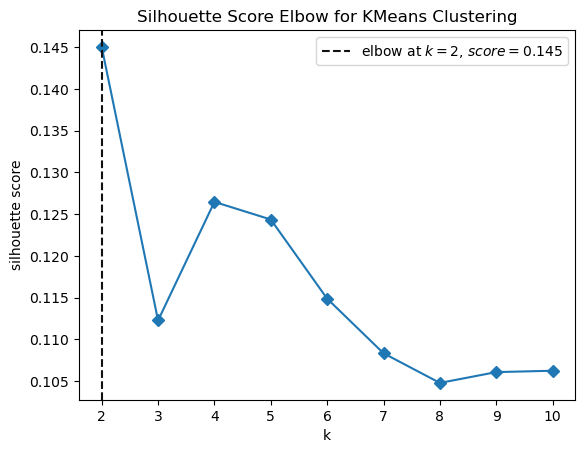

 43%|████▎     | 18/42 [02:48<03:59,  9.97s/it]

GLI1


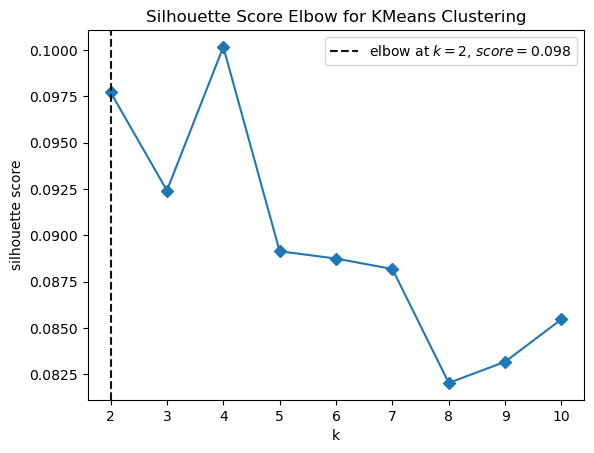

 45%|████▌     | 19/42 [02:57<03:39,  9.56s/it]

HRAS


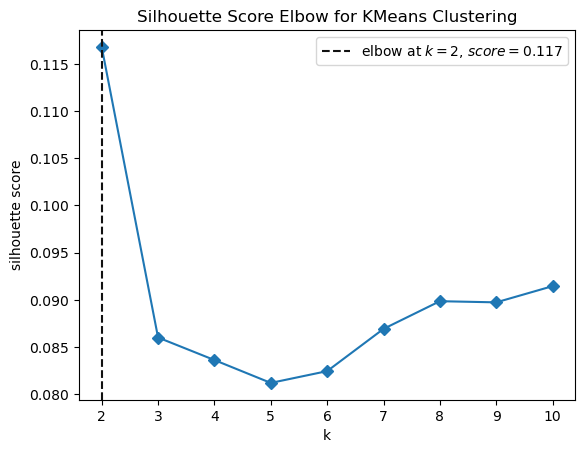

 48%|████▊     | 20/42 [03:04<03:18,  9.02s/it]

IRAK4


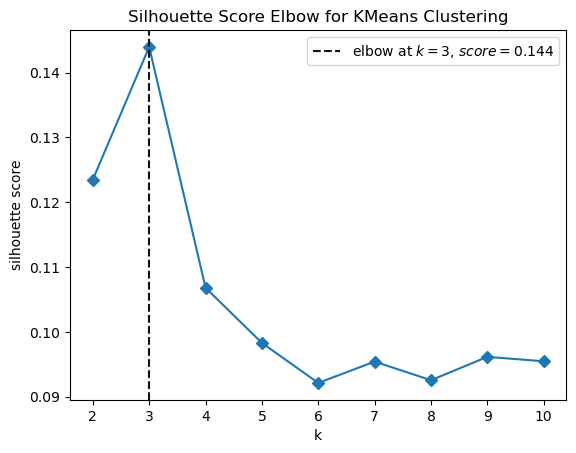

 50%|█████     | 21/42 [03:13<03:06,  8.90s/it]

JUN


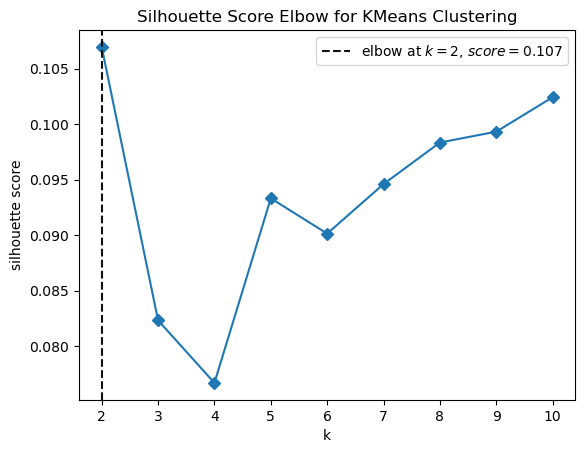

 52%|█████▏    | 22/42 [03:23<03:05,  9.27s/it]

MAP2K3


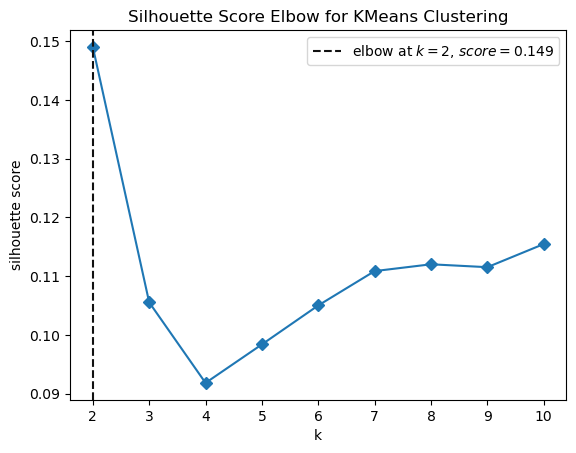

 55%|█████▍    | 23/42 [03:32<02:54,  9.16s/it]

MAP3K2


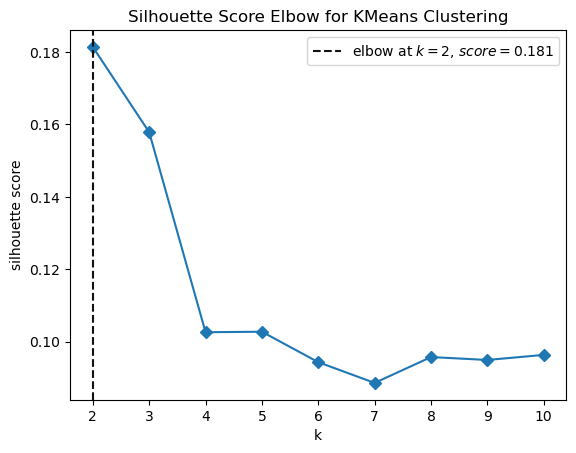

 57%|█████▋    | 24/42 [03:42<02:50,  9.46s/it]

MAP3K5


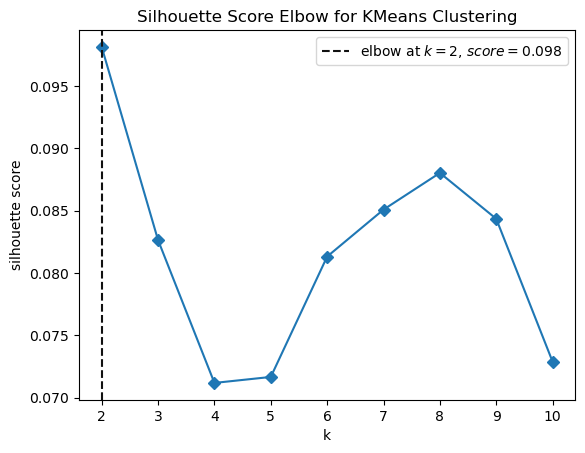

 60%|█████▉    | 25/42 [03:51<02:36,  9.21s/it]

MAP3K9


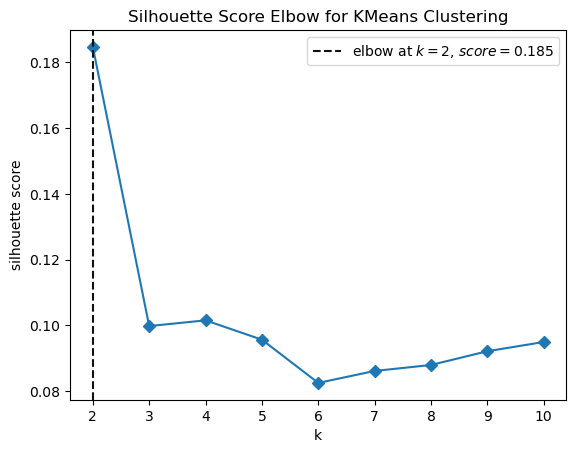

 62%|██████▏   | 26/42 [03:59<02:21,  8.86s/it]

MAPK7


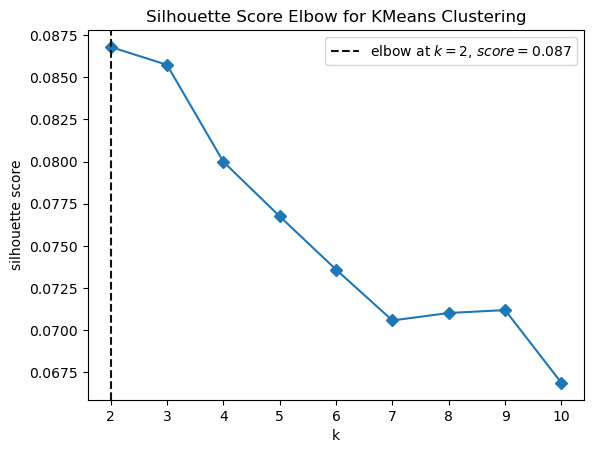

 64%|██████▍   | 27/42 [04:08<02:13,  8.88s/it]

MOS


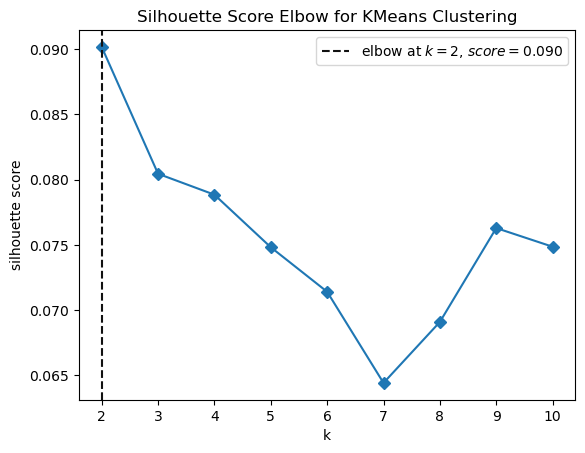

 67%|██████▋   | 28/42 [04:19<02:13,  9.52s/it]

MYD88


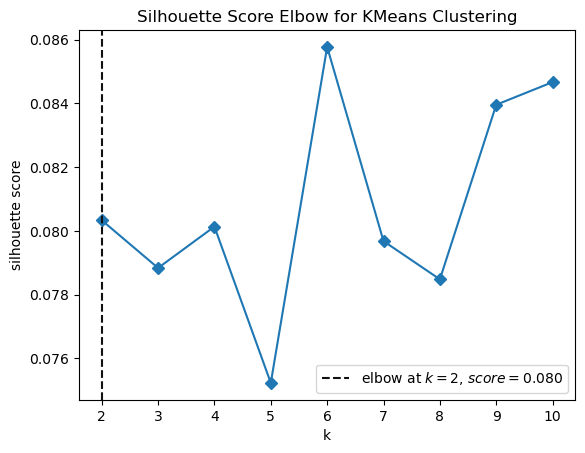

 69%|██████▉   | 29/42 [04:29<02:06,  9.74s/it]

PIK3R2


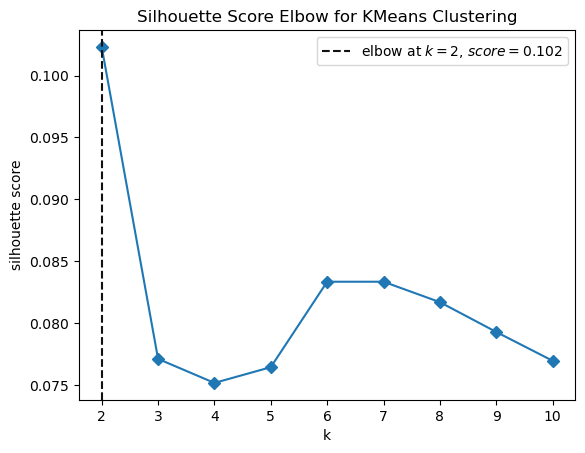

 71%|███████▏  | 30/42 [04:38<01:53,  9.49s/it]

PRKACA


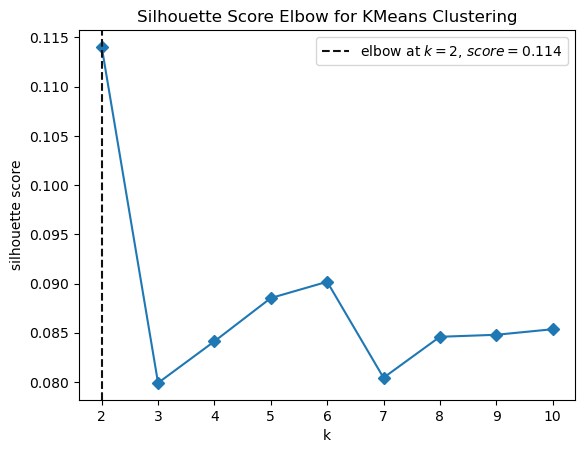

 74%|███████▍  | 31/42 [04:47<01:41,  9.23s/it]

PRKCE


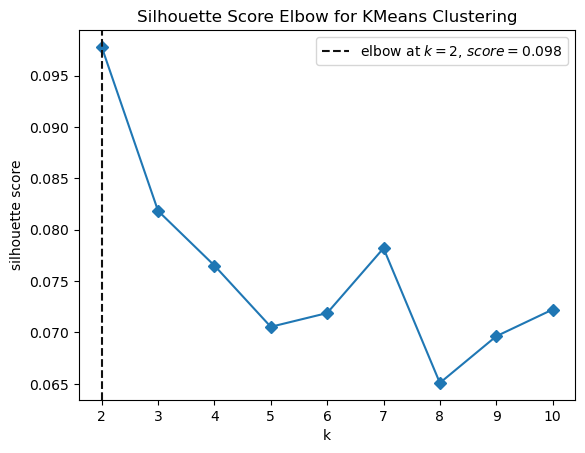

 76%|███████▌  | 32/42 [05:01<01:47, 10.72s/it]

RAF1


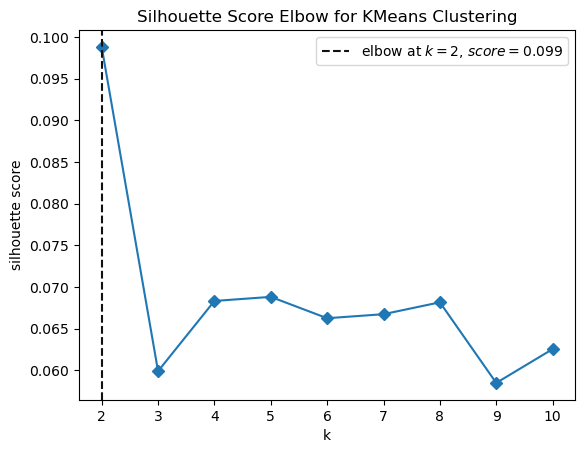

 79%|███████▊  | 33/42 [05:13<01:41, 11.23s/it]

RELB


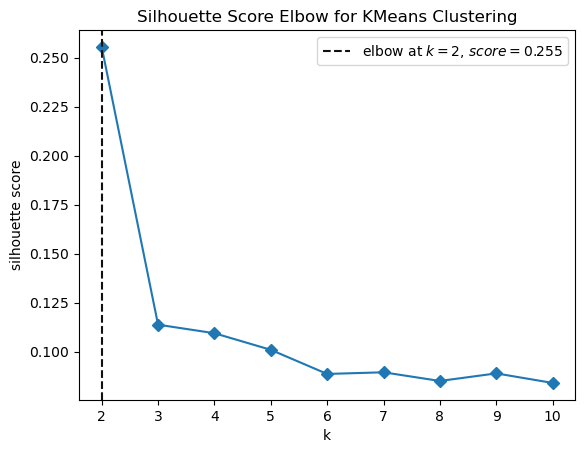

 81%|████████  | 34/42 [05:23<01:25, 10.64s/it]

RHOA


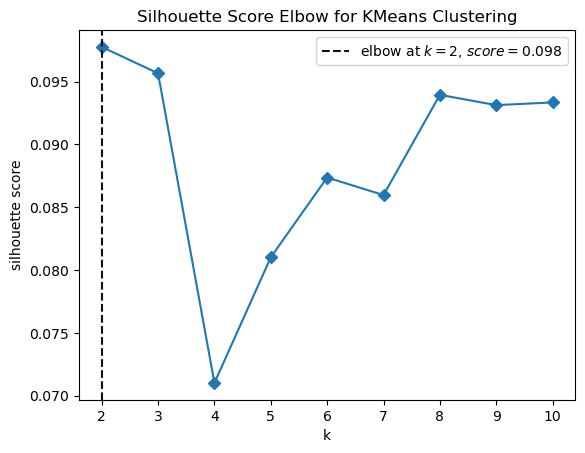

 83%|████████▎ | 35/42 [05:33<01:14, 10.63s/it]

SMAD4


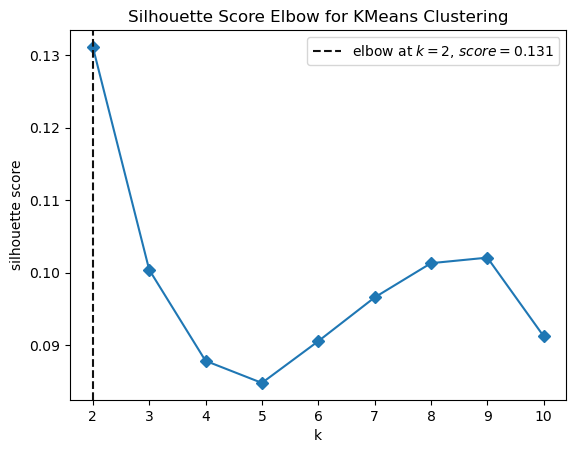

 86%|████████▌ | 36/42 [05:41<00:59,  9.96s/it]

SMO


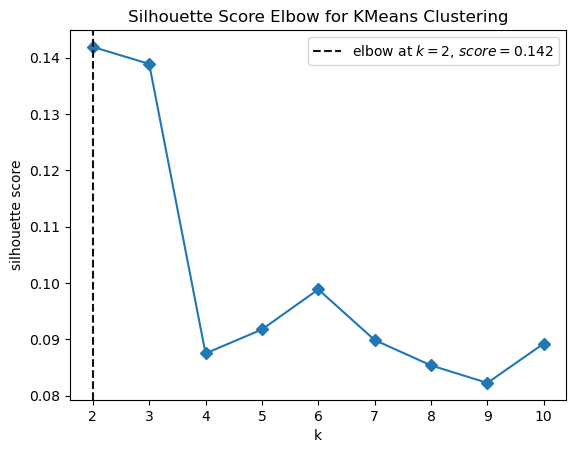

 88%|████████▊ | 37/42 [05:52<00:50, 10.12s/it]

SRC


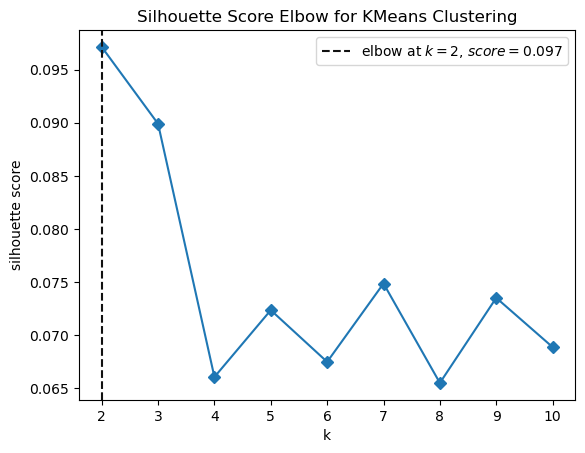

 90%|█████████ | 38/42 [06:01<00:39,  9.76s/it]

SREBF1


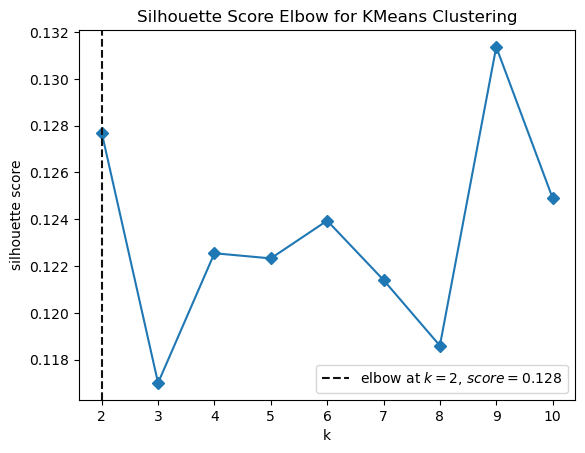

 93%|█████████▎| 39/42 [06:10<00:28,  9.54s/it]

TRAF2


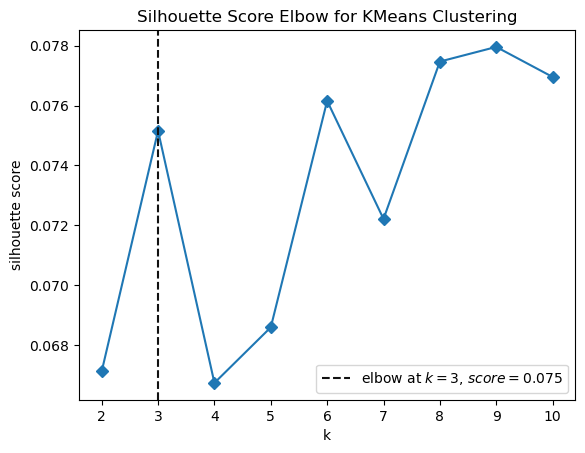

 95%|█████████▌| 40/42 [06:19<00:18,  9.30s/it]

TSC2


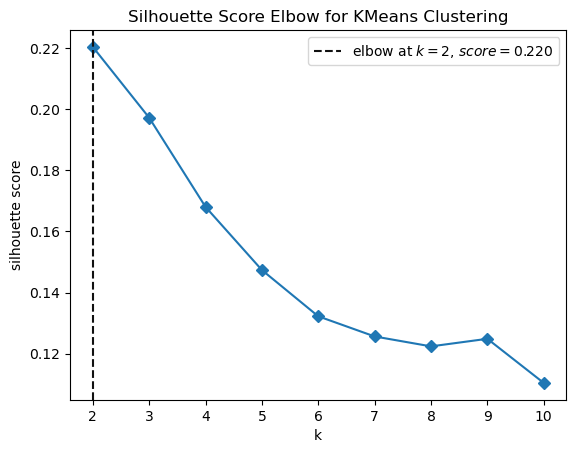

 98%|█████████▊| 41/42 [06:27<00:09,  9.07s/it]

WWTR1


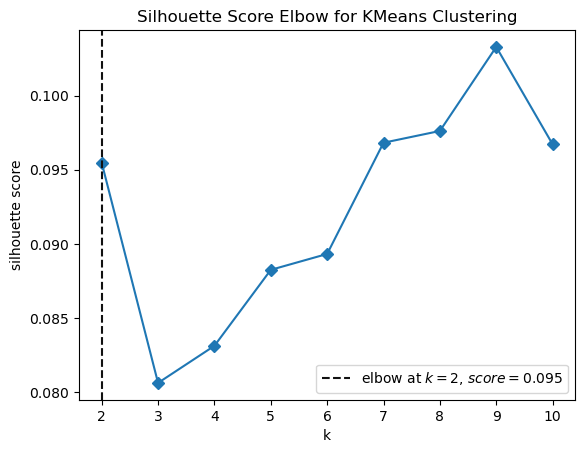

100%|██████████| 42/42 [06:37<00:00,  9.46s/it]


<IPython.core.display.Javascript object>

In [108]:
plot_clustering(fold0_latents, score="silhouette")

  0%|          | 0/42 [00:00<?, ?it/s]

AKT1S1


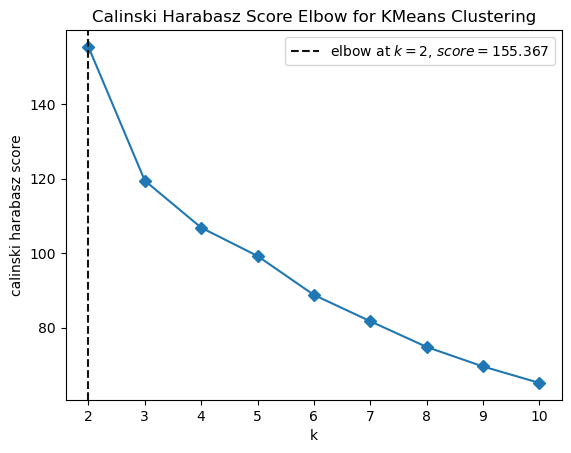

  2%|▏         | 1/42 [00:10<07:02, 10.31s/it]

ATF4


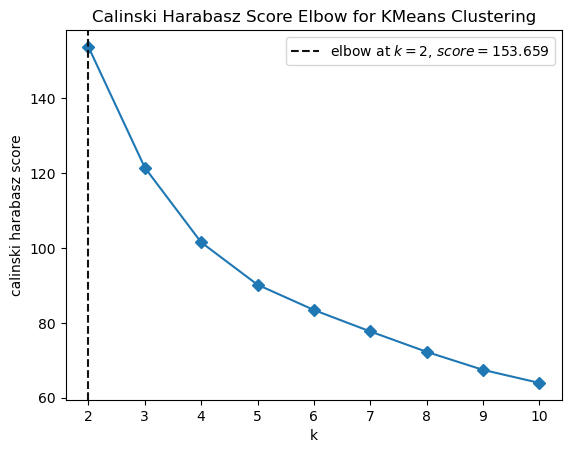

  5%|▍         | 2/42 [00:20<06:48, 10.21s/it]

BAX


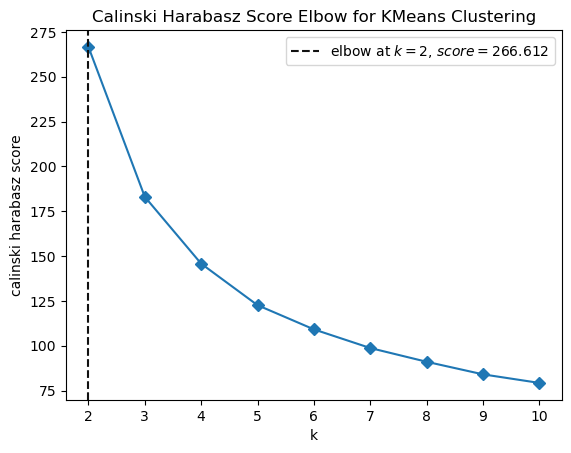

  7%|▋         | 3/42 [00:29<06:09,  9.47s/it]

BCL2L11


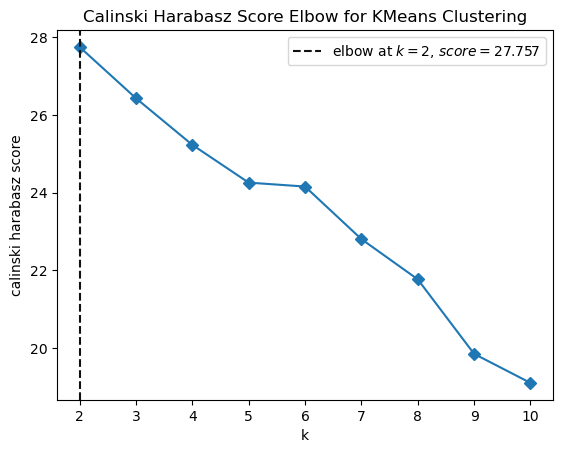

 10%|▉         | 4/42 [00:35<05:10,  8.18s/it]

BRAF


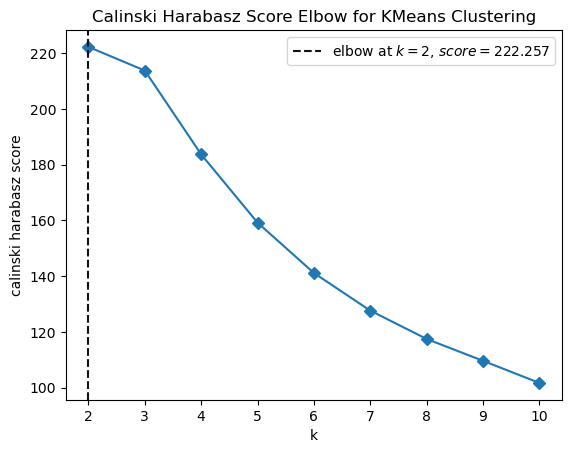

 12%|█▏        | 5/42 [00:46<05:45,  9.34s/it]

CASP8


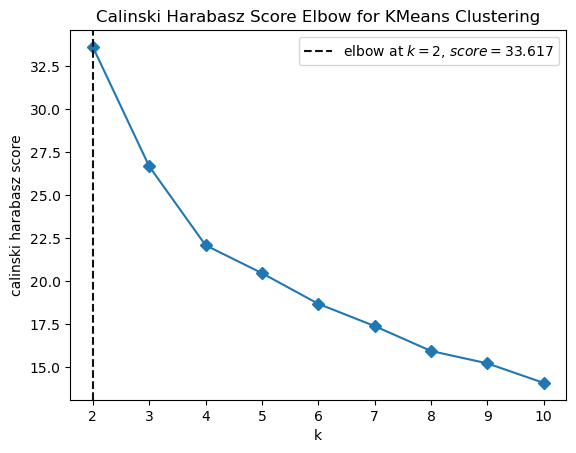

 14%|█▍        | 6/42 [00:52<04:57,  8.26s/it]

CDC42


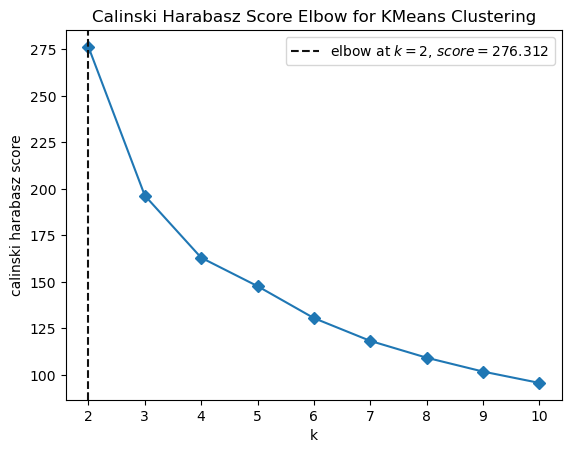

 17%|█▋        | 7/42 [01:03<05:12,  8.93s/it]

CDKN1A


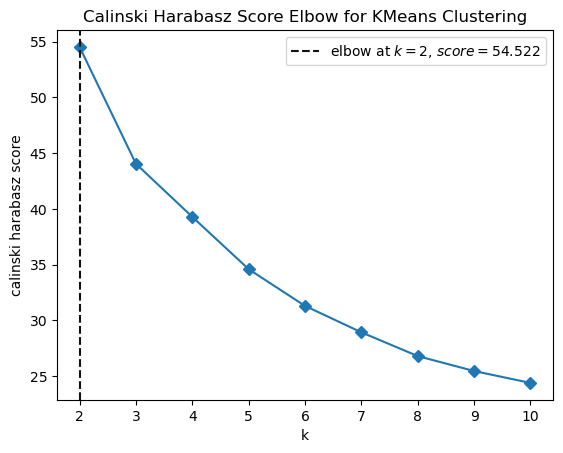

 19%|█▉        | 8/42 [01:10<04:48,  8.50s/it]

CEBPA


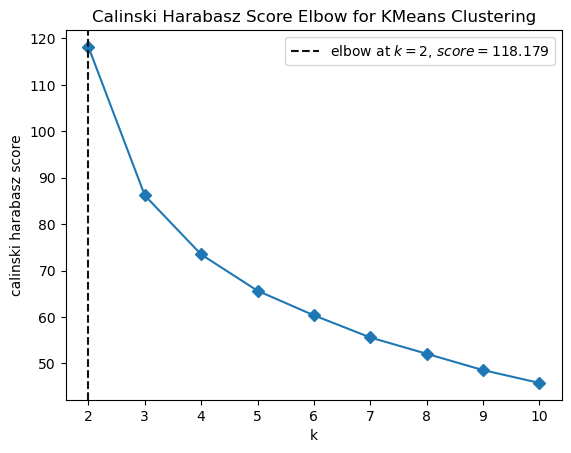

 21%|██▏       | 9/42 [01:20<04:51,  8.84s/it]

CREB1


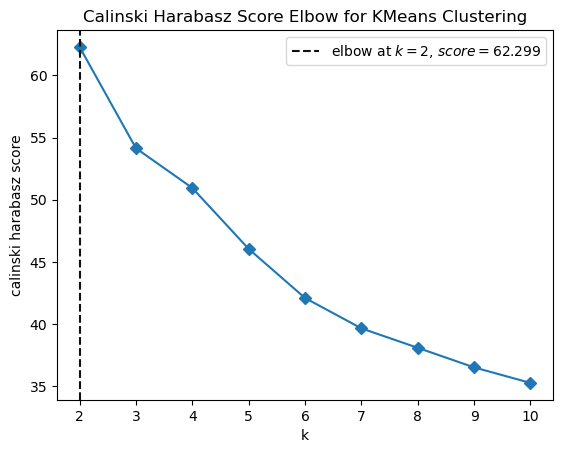

 24%|██▍       | 10/42 [01:28<04:38,  8.71s/it]

CXXC4


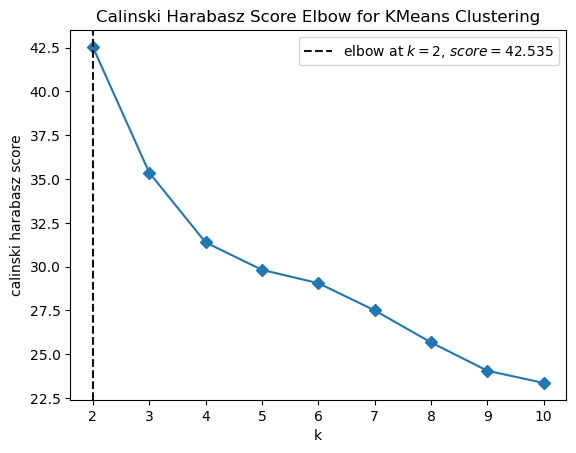

 26%|██▌       | 11/42 [01:36<04:18,  8.35s/it]

DIABLO


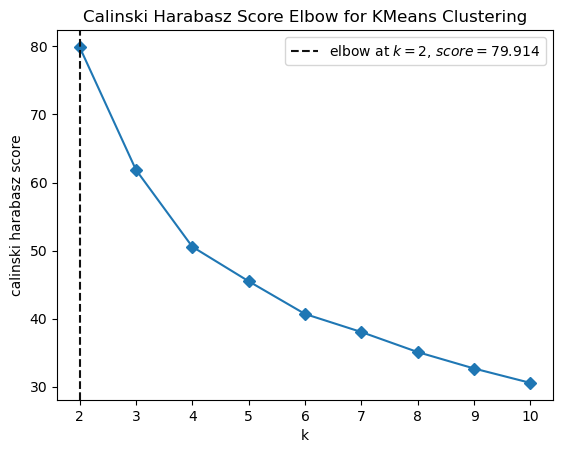

 29%|██▊       | 12/42 [01:44<04:14,  8.48s/it]

E2F1


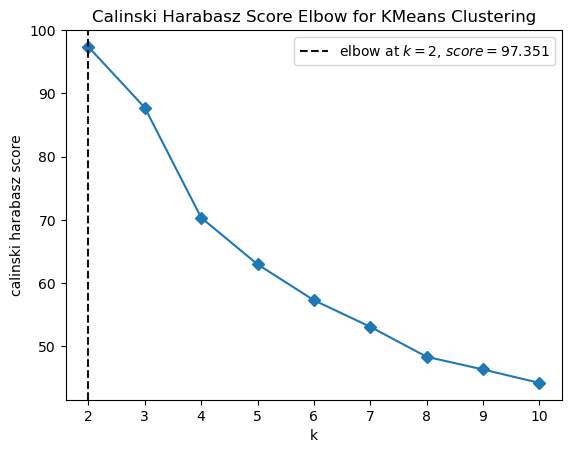

 31%|███       | 13/42 [01:54<04:12,  8.71s/it]

ELK1


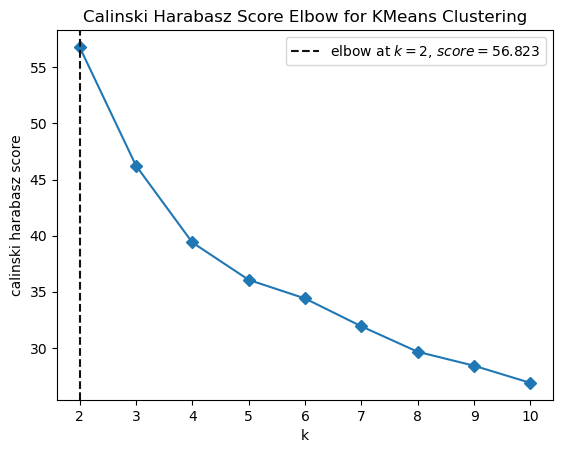

 33%|███▎      | 14/42 [02:02<03:56,  8.45s/it]

EMPTY


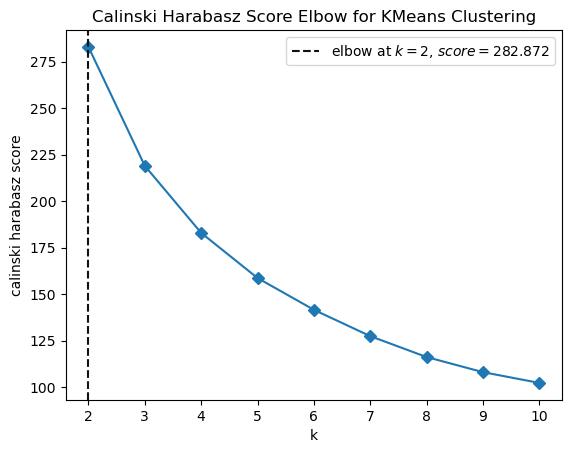

 36%|███▌      | 15/42 [02:15<04:27,  9.89s/it]

ERG


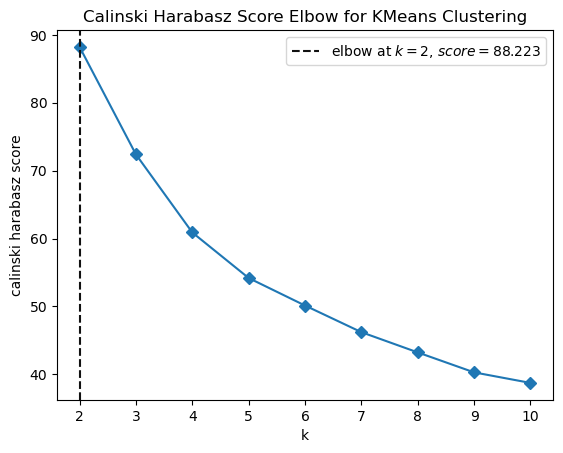

 38%|███▊      | 16/42 [02:24<04:12,  9.73s/it]

FGFR3


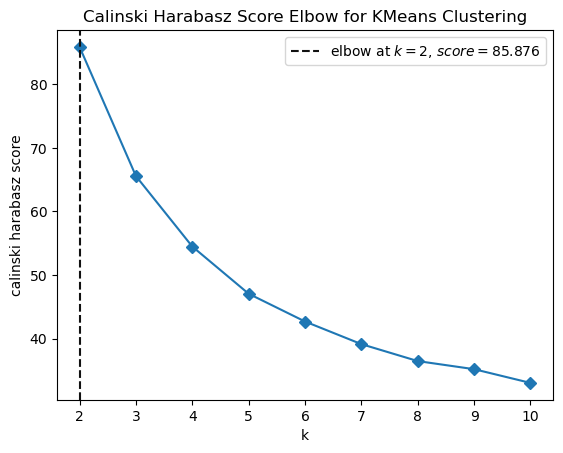

 40%|████      | 17/42 [02:34<04:01,  9.65s/it]

FOXO1


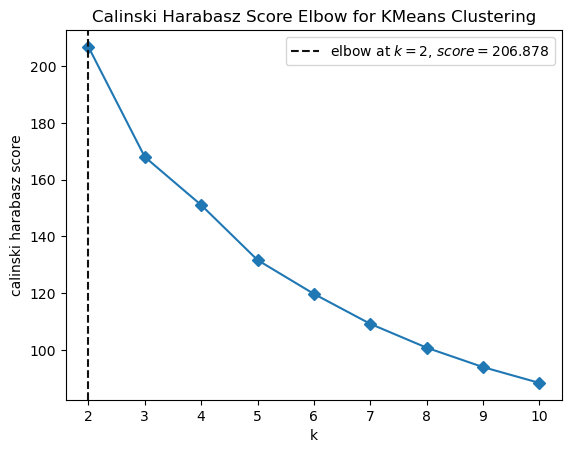

 43%|████▎     | 18/42 [02:44<03:53,  9.72s/it]

GLI1


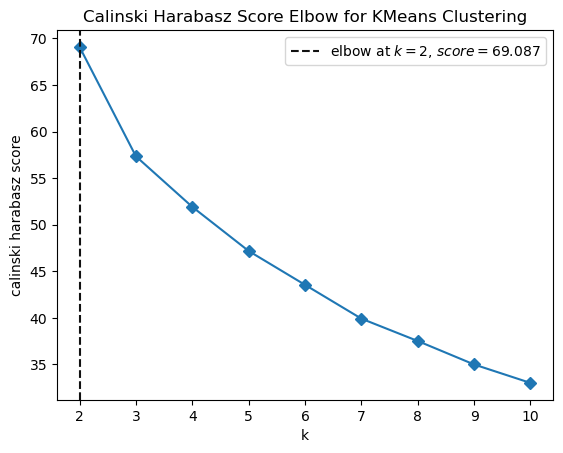

 45%|████▌     | 19/42 [02:52<03:34,  9.32s/it]

HRAS


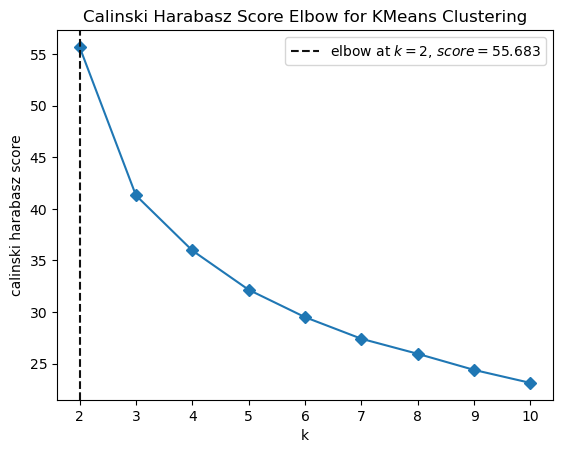

 48%|████▊     | 20/42 [03:00<03:13,  8.82s/it]

IRAK4


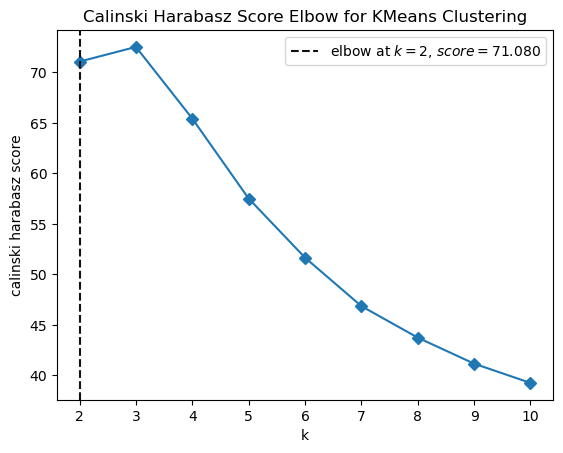

 50%|█████     | 21/42 [03:08<03:03,  8.74s/it]

JUN


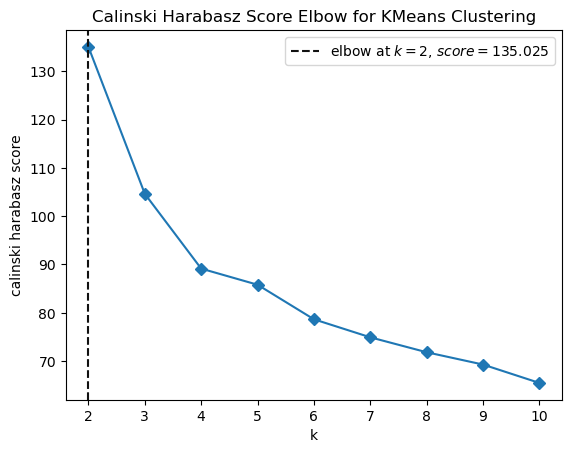

 52%|█████▏    | 22/42 [03:18<03:01,  9.06s/it]

MAP2K3


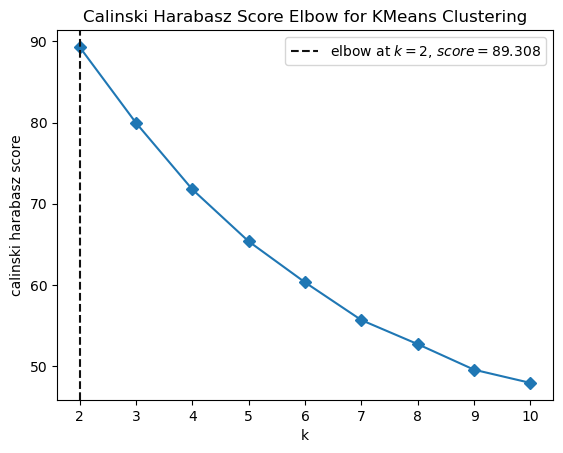

 55%|█████▍    | 23/42 [03:27<02:49,  8.92s/it]

MAP3K2


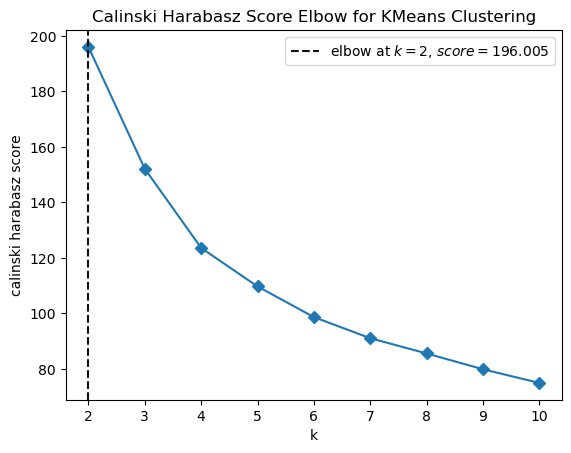

 57%|█████▋    | 24/42 [03:36<02:44,  9.16s/it]

MAP3K5


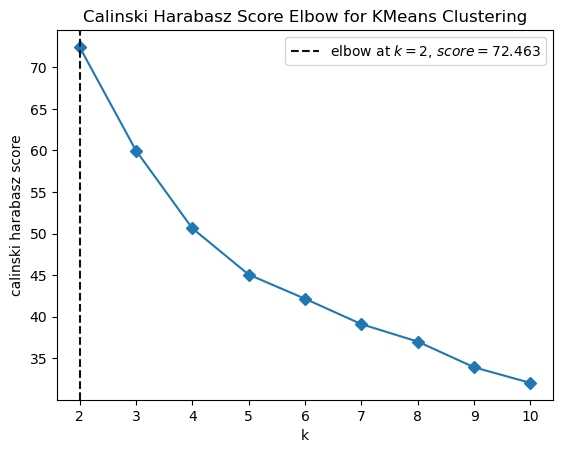

 60%|█████▉    | 25/42 [03:45<02:32,  8.99s/it]

MAP3K9


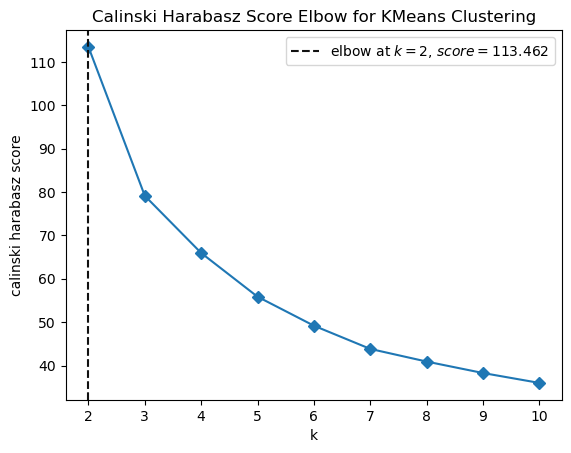

 62%|██████▏   | 26/42 [03:53<02:17,  8.60s/it]

MAPK7


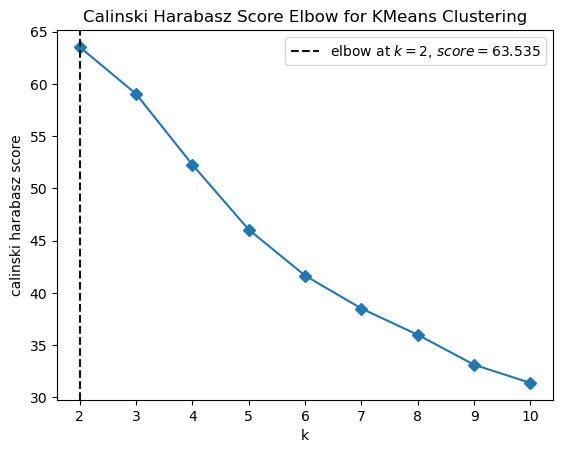

 64%|██████▍   | 27/42 [04:01<02:09,  8.62s/it]

MOS


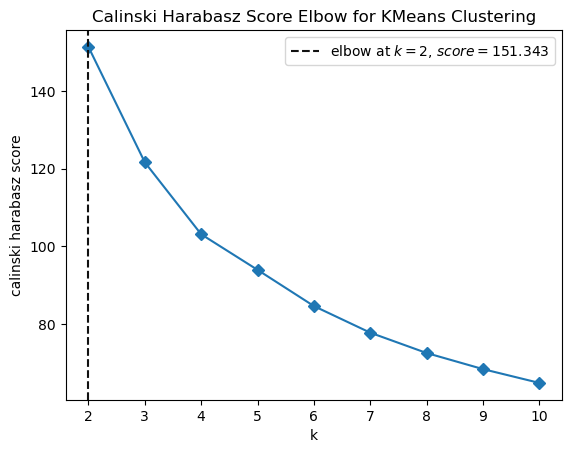

 67%|██████▋   | 28/42 [04:12<02:09,  9.26s/it]

MYD88


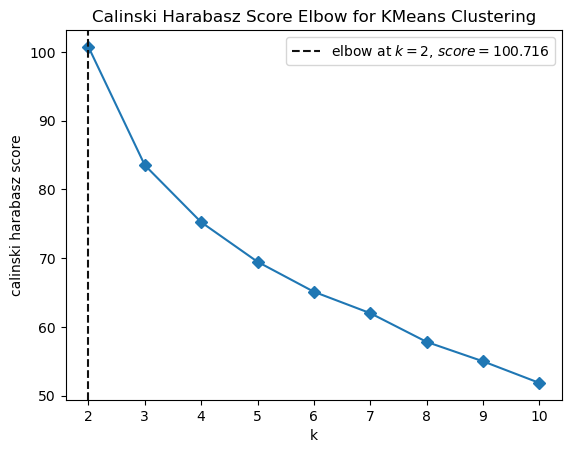

 69%|██████▉   | 29/42 [04:22<02:02,  9.41s/it]

PIK3R2


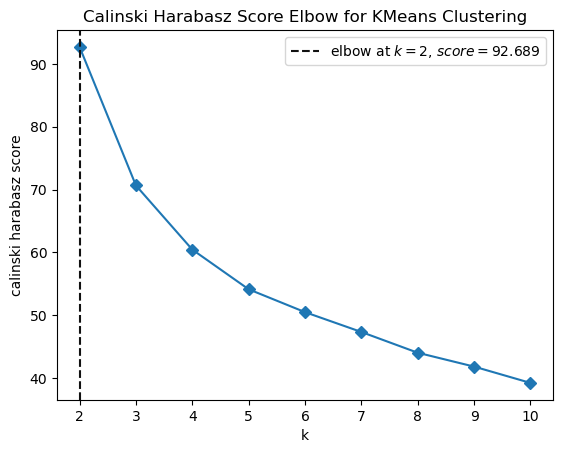

 71%|███████▏  | 30/42 [04:31<01:50,  9.23s/it]

PRKACA


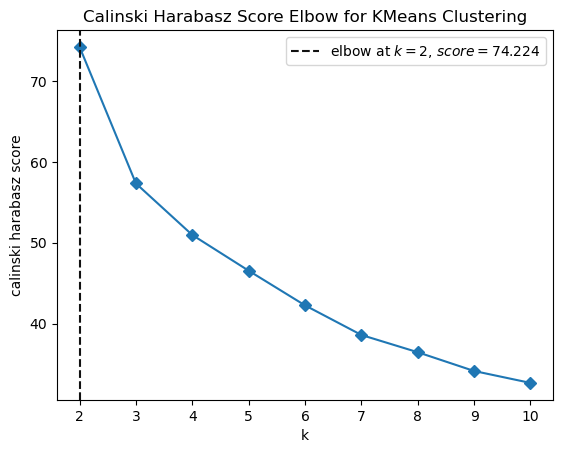

 74%|███████▍  | 31/42 [04:39<01:40,  9.10s/it]

PRKCE


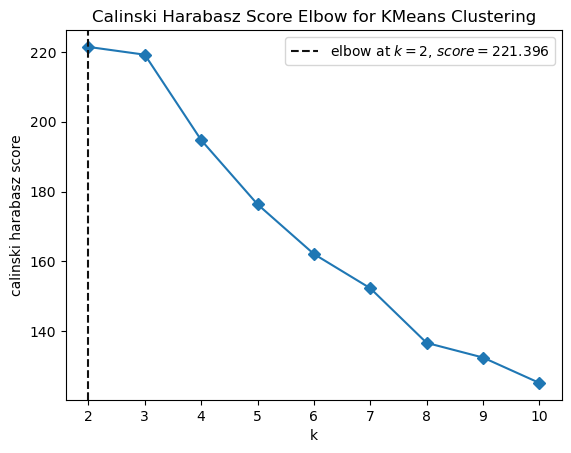

 76%|███████▌  | 32/42 [04:52<01:42, 10.23s/it]

RAF1


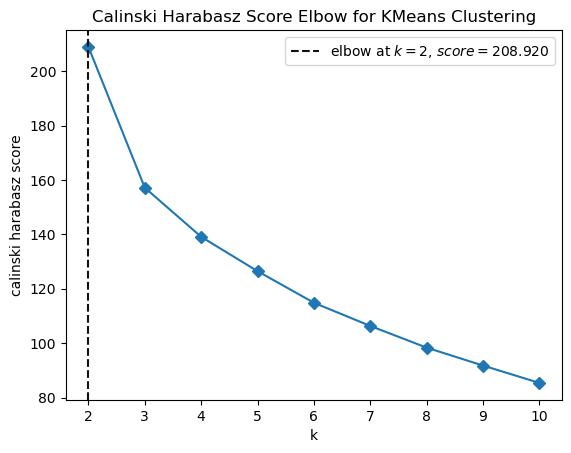

 79%|███████▊  | 33/42 [05:04<01:36, 10.70s/it]

RELB


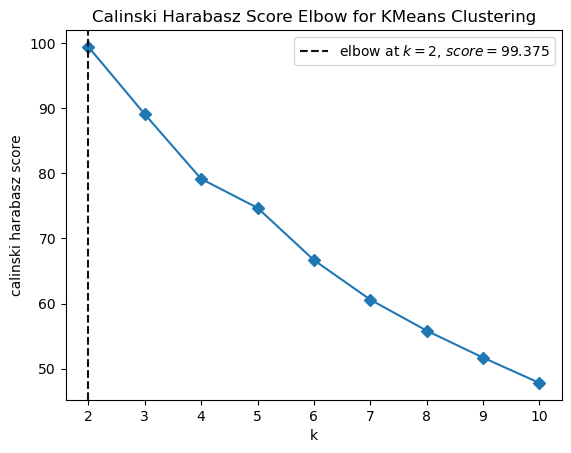

 81%|████████  | 34/42 [05:13<01:21, 10.20s/it]

RHOA


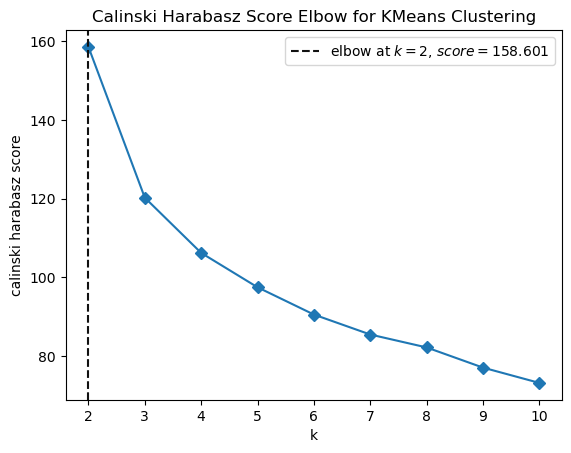

 83%|████████▎ | 35/42 [05:23<01:11, 10.21s/it]

SMAD4


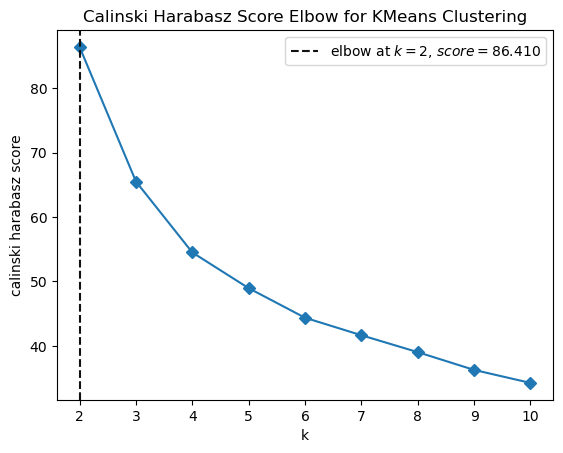

 86%|████████▌ | 36/42 [05:32<00:57,  9.64s/it]

SMO


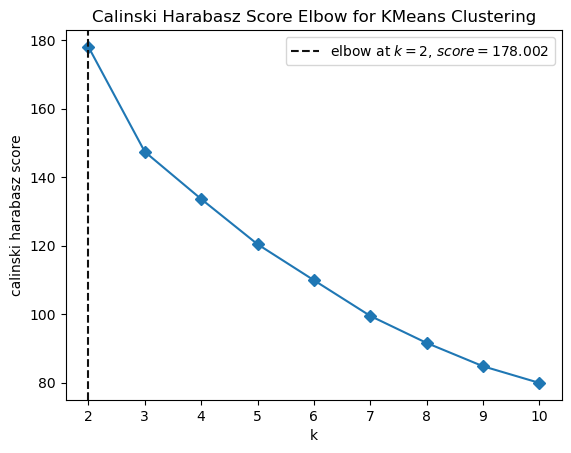

 88%|████████▊ | 37/42 [05:42<00:49,  9.82s/it]

SRC


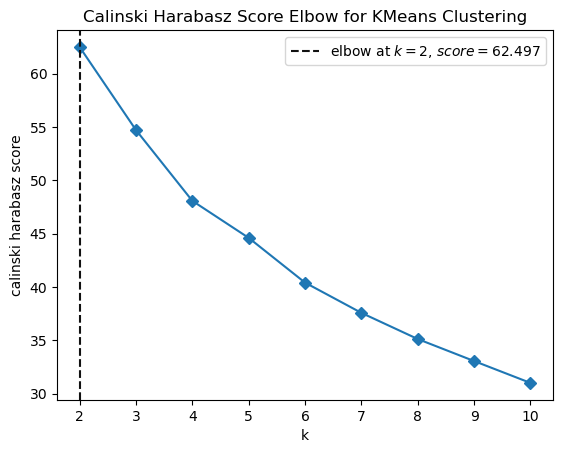

 90%|█████████ | 38/42 [05:50<00:37,  9.43s/it]

SREBF1


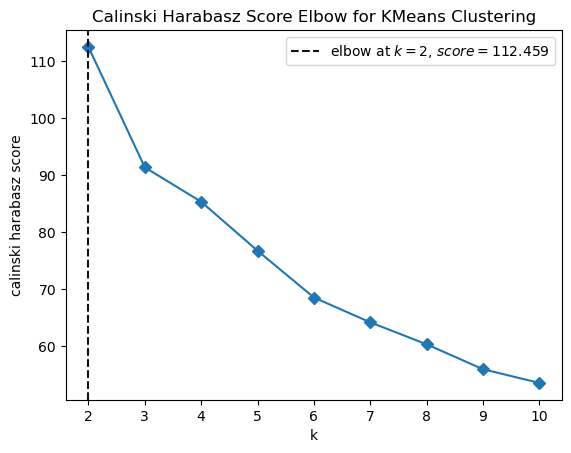

 93%|█████████▎| 39/42 [05:59<00:27,  9.24s/it]

TRAF2


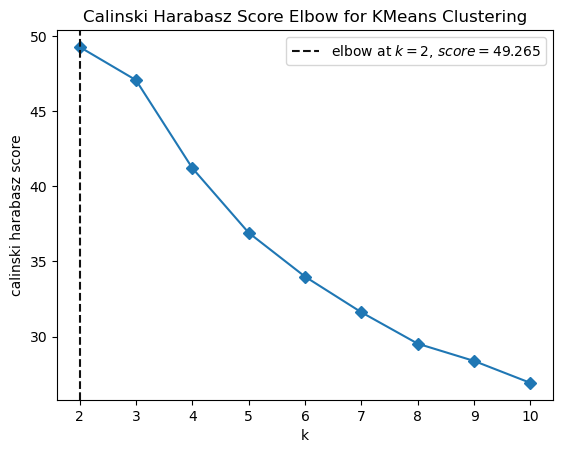

 95%|█████████▌| 40/42 [06:08<00:18,  9.05s/it]

TSC2


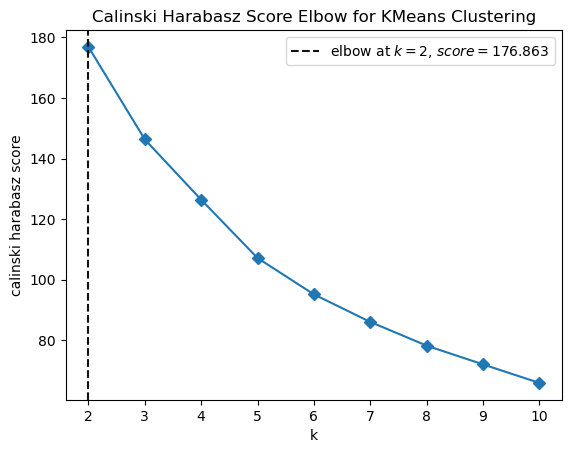

 98%|█████████▊| 41/42 [06:16<00:08,  8.84s/it]

WWTR1


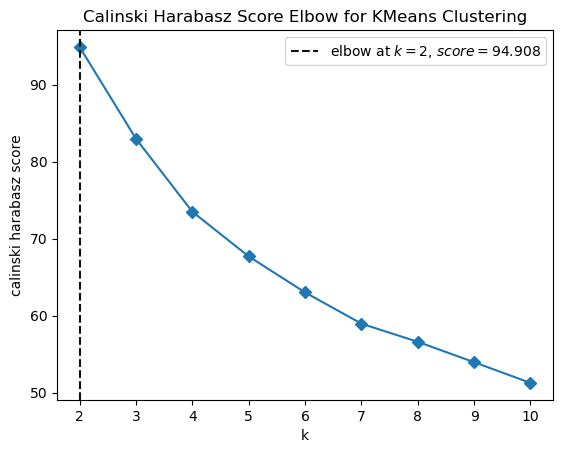

100%|██████████| 42/42 [06:25<00:00,  9.19s/it]


<IPython.core.display.Javascript object>

In [109]:
plot_clustering(fold0_latents, score="calinski_harabasz")

In [110]:
model = KMeans(n_clusters=3)
fold_latents_cl = []
for i in range(4):
    fold_latent = latents.loc[latents.fold == "fold_{}".format(i)]
    fold_latents_cl.append(add_cluster_membership(model, fold_latent, "labels"))

Add cluster memberships: 100%|██████████| 42/42 [00:38<00:00,  1.08it/s]


<IPython.core.display.Javascript object>

In [111]:
fold_latents_cl = pd.concat(fold_latents_cl)

<IPython.core.display.Javascript object>

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


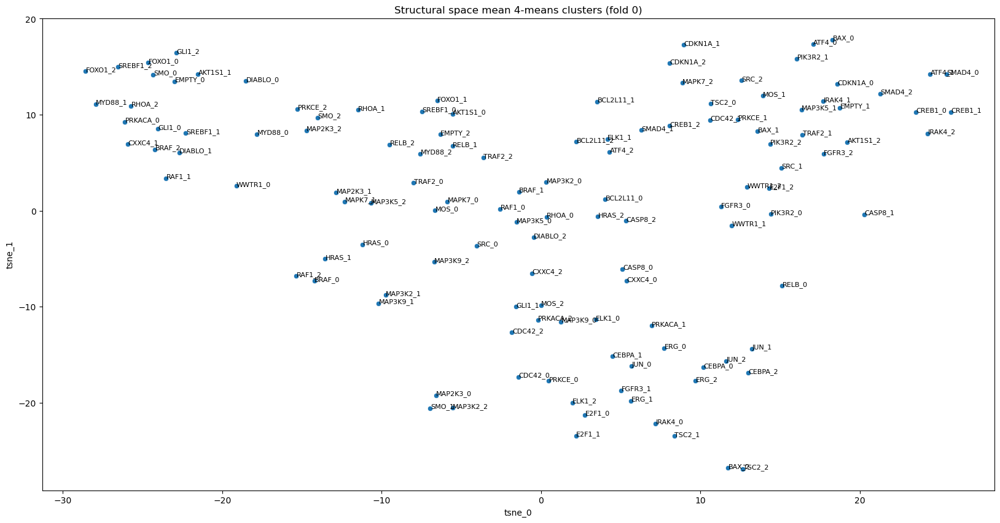

<IPython.core.display.Javascript object>

In [112]:
fold0_latents_cl = fold_latents_cl[fold_latents_cl.fold == "fold_0"]
fold0_latents_cl = fold0_latents_cl.groupby("cluster").mean()
fig, ax = plt.subplots(figsize=[20, 10])
ax = plot_tsne_embs(fold0_latents_cl, ax=ax, perplexity=10, size=8)
ax.set_title("Structural space mean 4-means clusters (fold 0)")
plt.show()

After having computed these cluster solutions, we save the corresponding embeddings alongside with the cluster labels to disk for further analysis.

In [113]:
fold_latents_cl.to_hdf(
    "../../../data/experiments/image_embeddings/specificity_target_emb_cv_strat/final_1024/all_test_latents_k3.h5",
    key="data",
)

<IPython.core.display.Javascript object>

---



### 3.3 Co-clustering of structural and regulatory spaces.

As shown above while the co-clustering is clearly not random as expected there are some difference of which regulators co-cluster depending on which held-out data set we assess.

We are interested in understanding how those different embeddings co-cluster with the regulatory space that we inferred from scRNA-seq and interactome data. To this end, we load the respective data and once more assess the co-clustering of the different structural embeddings corresponding to the four different held-out fold data sets and the regulatory network embeddings.

We have previously identified two regulatory embeddings one using the lower dimensional embedding of 128 latent dimensions and the other is spanned by 1024 dimensions. We will consider both when assessing the co-clustering of the individual structural space estimates corresponding to the different folds of our cross-validation-based evaluation.

In [72]:
node_embs_128 = pd.read_csv(
    "../../../data/ppi/embedding/node_embeddings_cv.csv", index_col=0
)
node_embs_1024 = pd.read_csv(
    "../../../data/ppi/embedding/node_embeddings_cv_1024.csv", index_col=0
)
shared_nodes = set(node_embs_128.index).intersection(fold_latents[0].index)

<IPython.core.display.Javascript object>

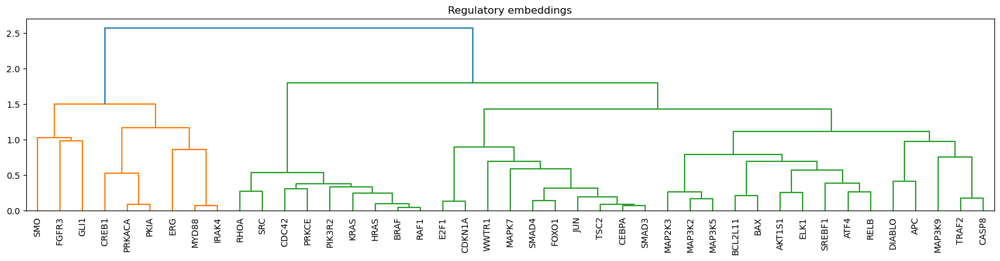

<IPython.core.display.Javascript object>

In [79]:
plot_clustertree(
    node_embs_1024.loc[shared_nodes],
    title="Regulatory embeddings",
    method="ward",
    metric="cosine",
)

We will compute the co-clustering performance as measured by the mutual information and adjusted mutual information for each fold as well a corresponding background distribution established via permuting the cluster labels for both the network and structural embeddings randomly 100 times. This will be used as a Monte-Carlo approximation of the null hypothesis were the cluster assignments given a fixed number of clusters and cluster frequency in each space are completely independent as described in [Frank & Witten (1998)](https://researchcommons.waikato.ac.nz/handle/10289/1506).

##### Mutual information

In [46]:
mi_test_results = get_perm_test_results(
    fold_latents, node_embs_128, shared_nodes, score="mi"
)

100%|██████████| 200/200 [00:48<00:00,  4.14it/s]


<IPython.core.display.Javascript object>

The figures below show the co-clustering as assessed by the MC p-values for each fold individually.

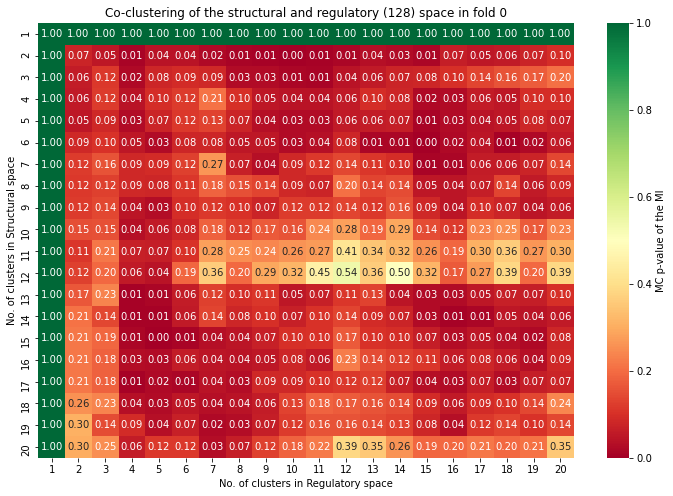

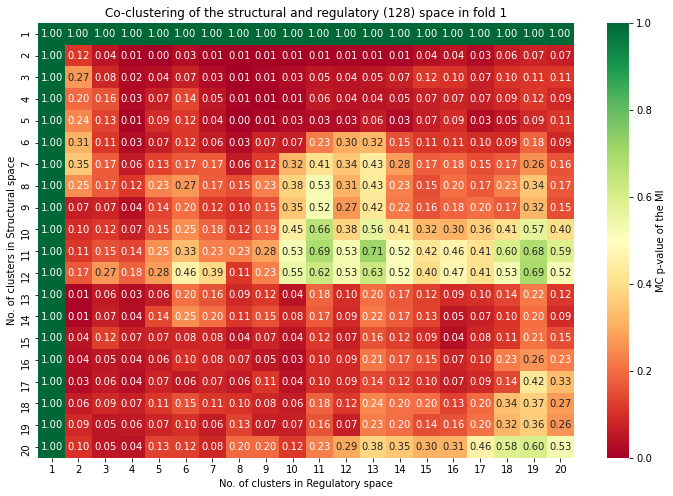

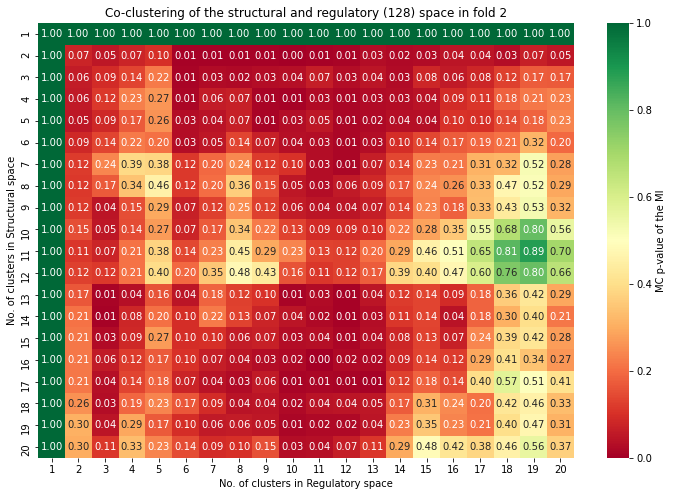

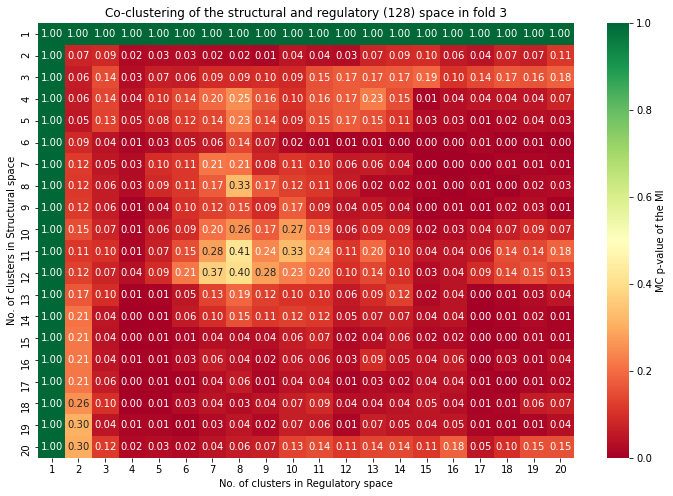

<IPython.core.display.Javascript object>

In [47]:
for i in range(len(mi_test_results["pval"])):
    plot_cc_score(
        mi_test_results["pval"][i],
        "Co-clustering of the structural and regulatory (128) space in fold {}".format(
            i
        ),
        "MC p-value of the MI",
        space_names=["Regulatory space", "Structural space"],
        figsize=[12, 8],
    )

We see that there is quite some variation of the p-values for the co-clustering suggesting a significant dependence of the clustering of the imaging space dependent on which data was held-out for validation. Nonetheless, we also observe a large number of significant p-values for different co-clustering solutions. Note, that those p values are not corrected for multiple testing.

##### Adjusted Mutual Information

In [48]:
ami_test_results = get_perm_test_results(
    fold_latents, node_embs_128, shared_nodes, score="ami"
)

100%|██████████| 200/200 [01:43<00:00,  1.93it/s]


<IPython.core.display.Javascript object>

We observe a fairly similar picture when using the adjusted mutual information, which is not surprising as the AMI is simply a transformed version of the MI adjusted for chance. To jointly summarize the strength of the co-clustering in the different folds, we look at the average adjusted mutual information for varying numbers of clusters across the four different held-out data sets.

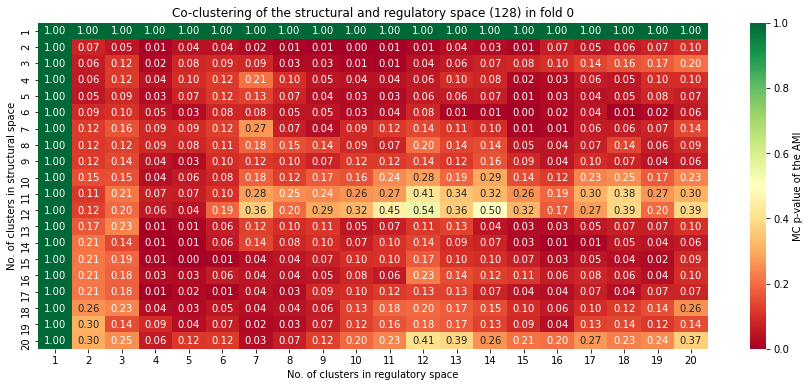

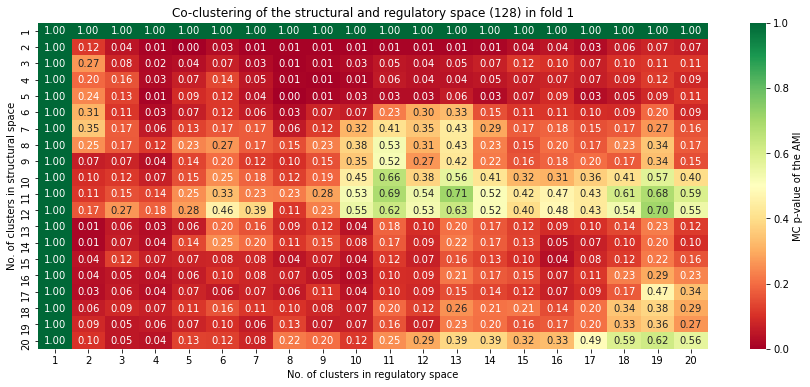

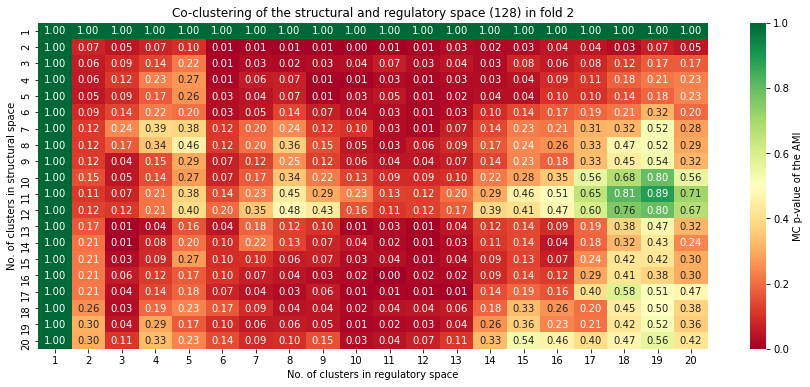

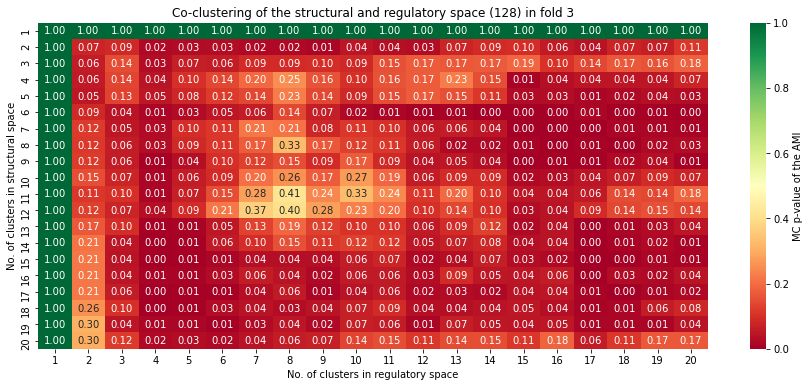

<IPython.core.display.Javascript object>

In [49]:
for i in range(len(ami_test_results["pval"])):
    plot_cc_score(
        ami_test_results["pval"][i],
        "Co-clustering of the structural and regulatory space (128) in fold {}".format(
            i
        ),
        "MC p-value of the AMI",
        space_names=["regulatory space", "structural space"],
    )

Note that the p-values define the approximate probability of the (adjusted) MI to be at least as large as in the observed co-clustering structure given the number of clusters and their relative frequencies. In practice this conditioning might be too strong for our use case as while the number of clusters differ an agreement in the relative cluster frequencies provide some information about the structure of the latent space that might or might not be present and thus is rather a characteristic that should be varied by chance as well.


---